# EVA-4 : Assignment 15 - Final

New
- Normalization
- Double depth loss

Previous

- Reduced no of channels
- Reduced layers

### Summary
- Create dataset 
  - Only background (bg)
  - Background + Foreground (bg_fg)
  - Foreground Mask (fg_mask)
- Load Dataset
- Display sample images 
- Create Network
- Train Model
- Display Images


In [2]:
import torch
from IPython.display import Image, clear_output 

print('PyTorch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

PyTorch 1.5.0+cu101 _CudaDeviceProperties(name='Tesla P4', major=6, minor=1, total_memory=7611MB, multi_processor_count=20)


### Mount google drive

In [3]:
# Load data from Google drive
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


### Install libraries

##### Dataset
- albumentation: Data Augmentation

##### Helper
- autotime : Prints cell execution time
- torchsummary : Prints model summary

In [4]:
!pip install -U git+https://github.com/albu/albumentations --no-cache-dir

  Cloning https://github.com/albu/albumentations to /tmp/pip-req-build-pth3hpw9
  Running command git clone -q https://github.com/albu/albumentations /tmp/pip-req-build-pth3hpw9
     |████████████████████████████████| 634kB 9.5MB/s 
  Created wheel for albumentations: filename=albumentations-0.4.5-cp36-none-any.whl size=65038 sha256=ccb66227cf4a18a46d31a340706dbe5384243ef6cccda15b92e5f5471135b0a2
  Stored in directory: /tmp/pip-ephem-wheel-cache-t8bhwc0w/wheels/45/8b/e4/2837bbcf517d00732b8e394f8646f22b8723ac00993230188b
  Created wheel for imgaug: filename=imgaug-0.2.6-cp36-none-any.whl size=654020 sha256=d79ae617a31f3ff90339a34a587a039ee3318b388a8c5e4557be0b1d58c7949d
  Stored in directory: /tmp/pip-ephem-wheel-cache-t8bhwc0w/wheels/97/ec/48/0d25896c417b715af6236dbcef8f0bed136a1a5e52972fc6d0
Successfully built albumentations imgaug
  Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9
  Found existing installation: album

In [5]:
# Library to print cell execution time
!pip install ipython-autotime
%load_ext autotime

  Created wheel for ipython-autotime: filename=ipython_autotime-0.1-cp36-none-any.whl size=1832 sha256=1eca87b4e5acf7d4ffc35e518f1a35ca51da4a8c9ac5fea8a85ac2aabfeb9e51
  Stored in directory: /root/.cache/pip/wheels/d2/df/81/2db1e54bc91002cec40334629bc39cfa86dff540b304ebcd6e
Successfully built ipython-autotime


### Import all modules and libraries

In [6]:
# System
import os
import sys

# Scikit
import numpy as np

# Plotting
import matplotlib.pyplot as plt

# Pytorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from torchsummary import summary

# Image Proessing
from PIL import Image

time: 255 ms


### Set the directory path of google drive

In [7]:
BASE_COLAB_PATH = '/content/drive/My Drive/eva-4/assignment-15/assignemnt-15-final' 

sys.path.append(BASE_COLAB_PATH)
sys.path.append(BASE_COLAB_PATH + '/models')
sys.path.append(BASE_COLAB_PATH + '/saved_models')

time: 2.9 ms


In [8]:
cd '/content/drive/My Drive/eva-4/assignment-15/assignment-15-final'

/content/drive/My Drive/eva-4/assignment-15/assignment-15-final
time: 462 ms


### Set Device

In [9]:
use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")
print(device)

cuda
time: 2.68 ms


### Import all the functions

In [10]:
#import custommodel
from models import custommodel
from functions import transformations, loaddataset, show, train, train_test_model, loadcheckpoint, plotmetrics
from dataset import ImageDataset

time: 4.33 s


### Hyperparameters



In [11]:
# Define hyper paramteres and constants
START_EPOCH=1
EPOCHS=20
BATCH_SIZE=16
LEARNING_RATE=0.01

IMAGE_WIDTH=224
IMAGE_HEIGHT=224
INPUT_CHANNELS=3

BATCH_1_ZIP = 'batch_1.zip'
BATCH_2_ZIP = 'batch_2.zip'
BATCH_3_ZIP = 'batch_3.zip'
BATCH_4_ZIP = 'batch_4.zip'
BATCH_5_ZIP = 'batch_5.zip'
BATCH_6_ZIP = 'batch_6.zip'
BATCH_7_ZIP = 'batch_7.zip'
BATCH_8_ZIP = 'batch_8.zip'
BATCH_9_ZIP = 'batch_9.zip'
BATCH_10_ZIP = 'batch_10.zip'
BATCH_11_ZIP = 'batch_11.zip'
BATCH_12_ZIP = 'batch_12.zip'
BATCH_13_ZIP = 'batch_13.zip'
BATCH_14_ZIP = 'batch_14.zip'
BATCH_15_ZIP = 'batch_15.zip'
BATCH_16_ZIP = 'batch_16.zip'
BATCH_17_ZIP = 'batch_17.zip'
BATCH_18_ZIP = 'batch_18.zip'
BATCH_19_ZIP = 'batch_19.zip'
BATCH_20_ZIP = 'batch_20.zip'

DATASET_ROOT='/content/drive/My Drive/eva-4/assignment-15/asssignment-15-A/s_ds/extracted_partial/64x64'
ZIP_FILES_PATH='/content/drive/My Drive/eva-4/assignment-15/assignment-15-final/ds/zipfiles/'
MODEL_SAVE_PATH='/content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models'
BEST_MODEL_PATH='/content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth'
METRICS_PATH='/content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/metrics.png'

time: 15.2 ms


### Load Transformations

In [12]:
transformtrain, transform_test = transformations()

time: 855 µs


### Load Dataset

In [13]:
batch_1_zipfilepath = ZIP_FILES_PATH + BATCH_1_ZIP
trainloader, testloader = loaddataset(batch_1_zipfilepath, transformtrain, batch_size=BATCH_SIZE)

30001
time: 2.06 s


### Display sample images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([16, 3, 224, 224])
torch.Size([16, 1, 224, 224])
torch.Size([16, 3, 224, 224])


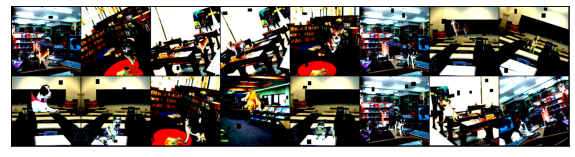

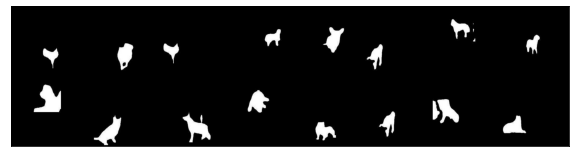

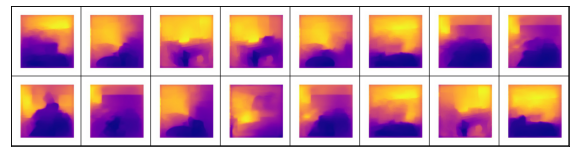

time: 813 ms


In [13]:
sampleTrain = next(iter(trainloader))
trainimages = sampleTrain['bg_fg']
trainmasks = sampleTrain['mask']
traindepths = sampleTrain['depth']
print(trainimages.shape)
print(trainmasks.shape)
print(traindepths.shape)
show(trainimages)
show(trainmasks)
show(traindepths)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([16, 3, 224, 224])
torch.Size([16, 1, 224, 224])
torch.Size([16, 3, 224, 224])


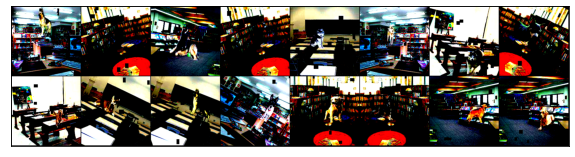

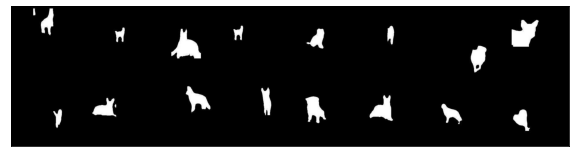

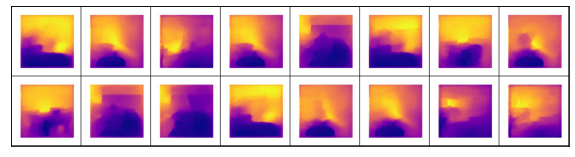

time: 786 ms


In [14]:
sampleTest = next(iter(testloader))
testimages = sampleTest['bg_fg']
testmasks = sampleTest['mask']
testdepths = sampleTest['depth']
print(testimages.shape)
print(testmasks.shape)
print(testdepths.shape)
show(testimages)
show(testmasks)
show(testdepths)

### Load Model

In [13]:
print("Building Model")
net = custommodel.CustomNet(in_shape=(INPUT_CHANNELS, IMAGE_WIDTH, IMAGE_HEIGHT))

Building Model
time: 70.3 ms


In [14]:
model = net.to(device)
summary(model, input_size=(INPUT_CHANNELS, IMAGE_WIDTH, IMAGE_HEIGHT))

/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 224, 224]             864
       BatchNorm2d-2         [-1, 32, 224, 224]              64
              ReLU-3         [-1, 32, 224, 224]               0
      ConvBnRelu2d-4         [-1, 32, 224, 224]               0
            Conv2d-5         [-1, 32, 224, 224]           9,216
       BatchNorm2d-6         [-1, 32, 224, 224]              64
              ReLU-7         [-1, 32, 224, 224]               0
      ConvBnRelu2d-8         [-1, 32, 224, 224]               0
           Encoder-9  [[-1, 32, 224, 224], [-1, 32, 112, 112]]               0
           Conv2d-10         [-1, 64, 112, 112]          18,432
      BatchNorm2d-11         [-1, 64, 112, 112]             128
             ReLU-12         [-1, 64, 112, 112]               0
     ConvBnRelu2d-13         [-1, 64, 112, 112]               0
           Conv2d-14    

### Define loss function and optimizer


In [15]:
criterion = nn.BCEWithLogitsLoss()
optimizer = torch.optim.SGD(model.parameters(),lr= LEARNING_RATE, momentum=0.9, weight_decay=1e-5, nesterov=True)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2)

time: 3.16 ms


### Train/Test Model

##### Training-1

>>>>>>>> 
Epoch 1/40, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 1.426658, dice: 1.326649, loss: 1.426658


Train - Actual mask


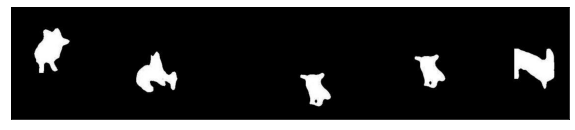

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


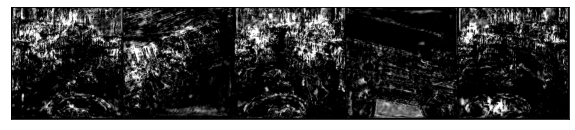



Train - Actual Depth


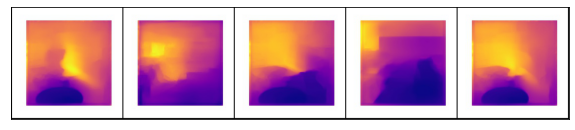

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


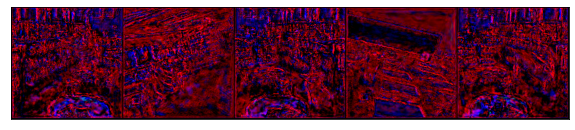

Best val loss: 1.426658
train: bce: 0.773664, dice: 1.174729, loss: 0.773664
train: bce: 0.644915, dice: 1.116076, loss: 0.644915
train: bce: 0.592250, dice: 1.085816, loss: 0.592250
train: bce: 0.563578, dice: 1.062485, loss: 0.563578
train: bce: 0.544390, dice: 1.041371, loss: 0.544390
train: bce: 0.530035, dice: 1.023417, loss: 0.530035
train: bce: 0.519457, dice: 1.007262, loss: 0.519457
train: bce: 0.510803, dice: 0.994334, loss: 0.510803
test: bce: 0.428443, dice: 0.767340, loss: 0.428443


Test - Actual mask: 1


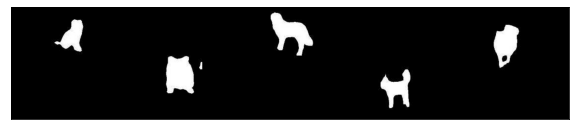

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


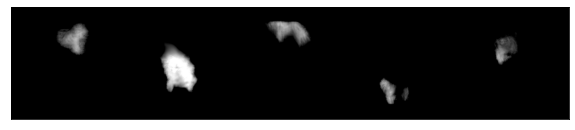



Test - Actual Depth


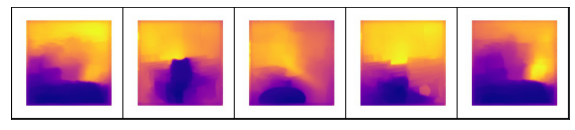

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


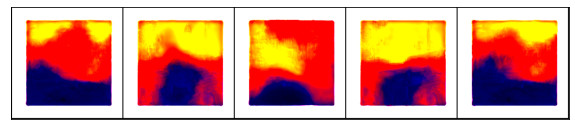

test: bce: 0.458125, dice: 0.862507, loss: 0.458125
test: bce: 0.458707, dice: 0.864097, loss: 0.458707
test: bce: 0.458647, dice: 0.863854, loss: 0.458647
************* 
Epoch: 1 	Training Loss: 0.505097 	Validation Loss: 0.458240

Validation loss decreased (100000.000000 --> 0.458240).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 2/40, LR: 0.01
train: bce: 0.447619, dice: 0.833286, loss: 0.447619
train: bce: 0.440534, dice: 0.854384, loss: 0.440534
train: bce: 0.439287, dice: 0.847852, loss: 0.439287
train: bce: 0.437289, dice: 0.845502, loss: 0.437289
train: bce: 0.435797, dice: 0.839671, loss: 0.435797
train: bce: 0.434670, dice: 0.830116, loss: 0.434670
train: bce: 0.433310, dice: 0.820131, loss: 0.433310
train: bce: 0.431815, dice: 0.813974, loss: 0.431815
train: bce: 0.429819, dice: 0.806256, loss: 0.429819
test: bce: 0.413290, dice: 0.811183, loss: 0.413290
test: bce: 0.417419, di

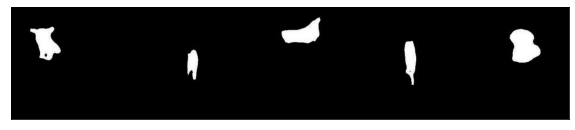

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


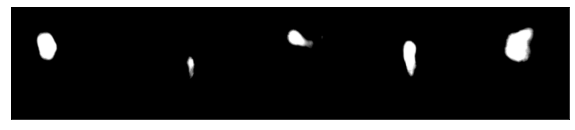



Train - Actual Depth


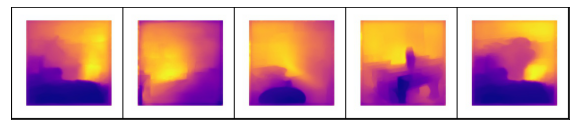

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


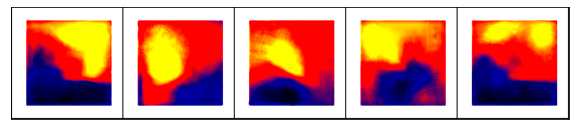

Best val loss: 0.376074
train: bce: 0.397908, dice: 0.672054, loss: 0.397908
train: bce: 0.396737, dice: 0.670290, loss: 0.396737
train: bce: 0.396315, dice: 0.668465, loss: 0.396315
train: bce: 0.394330, dice: 0.661497, loss: 0.394330
train: bce: 0.393991, dice: 0.659265, loss: 0.393991
train: bce: 0.392844, dice: 0.654774, loss: 0.392844
train: bce: 0.392539, dice: 0.652933, loss: 0.392539
train: bce: 0.392223, dice: 0.651565, loss: 0.392223
test: bce: 0.375109, dice: 0.596682, loss: 0.375109


Test - Actual mask: 4


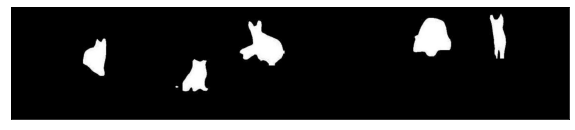

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


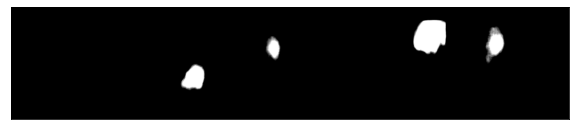



Test - Actual Depth


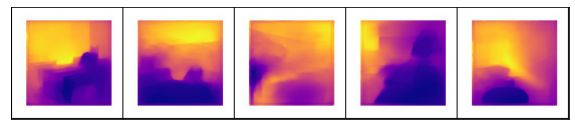

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


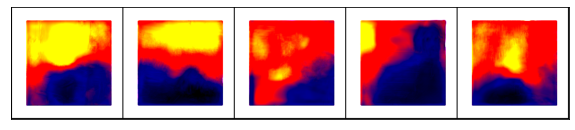

test: bce: 0.392967, dice: 0.649380, loss: 0.392967
test: bce: 0.392457, dice: 0.645444, loss: 0.392457
test: bce: 0.392230, dice: 0.642689, loss: 0.392230
************* 
Epoch: 4 	Training Loss: 0.376074 	Validation Loss: 0.391825

Validation loss decreased (0.402283 --> 0.391825).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 5/40, LR: 0.01
train: bce: 0.386308, dice: 0.643933, loss: 0.386308
train: bce: 0.387169, dice: 0.628062, loss: 0.387169
train: bce: 0.385435, dice: 0.624072, loss: 0.385435
train: bce: 0.385421, dice: 0.623901, loss: 0.385421
train: bce: 0.384034, dice: 0.618795, loss: 0.384034
train: bce: 0.383517, dice: 0.616422, loss: 0.383517
train: bce: 0.383928, dice: 0.615668, loss: 0.383928
train: bce: 0.383819, dice: 0.613715, loss: 0.383819
train: bce: 0.383083, dice: 0.611808, loss: 0.383083
test: bce: 0.369591, dice: 0.531333, loss: 0.369591
test: bce: 0.379852, dice: 0

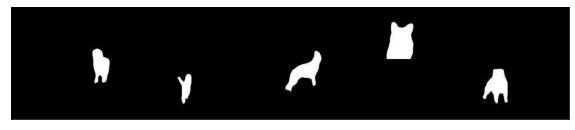

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


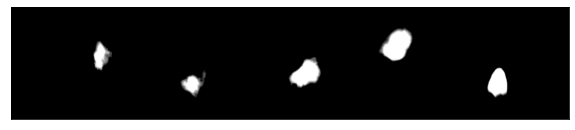



Train - Actual Depth


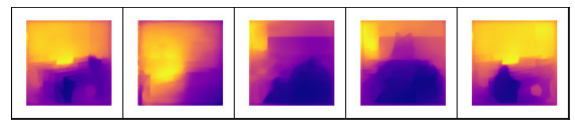

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


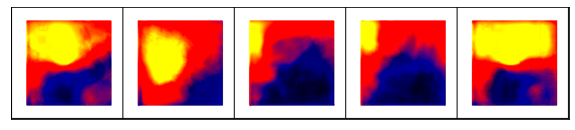

Best val loss: 0.357202
train: bce: 0.367850, dice: 0.532963, loss: 0.367850
train: bce: 0.368089, dice: 0.539066, loss: 0.368089
train: bce: 0.367771, dice: 0.543296, loss: 0.367771
train: bce: 0.367340, dice: 0.542741, loss: 0.367340
train: bce: 0.367927, dice: 0.541527, loss: 0.367927
train: bce: 0.368016, dice: 0.542223, loss: 0.368016
train: bce: 0.367885, dice: 0.541823, loss: 0.367885
train: bce: 0.368108, dice: 0.542694, loss: 0.368108
test: bce: 0.350491, dice: 0.499064, loss: 0.350491


Test - Actual mask: 8


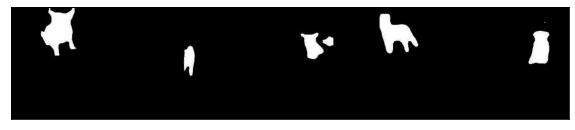

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


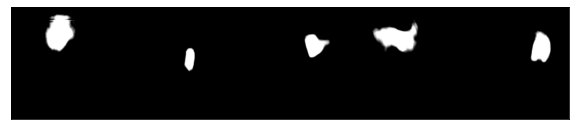



Test - Actual Depth


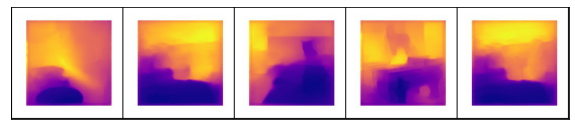

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


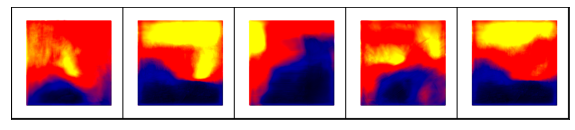

test: bce: 0.366660, dice: 0.530436, loss: 0.366660
test: bce: 0.368514, dice: 0.538107, loss: 0.368514
test: bce: 0.368742, dice: 0.538218, loss: 0.368742
************* 
Epoch: 8 	Training Loss: 0.357202 	Validation Loss: 0.369973

Validation loss decreased (0.371222 --> 0.369973).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 9/40, LR: 0.01
train: bce: 0.365988, dice: 0.535685, loss: 0.365988
train: bce: 0.361522, dice: 0.517600, loss: 0.361522
train: bce: 0.363292, dice: 0.523329, loss: 0.363292
train: bce: 0.363516, dice: 0.527847, loss: 0.363516
train: bce: 0.364101, dice: 0.527979, loss: 0.364101
train: bce: 0.364552, dice: 0.528785, loss: 0.364552
train: bce: 0.364536, dice: 0.527780, loss: 0.364536
train: bce: 0.364478, dice: 0.525933, loss: 0.364478
train: bce: 0.364803, dice: 0.526444, loss: 0.364803
test: bce: 0.339340, dice: 0.479494, loss: 0.339340
test: bce: 0.361918, dice: 0

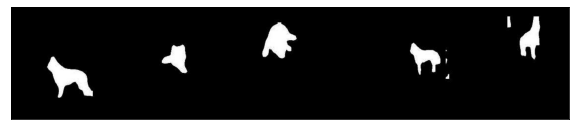

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


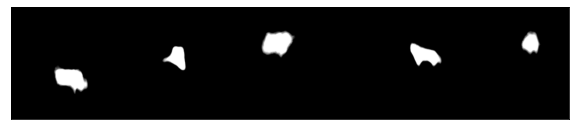



Train - Actual Depth


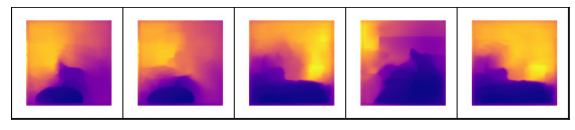

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


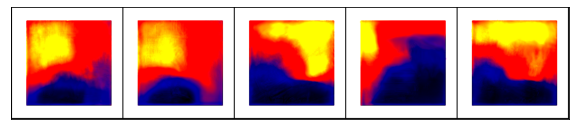

Best val loss: 0.350755
train: bce: 0.358821, dice: 0.486192, loss: 0.358821
train: bce: 0.357004, dice: 0.489604, loss: 0.357004
train: bce: 0.357604, dice: 0.491848, loss: 0.357604
train: bce: 0.357817, dice: 0.491970, loss: 0.357817
train: bce: 0.357881, dice: 0.491578, loss: 0.357881
train: bce: 0.357751, dice: 0.491380, loss: 0.357751
train: bce: 0.357887, dice: 0.491416, loss: 0.357887
train: bce: 0.357734, dice: 0.491240, loss: 0.357734
test: bce: 0.355935, dice: 0.497370, loss: 0.355935


Test - Actual mask: 12


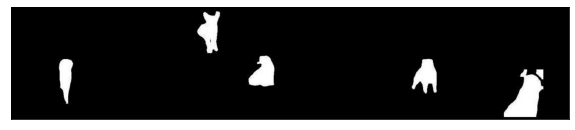

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


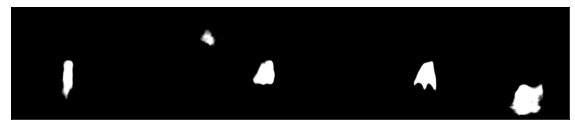



Test - Actual Depth


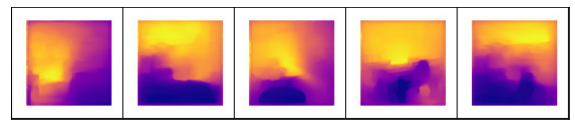

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


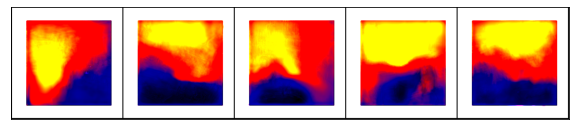

test: bce: 0.360777, dice: 0.512300, loss: 0.360777
test: bce: 0.361746, dice: 0.510360, loss: 0.361746
test: bce: 0.360828, dice: 0.507296, loss: 0.360828
************* 
Epoch: 12 	Training Loss: 0.345477 	Validation Loss: 0.361297

>>>>>>>> 
Epoch 13/40, LR: 0.01
train: bce: 0.346682, dice: 0.442948, loss: 0.346682
train: bce: 0.355256, dice: 0.474819, loss: 0.355256
train: bce: 0.355242, dice: 0.479870, loss: 0.355242
train: bce: 0.356027, dice: 0.485066, loss: 0.356027
train: bce: 0.356747, dice: 0.486800, loss: 0.356747
train: bce: 0.355977, dice: 0.485638, loss: 0.355977
train: bce: 0.356086, dice: 0.485498, loss: 0.356086
train: bce: 0.355677, dice: 0.484856, loss: 0.355677
train: bce: 0.355423, dice: 0.484120, loss: 0.355423
test: bce: 0.352712, dice: 0.460988, loss: 0.352712
test: bce: 0.353449, dice: 0.477399, loss: 0.353449
test: bce: 0.355972, dice: 0.485644, loss: 0.355972
test: bce: 0.356011, dice: 0.485579, loss: 0.356011
************* 
Epoch: 13 	Training Loss: 0.341682

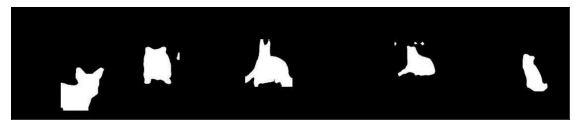

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


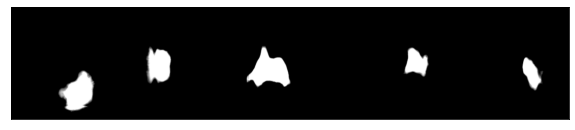



Train - Actual Depth


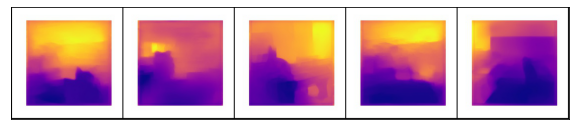

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


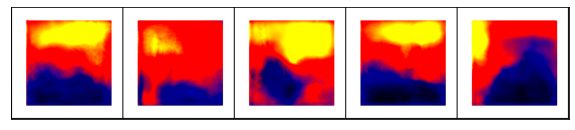

Best val loss: 0.338717
train: bce: 0.355435, dice: 0.467151, loss: 0.355435
train: bce: 0.353559, dice: 0.462406, loss: 0.353559
train: bce: 0.352678, dice: 0.461985, loss: 0.352678
train: bce: 0.351706, dice: 0.461546, loss: 0.351706
train: bce: 0.351483, dice: 0.461633, loss: 0.351483
train: bce: 0.351620, dice: 0.462121, loss: 0.351620
train: bce: 0.351557, dice: 0.462842, loss: 0.351557
train: bce: 0.351633, dice: 0.463252, loss: 0.351633
test: bce: 0.346081, dice: 0.485385, loss: 0.346081


Test - Actual mask: 16


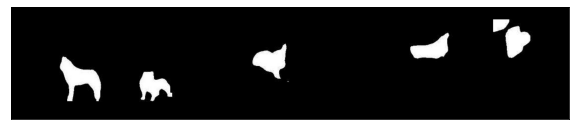

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


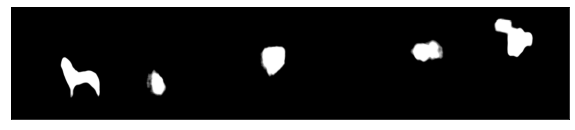



Test - Actual Depth


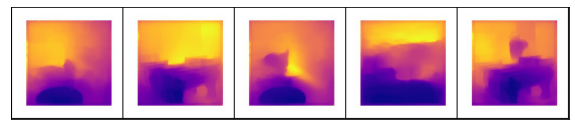

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


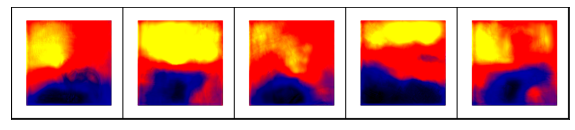

test: bce: 0.354912, dice: 0.467312, loss: 0.354912
test: bce: 0.354299, dice: 0.469621, loss: 0.354299
test: bce: 0.353703, dice: 0.469053, loss: 0.353703
************* 
Epoch: 16 	Training Loss: 0.338717 	Validation Loss: 0.353719

Validation loss decreased (0.353831 --> 0.353719).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 17/40, LR: 0.01
train: bce: 0.346029, dice: 0.442918, loss: 0.346029
train: bce: 0.349859, dice: 0.457273, loss: 0.349859
train: bce: 0.350305, dice: 0.455660, loss: 0.350305
train: bce: 0.350484, dice: 0.458533, loss: 0.350484
train: bce: 0.350409, dice: 0.459936, loss: 0.350409
train: bce: 0.350975, dice: 0.459082, loss: 0.350975
train: bce: 0.350961, dice: 0.459261, loss: 0.350961
train: bce: 0.351111, dice: 0.459723, loss: 0.351111
train: bce: 0.351121, dice: 0.459706, loss: 0.351121
test: bce: 0.333121, dice: 0.437368, loss: 0.333121
test: bce: 0.352261, dice:

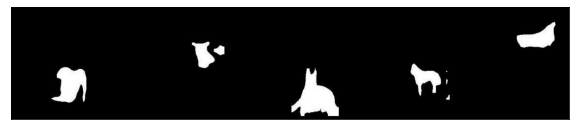

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


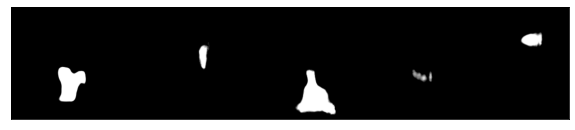



Train - Actual Depth


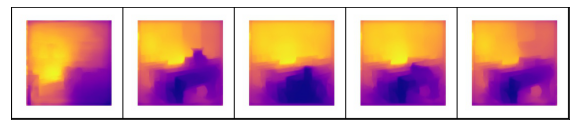

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


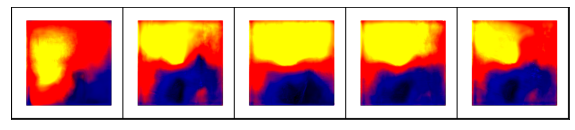

Best val loss: 0.354338
train: bce: 0.347442, dice: 0.448159, loss: 0.347442
train: bce: 0.347523, dice: 0.447047, loss: 0.347523
train: bce: 0.347195, dice: 0.445043, loss: 0.347195
train: bce: 0.347049, dice: 0.441785, loss: 0.347049
train: bce: 0.347099, dice: 0.441857, loss: 0.347099
train: bce: 0.347635, dice: 0.442354, loss: 0.347635
train: bce: 0.347815, dice: 0.442425, loss: 0.347815
train: bce: 0.347705, dice: 0.442533, loss: 0.347705
test: bce: 0.381271, dice: 0.460033, loss: 0.381271


Test - Actual mask: 20


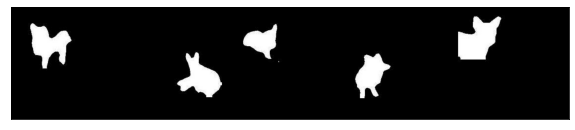

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


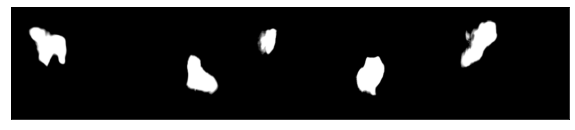



Test - Actual Depth


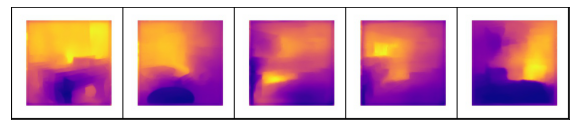

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


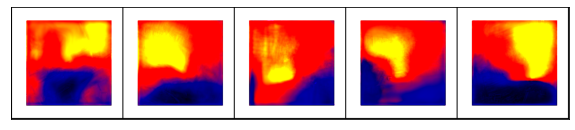

test: bce: 0.348379, dice: 0.440798, loss: 0.348379
test: bce: 0.348068, dice: 0.439973, loss: 0.348068
test: bce: 0.348749, dice: 0.443628, loss: 0.348749
************* 
Epoch: 20 	Training Loss: 0.344620 	Validation Loss: 0.348415

Validation loss decreased (0.348704 --> 0.348415).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 21/40, LR: 0.01
train: bce: 0.358873, dice: 0.453462, loss: 0.358873
train: bce: 0.347739, dice: 0.431386, loss: 0.347739
train: bce: 0.347728, dice: 0.438090, loss: 0.347728
train: bce: 0.347181, dice: 0.438223, loss: 0.347181
train: bce: 0.347091, dice: 0.439038, loss: 0.347091
train: bce: 0.346991, dice: 0.439331, loss: 0.346991
train: bce: 0.346691, dice: 0.438675, loss: 0.346691
train: bce: 0.346806, dice: 0.439409, loss: 0.346806
train: bce: 0.346707, dice: 0.438784, loss: 0.346707
test: bce: 0.354304, dice: 0.482136, loss: 0.354304
test: bce: 0.348780, dice:

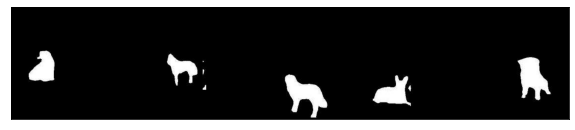

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


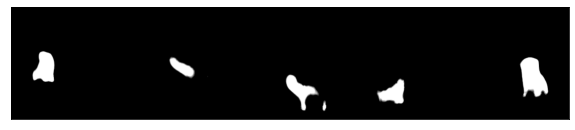



Train - Actual Depth


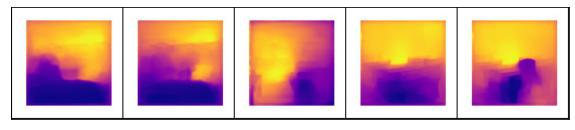

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


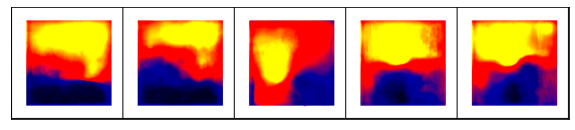

Best val loss: 0.329510
train: bce: 0.345306, dice: 0.426264, loss: 0.345306
train: bce: 0.345439, dice: 0.430019, loss: 0.345439
train: bce: 0.344692, dice: 0.429391, loss: 0.344692
train: bce: 0.344648, dice: 0.428405, loss: 0.344648
train: bce: 0.344651, dice: 0.429012, loss: 0.344651
train: bce: 0.344641, dice: 0.428862, loss: 0.344641
train: bce: 0.344477, dice: 0.428582, loss: 0.344477
train: bce: 0.344671, dice: 0.429134, loss: 0.344671
test: bce: 0.339859, dice: 0.437609, loss: 0.339859


Test - Actual mask: 24


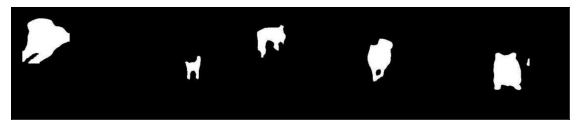

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


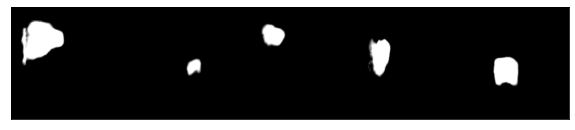



Test - Actual Depth


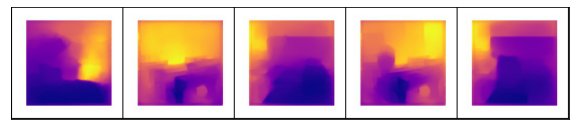

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


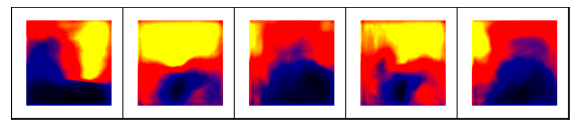

test: bce: 0.347194, dice: 0.432315, loss: 0.347194
test: bce: 0.345900, dice: 0.428268, loss: 0.345900
test: bce: 0.346382, dice: 0.429127, loss: 0.346382
************* 
Epoch: 24 	Training Loss: 0.329510 	Validation Loss: 0.346326

>>>>>>>> 
Epoch 25/40, LR: 0.01
train: bce: 0.337117, dice: 0.406655, loss: 0.337117
train: bce: 0.342484, dice: 0.419353, loss: 0.342484
train: bce: 0.343031, dice: 0.423038, loss: 0.343031
train: bce: 0.343924, dice: 0.426078, loss: 0.343924
train: bce: 0.343377, dice: 0.422279, loss: 0.343377
train: bce: 0.343454, dice: 0.423498, loss: 0.343454
train: bce: 0.343231, dice: 0.423299, loss: 0.343231
train: bce: 0.343047, dice: 0.423092, loss: 0.343047
train: bce: 0.343336, dice: 0.423168, loss: 0.343336
test: bce: 0.344890, dice: 0.419837, loss: 0.344890
test: bce: 0.343959, dice: 0.426411, loss: 0.343959
test: bce: 0.346017, dice: 0.424498, loss: 0.346017
test: bce: 0.345512, dice: 0.424482, loss: 0.345512
************* 
Epoch: 25 	Training Loss: 0.337117

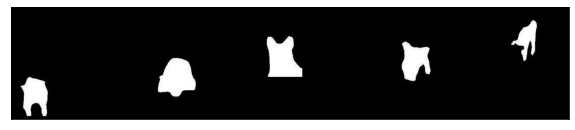

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


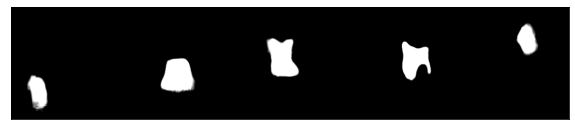



Train - Actual Depth


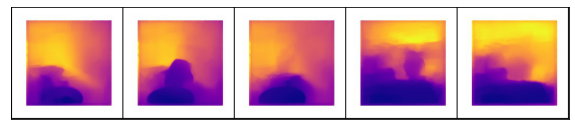



Train - Predicted Depth


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


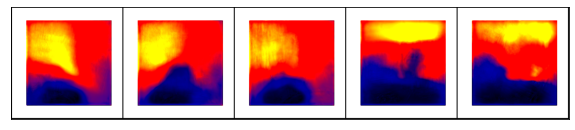

Best val loss: 0.333925
train: bce: 0.340225, dice: 0.414372, loss: 0.340225
train: bce: 0.340265, dice: 0.411478, loss: 0.340265
train: bce: 0.341305, dice: 0.414427, loss: 0.341305
train: bce: 0.341530, dice: 0.413622, loss: 0.341530
train: bce: 0.341982, dice: 0.415077, loss: 0.341982
train: bce: 0.341978, dice: 0.414671, loss: 0.341978
train: bce: 0.341863, dice: 0.415974, loss: 0.341863
train: bce: 0.341702, dice: 0.416188, loss: 0.341702
test: bce: 0.344496, dice: 0.422779, loss: 0.344496


Test - Actual mask: 28


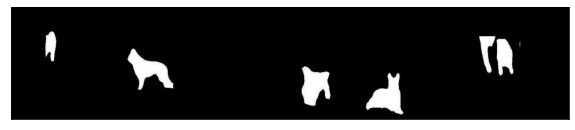

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


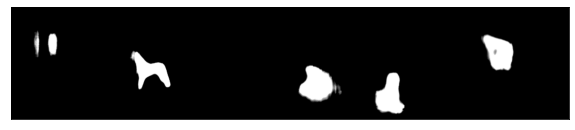



Test - Actual Depth


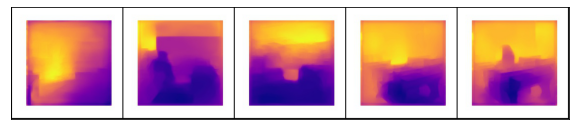

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


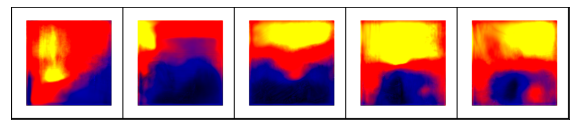

test: bce: 0.345236, dice: 0.429044, loss: 0.345236
test: bce: 0.343490, dice: 0.418576, loss: 0.343490
test: bce: 0.344038, dice: 0.420086, loss: 0.344038
************* 
Epoch: 28 	Training Loss: 0.333925 	Validation Loss: 0.343813

>>>>>>>> 
Epoch 29/40, LR: 0.01
train: bce: 0.346512, dice: 0.433056, loss: 0.346512
train: bce: 0.341780, dice: 0.416053, loss: 0.341780
train: bce: 0.341676, dice: 0.413764, loss: 0.341676
train: bce: 0.341357, dice: 0.412012, loss: 0.341357
train: bce: 0.341761, dice: 0.414300, loss: 0.341761
train: bce: 0.341359, dice: 0.412380, loss: 0.341359
train: bce: 0.341265, dice: 0.412213, loss: 0.341265
train: bce: 0.341152, dice: 0.412026, loss: 0.341152
train: bce: 0.341148, dice: 0.412586, loss: 0.341148
test: bce: 0.328198, dice: 0.389433, loss: 0.328198
test: bce: 0.343545, dice: 0.414978, loss: 0.343545
test: bce: 0.343485, dice: 0.413414, loss: 0.343485
test: bce: 0.343446, dice: 0.413789, loss: 0.343446
************* 
Epoch: 29 	Training Loss: 0.339649

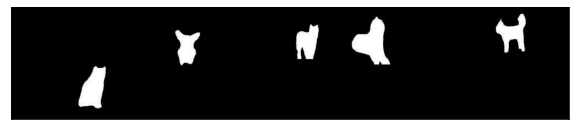

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


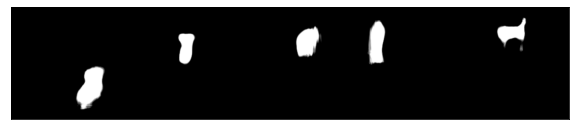



Train - Actual Depth


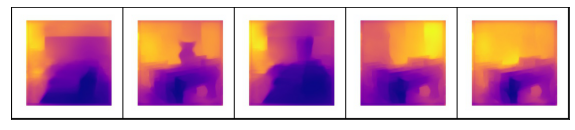

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


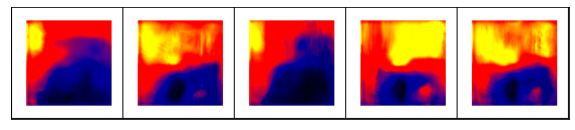

Best val loss: 0.332571
train: bce: 0.339886, dice: 0.400537, loss: 0.339886
train: bce: 0.340588, dice: 0.405976, loss: 0.340588
train: bce: 0.340208, dice: 0.405856, loss: 0.340208
train: bce: 0.340430, dice: 0.408765, loss: 0.340430
train: bce: 0.340335, dice: 0.409874, loss: 0.340335
train: bce: 0.340110, dice: 0.408339, loss: 0.340110
train: bce: 0.339857, dice: 0.407016, loss: 0.339857
train: bce: 0.339847, dice: 0.407160, loss: 0.339847
test: bce: 0.334776, dice: 0.390049, loss: 0.334776


Test - Actual mask: 32


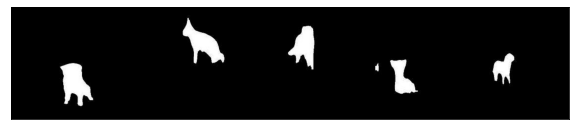

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


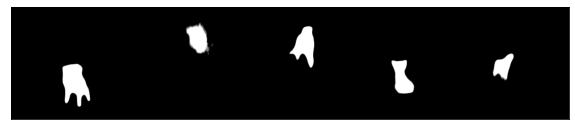



Test - Actual Depth


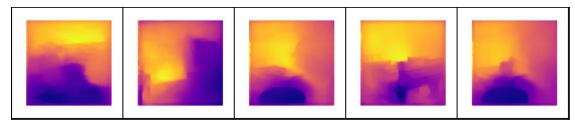

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


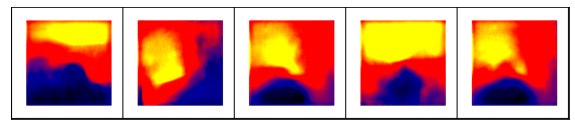

test: bce: 0.340762, dice: 0.403536, loss: 0.340762
test: bce: 0.341432, dice: 0.405103, loss: 0.341432
test: bce: 0.341458, dice: 0.407170, loss: 0.341458
************* 
Epoch: 32 	Training Loss: 0.329677 	Validation Loss: 0.341447

Validation loss decreased (0.341816 --> 0.341447).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 33/40, LR: 0.01
train: bce: 0.331134, dice: 0.339461, loss: 0.331134
train: bce: 0.340230, dice: 0.408775, loss: 0.340230
train: bce: 0.339560, dice: 0.403814, loss: 0.339560
train: bce: 0.339130, dice: 0.400418, loss: 0.339130
train: bce: 0.339034, dice: 0.402066, loss: 0.339034
train: bce: 0.338762, dice: 0.401591, loss: 0.338762
train: bce: 0.338849, dice: 0.401730, loss: 0.338849
train: bce: 0.339141, dice: 0.402247, loss: 0.339141
train: bce: 0.339117, dice: 0.402562, loss: 0.339117
test: bce: 0.325723, dice: 0.349332, loss: 0.325723
test: bce: 0.339246, dice:

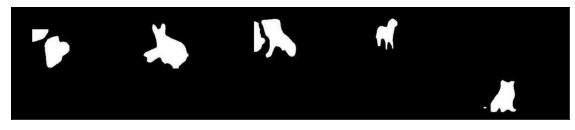

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


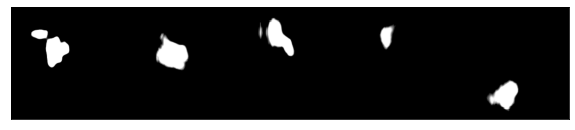



Train - Actual Depth


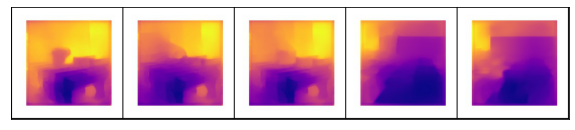

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


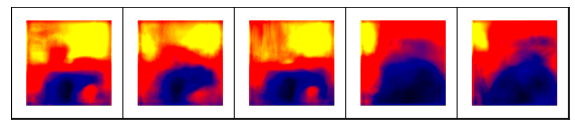

Best val loss: 0.338262
train: bce: 0.337055, dice: 0.401405, loss: 0.337055
train: bce: 0.339079, dice: 0.404153, loss: 0.339079
train: bce: 0.338394, dice: 0.401504, loss: 0.338394
train: bce: 0.338338, dice: 0.401060, loss: 0.338338
train: bce: 0.338532, dice: 0.399593, loss: 0.338532
train: bce: 0.338423, dice: 0.399642, loss: 0.338423
train: bce: 0.338355, dice: 0.398706, loss: 0.338355
train: bce: 0.338062, dice: 0.397913, loss: 0.338062
test: bce: 0.340967, dice: 0.377347, loss: 0.340967


Test - Actual mask: 36


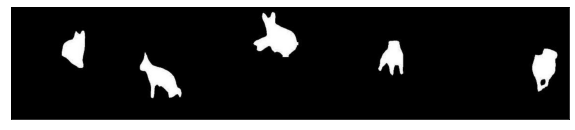

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


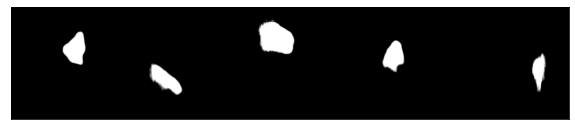



Test - Actual Depth


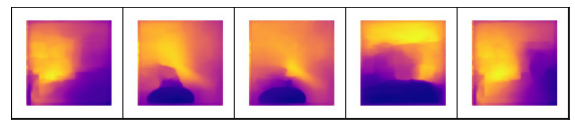

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


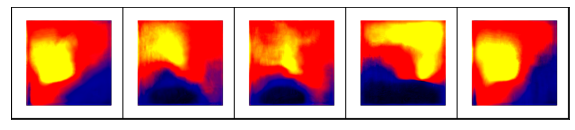

test: bce: 0.338910, dice: 0.401233, loss: 0.338910
test: bce: 0.339456, dice: 0.403788, loss: 0.339456
test: bce: 0.339449, dice: 0.402239, loss: 0.339449
************* 
Epoch: 36 	Training Loss: 0.331083 	Validation Loss: 0.339565

Validation loss decreased (0.340218 --> 0.339565).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 37/40, LR: 0.01
train: bce: 0.324713, dice: 0.387781, loss: 0.324713
train: bce: 0.336324, dice: 0.397336, loss: 0.336324
train: bce: 0.335723, dice: 0.391800, loss: 0.335723
train: bce: 0.336530, dice: 0.393012, loss: 0.336530
train: bce: 0.336977, dice: 0.395142, loss: 0.336977
train: bce: 0.337497, dice: 0.396951, loss: 0.337497
train: bce: 0.337409, dice: 0.394975, loss: 0.337409
train: bce: 0.337449, dice: 0.394953, loss: 0.337449
train: bce: 0.337449, dice: 0.395977, loss: 0.337449
test: bce: 0.328747, dice: 0.412647, loss: 0.328747
test: bce: 0.341669, dice:

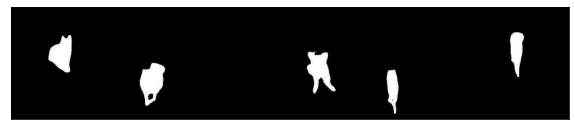

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


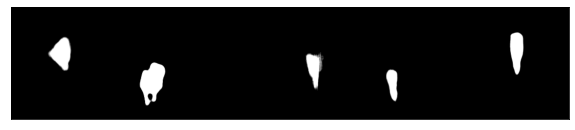



Train - Actual Depth


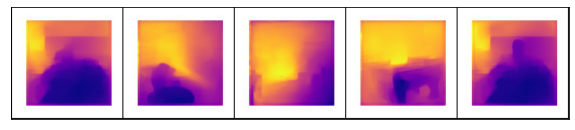

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


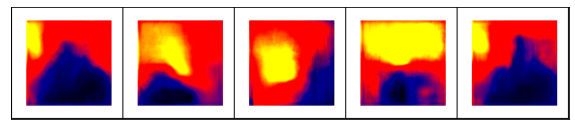

Best val loss: 0.326011
train: bce: 0.335258, dice: 0.393198, loss: 0.335258
train: bce: 0.336269, dice: 0.391677, loss: 0.336269
train: bce: 0.336629, dice: 0.393280, loss: 0.336629
train: bce: 0.335999, dice: 0.390660, loss: 0.335999
train: bce: 0.336004, dice: 0.390382, loss: 0.336004
train: bce: 0.335908, dice: 0.389936, loss: 0.335908
train: bce: 0.336075, dice: 0.390458, loss: 0.336075
train: bce: 0.336527, dice: 0.391079, loss: 0.336527
test: bce: 0.351376, dice: 0.430720, loss: 0.351376


Test - Actual mask: 40


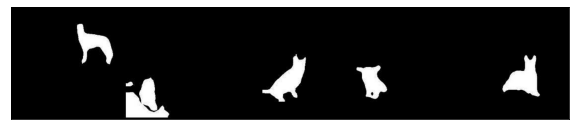

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


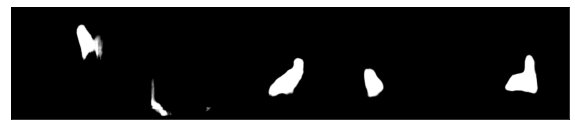



Test - Actual Depth


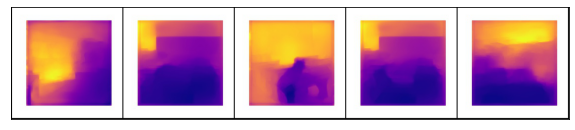

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


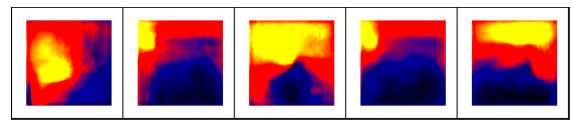

test: bce: 0.338059, dice: 0.385454, loss: 0.338059
test: bce: 0.337501, dice: 0.383850, loss: 0.337501
test: bce: 0.337986, dice: 0.386066, loss: 0.337986
************* 
Epoch: 40 	Training Loss: 0.326011 	Validation Loss: 0.337712

Validation loss decreased (0.339528 --> 0.337712).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 41/40, LR: 0.01
train: bce: 0.344744, dice: 0.445932, loss: 0.344744
train: bce: 0.337026, dice: 0.390879, loss: 0.337026
train: bce: 0.337719, dice: 0.391195, loss: 0.337719
train: bce: 0.337377, dice: 0.391543, loss: 0.337377
train: bce: 0.336924, dice: 0.390384, loss: 0.336924
train: bce: 0.336903, dice: 0.391226, loss: 0.336903
train: bce: 0.336711, dice: 0.391086, loss: 0.336711
train: bce: 0.336915, dice: 0.391396, loss: 0.336915
train: bce: 0.336829, dice: 0.391327, loss: 0.336829
test: bce: 0.324901, dice: 0.398959, loss: 0.324901
test: bce: 0.338032, dice:

In [19]:
# First Time Training
test_loss_min_input = 1e+5
model, train_loss, test_loss = train_test_model(START_EPOCH, EPOCHS, test_loss_min_input, model, criterion, device, trainloader, testloader, optimizer, scheduler, save_path=MODEL_SAVE_PATH)
print(train_loss)
print(test_loss)

In [20]:
!ls '/content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models'

best_model.pth	       test_predicted_depth.png  train_actual_mask.png
test_actual_depth.png  test_predicted_mask.png	 train_predicted_depth.png
test_actual_mask.png   train_actual_depth.png	 train_predicted_mask.png
time: 3.87 s


41
41


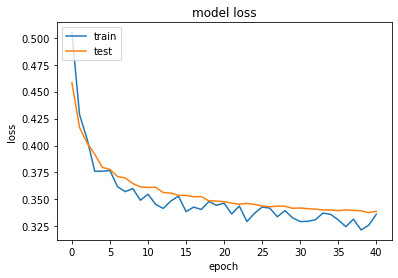

<Figure size 432x288 with 0 Axes>

time: 269 ms


In [21]:
plotmetrics(train_loss, test_loss, MODEL_SAVE_PATH)

##### Training - 2

30001
Last Epoch : 41, with loss: 0.33771218317747115
>>>>>>>> 
Epoch 41/60, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.785257, dice: 0.998975, loss: 0.785257
train: bce: 0.473971, dice: 0.903777, loss: 0.473971
train: bce: 0.445079, dice: 0.832059, loss: 0.445079
train: bce: 0.428486, dice: 0.779969, loss: 0.428486
train: bce: 0.417990, dice: 0.740682, loss: 0.417990
train: bce: 0.409465, dice: 0.709419, loss: 0.409465
train: bce: 0.402947, dice: 0.684548, loss: 0.402947
train: bce: 0.397870, dice: 0.665090, loss: 0.397870
train: bce: 0.393952, dice: 0.648902, loss: 0.393952
test: bce: 0.345825, dice: 0.484786, loss: 0.345825
test: bce: 0.360661, dice: 0.521479, loss: 0.360661
test: bce: 0.360224, dice: 0.520800, loss: 0.360224
test: bce: 0.359740, dice: 0.520976, loss: 0.359740
************* 
Epoch: 41 	Training Loss: 0.391138 	Validation Loss: 0.359763

>>>>>>>> 
Epoch 42/60, LR: 0.01
train: bce: 0.339675, dice: 0.495390, loss: 0.339675
train: bce: 0.363937, dice: 0.519624, loss: 0.363937
train: bce: 0.362964, dice: 0.519733, loss: 0.362964
train: bce: 0.361782, dice: 0.517129, loss: 0.

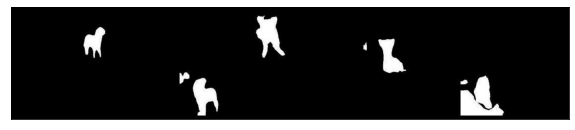

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


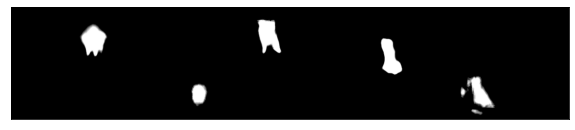



Train - Actual Depth


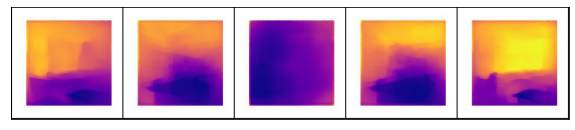

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


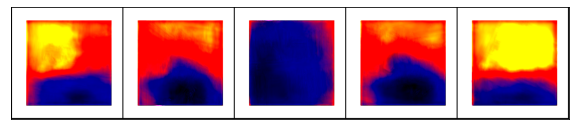

Best val loss: 0.351769
train: bce: 0.347249, dice: 0.457035, loss: 0.347249
train: bce: 0.347113, dice: 0.454232, loss: 0.347113
train: bce: 0.346749, dice: 0.450048, loss: 0.346749
train: bce: 0.346842, dice: 0.450032, loss: 0.346842
train: bce: 0.346134, dice: 0.447486, loss: 0.346134
train: bce: 0.345895, dice: 0.446369, loss: 0.345895
train: bce: 0.346116, dice: 0.446572, loss: 0.346116
train: bce: 0.346098, dice: 0.445839, loss: 0.346098
test: bce: 0.352958, dice: 0.469312, loss: 0.352958


Test - Actual mask: 44


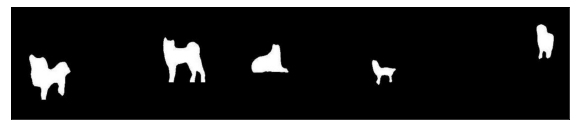

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


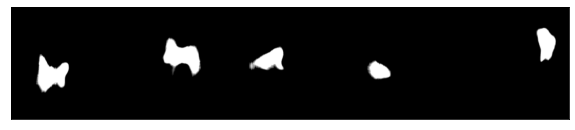



Test - Actual Depth


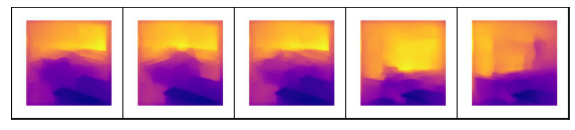

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


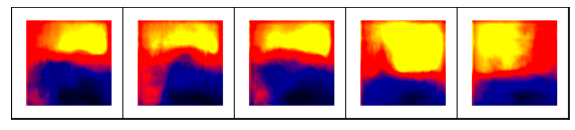

test: bce: 0.344380, dice: 0.446987, loss: 0.344380
test: bce: 0.345706, dice: 0.450310, loss: 0.345706
test: bce: 0.345331, dice: 0.450038, loss: 0.345331
************* 
Epoch: 44 	Training Loss: 0.344395 	Validation Loss: 0.345315

>>>>>>>> 
Epoch 45/60, LR: 0.01
train: bce: 0.354151, dice: 0.438892, loss: 0.354151
train: bce: 0.343383, dice: 0.428206, loss: 0.343383
train: bce: 0.344271, dice: 0.433392, loss: 0.344271
train: bce: 0.344016, dice: 0.435710, loss: 0.344016
train: bce: 0.343733, dice: 0.433780, loss: 0.343733
train: bce: 0.343906, dice: 0.435741, loss: 0.343906
train: bce: 0.343782, dice: 0.436592, loss: 0.343782
train: bce: 0.343551, dice: 0.435634, loss: 0.343551
train: bce: 0.343499, dice: 0.434490, loss: 0.343499
test: bce: 0.358898, dice: 0.472714, loss: 0.358898
test: bce: 0.340356, dice: 0.424747, loss: 0.340356
test: bce: 0.342260, dice: 0.430749, loss: 0.342260
test: bce: 0.341758, dice: 0.430745, loss: 0.341758
************* 
Epoch: 45 	Training Loss: 0.341919

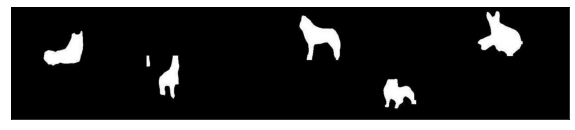

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


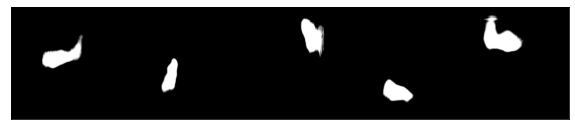



Train - Actual Depth


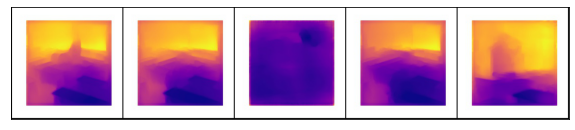

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


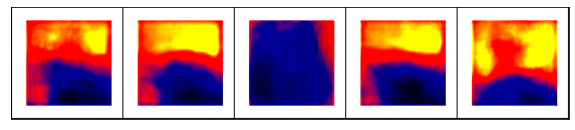

Best val loss: 0.338176
train: bce: 0.337938, dice: 0.411634, loss: 0.337938
train: bce: 0.338305, dice: 0.412201, loss: 0.338305
train: bce: 0.338002, dice: 0.410653, loss: 0.338002
train: bce: 0.338571, dice: 0.412253, loss: 0.338571
train: bce: 0.338421, dice: 0.410783, loss: 0.338421
train: bce: 0.338720, dice: 0.411869, loss: 0.338720
train: bce: 0.338841, dice: 0.412933, loss: 0.338841
train: bce: 0.338773, dice: 0.412967, loss: 0.338773
test: bce: 0.330066, dice: 0.429848, loss: 0.330066


Test - Actual mask: 48


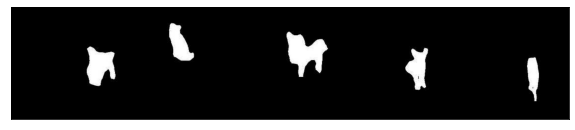

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


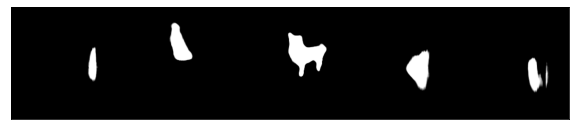



Test - Actual Depth


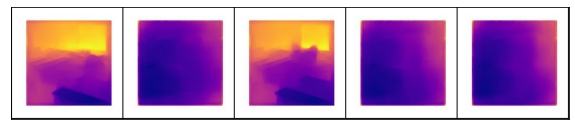



Test - Predicted Depth


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


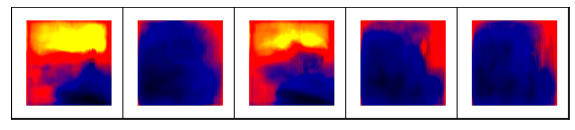

test: bce: 0.338016, dice: 0.416272, loss: 0.338016
test: bce: 0.338748, dice: 0.421229, loss: 0.338748
test: bce: 0.338636, dice: 0.420465, loss: 0.338636
************* 
Epoch: 48 	Training Loss: 0.337511 	Validation Loss: 0.338361

>>>>>>>> 
Epoch 49/60, LR: 0.01
train: bce: 0.341726, dice: 0.435184, loss: 0.341726
train: bce: 0.339377, dice: 0.413967, loss: 0.339377
train: bce: 0.339093, dice: 0.411243, loss: 0.339093
train: bce: 0.339161, dice: 0.414463, loss: 0.339161
train: bce: 0.339014, dice: 0.413842, loss: 0.339014
train: bce: 0.338932, dice: 0.414181, loss: 0.338932
train: bce: 0.338597, dice: 0.413257, loss: 0.338597
train: bce: 0.338584, dice: 0.412225, loss: 0.338584
train: bce: 0.338629, dice: 0.412109, loss: 0.338629
test: bce: 0.333387, dice: 0.425855, loss: 0.333387
test: bce: 0.337451, dice: 0.412795, loss: 0.337451
test: bce: 0.336675, dice: 0.408580, loss: 0.336675
test: bce: 0.336969, dice: 0.407931, loss: 0.336969
************* 
Epoch: 49 	Training Loss: 0.336235

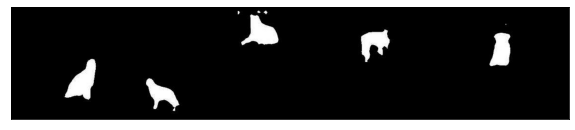

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


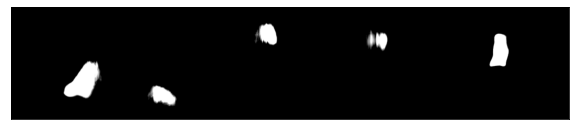



Train - Actual Depth


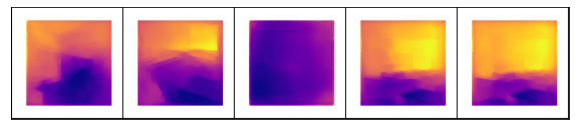



Train - Predicted Depth


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


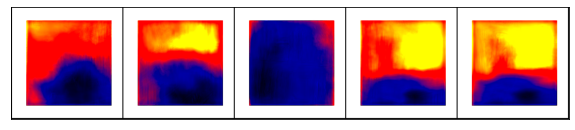

Best val loss: 0.326490
train: bce: 0.335623, dice: 0.392200, loss: 0.335623
train: bce: 0.336371, dice: 0.396711, loss: 0.336371
train: bce: 0.336305, dice: 0.397965, loss: 0.336305
train: bce: 0.335767, dice: 0.397146, loss: 0.335767
train: bce: 0.335555, dice: 0.397540, loss: 0.335555
train: bce: 0.335849, dice: 0.398586, loss: 0.335849
train: bce: 0.335520, dice: 0.397772, loss: 0.335520
train: bce: 0.335374, dice: 0.397498, loss: 0.335374
test: bce: 0.333303, dice: 0.391703, loss: 0.333303


Test - Actual mask: 52


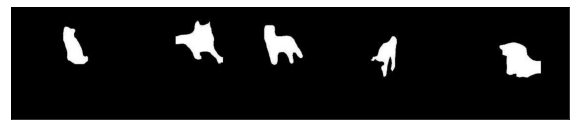

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


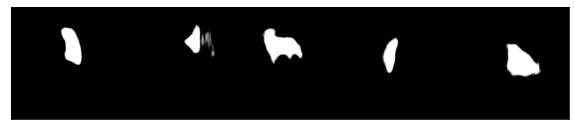



Test - Actual Depth


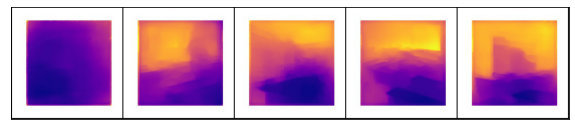

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


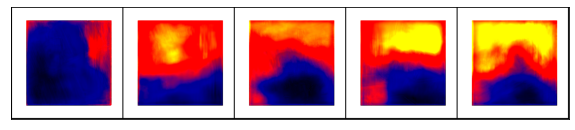

test: bce: 0.333772, dice: 0.388126, loss: 0.333772
test: bce: 0.334320, dice: 0.393098, loss: 0.334320
test: bce: 0.334955, dice: 0.394039, loss: 0.334955
************* 
Epoch: 52 	Training Loss: 0.326490 	Validation Loss: 0.335315

>>>>>>>> 
Epoch 53/60, LR: 0.01
train: bce: 0.326512, dice: 0.398863, loss: 0.326512
train: bce: 0.334124, dice: 0.390013, loss: 0.334124
train: bce: 0.334709, dice: 0.393550, loss: 0.334709
train: bce: 0.335369, dice: 0.394331, loss: 0.335369
train: bce: 0.335338, dice: 0.395178, loss: 0.335338
train: bce: 0.335435, dice: 0.395910, loss: 0.335435
train: bce: 0.335141, dice: 0.395826, loss: 0.335141
train: bce: 0.335029, dice: 0.395600, loss: 0.335029
train: bce: 0.334961, dice: 0.396067, loss: 0.334961
test: bce: 0.345022, dice: 0.457623, loss: 0.345022
test: bce: 0.335093, dice: 0.388724, loss: 0.335093
test: bce: 0.336302, dice: 0.389840, loss: 0.336302
test: bce: 0.335553, dice: 0.390249, loss: 0.335553
************* 
Epoch: 53 	Training Loss: 0.326512

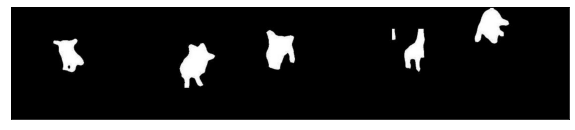

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


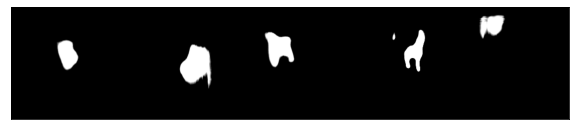



Train - Actual Depth


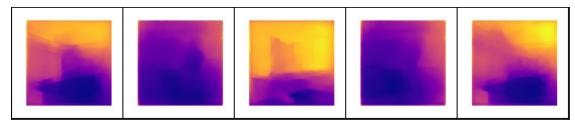

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


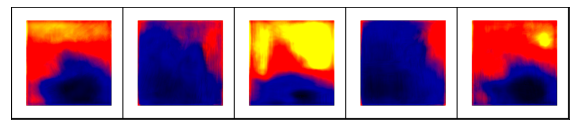

Best val loss: 0.329616
train: bce: 0.335611, dice: 0.397639, loss: 0.335611
train: bce: 0.334709, dice: 0.394948, loss: 0.334709
train: bce: 0.334661, dice: 0.394116, loss: 0.334661
train: bce: 0.334524, dice: 0.394000, loss: 0.334524
train: bce: 0.334225, dice: 0.393483, loss: 0.334225
train: bce: 0.333904, dice: 0.392093, loss: 0.333904
train: bce: 0.333905, dice: 0.391257, loss: 0.333905
train: bce: 0.333665, dice: 0.390437, loss: 0.333665
test: bce: 0.334787, dice: 0.385671, loss: 0.334787


Test - Actual mask: 56


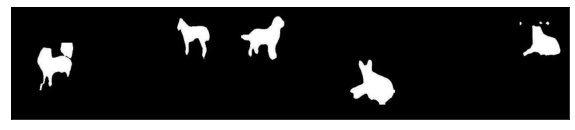

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


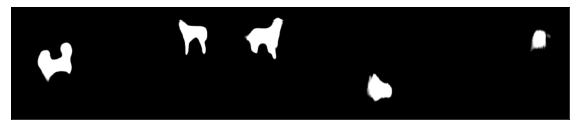



Test - Actual Depth


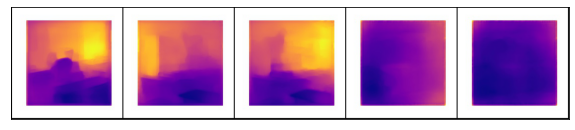

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


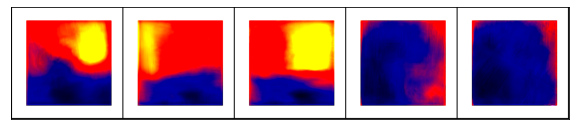

test: bce: 0.331719, dice: 0.386676, loss: 0.331719
test: bce: 0.332234, dice: 0.385372, loss: 0.332234
test: bce: 0.333011, dice: 0.388560, loss: 0.333011
************* 
Epoch: 56 	Training Loss: 0.329616 	Validation Loss: 0.332801

Validation loss decreased (0.333682 --> 0.332801).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 57/60, LR: 0.01
train: bce: 0.332026, dice: 0.369510, loss: 0.332026
train: bce: 0.332338, dice: 0.380627, loss: 0.332338
train: bce: 0.331749, dice: 0.382124, loss: 0.331749
train: bce: 0.332856, dice: 0.386890, loss: 0.332856
train: bce: 0.332908, dice: 0.386305, loss: 0.332908
train: bce: 0.332686, dice: 0.385957, loss: 0.332686
train: bce: 0.332721, dice: 0.385413, loss: 0.332721
train: bce: 0.332684, dice: 0.384787, loss: 0.332684
train: bce: 0.332558, dice: 0.383845, loss: 0.332558
test: bce: 0.330721, dice: 0.374170, loss: 0.330721
test: bce: 0.333207, dice:

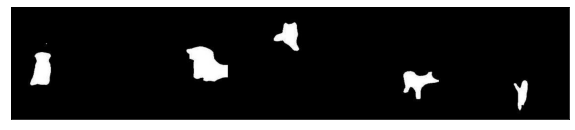

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


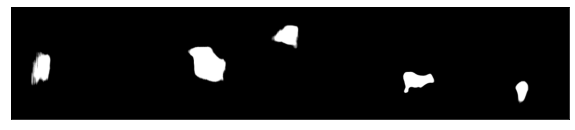



Train - Actual Depth


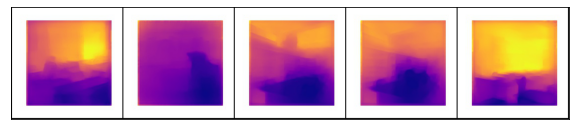

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


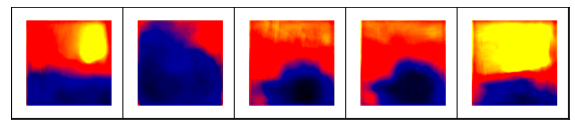

Best val loss: 0.322771
train: bce: 0.331828, dice: 0.385573, loss: 0.331828
train: bce: 0.332287, dice: 0.381919, loss: 0.332287
train: bce: 0.332006, dice: 0.382340, loss: 0.332006
train: bce: 0.331680, dice: 0.381002, loss: 0.331680
train: bce: 0.331668, dice: 0.382297, loss: 0.331668
train: bce: 0.332039, dice: 0.382764, loss: 0.332039
train: bce: 0.332169, dice: 0.382532, loss: 0.332169
train: bce: 0.331857, dice: 0.382437, loss: 0.331857
test: bce: 0.323756, dice: 0.347644, loss: 0.323756


Test - Actual mask: 60


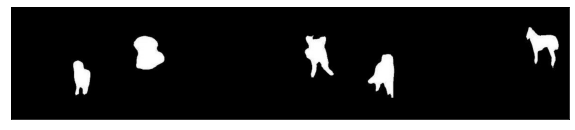

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


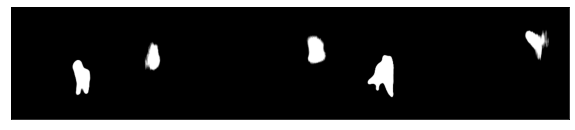



Test - Actual Depth


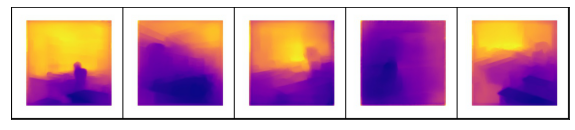

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


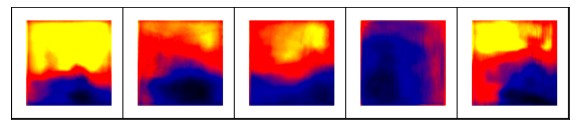

test: bce: 0.332552, dice: 0.376776, loss: 0.332552
test: bce: 0.333139, dice: 0.379313, loss: 0.333139
test: bce: 0.333544, dice: 0.380502, loss: 0.333544
************* 
Epoch: 60 	Training Loss: 0.322771 	Validation Loss: 0.332966

>>>>>>>> 
Epoch 61/60, LR: 0.01
train: bce: 0.345699, dice: 0.403363, loss: 0.345699
train: bce: 0.332409, dice: 0.380564, loss: 0.332409
train: bce: 0.331911, dice: 0.379574, loss: 0.331911
train: bce: 0.332185, dice: 0.381941, loss: 0.332185
train: bce: 0.331989, dice: 0.381147, loss: 0.331989
train: bce: 0.331594, dice: 0.380285, loss: 0.331594
train: bce: 0.331515, dice: 0.379961, loss: 0.331515
train: bce: 0.331515, dice: 0.379800, loss: 0.331515
train: bce: 0.331586, dice: 0.380459, loss: 0.331586
test: bce: 0.335491, dice: 0.400317, loss: 0.335491
test: bce: 0.329867, dice: 0.377889, loss: 0.329867
test: bce: 0.330300, dice: 0.371672, loss: 0.330300
test: bce: 0.330658, dice: 0.376278, loss: 0.330658
************* 
Epoch: 61 	Training Loss: 0.331096

In [15]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_2_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, EPOCHS, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

21
21


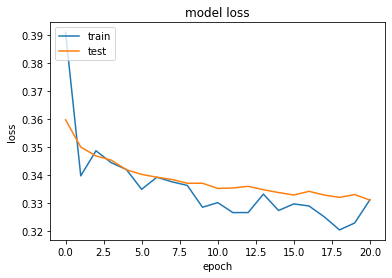

<Figure size 432x288 with 0 Axes>

time: 265 ms


In [16]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 3

30001
Last Epoch : 62, with loss: 0.3309582481980324
>>>>>>>> 
Epoch 62/81, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.687397, dice: 0.955200, loss: 0.687397
train: bce: 0.468202, dice: 0.885351, loss: 0.468202
train: bce: 0.433254, dice: 0.772294, loss: 0.433254
train: bce: 0.416160, dice: 0.708530, loss: 0.416160
train: bce: 0.404141, dice: 0.666326, loss: 0.404141
train: bce: 0.396415, dice: 0.633872, loss: 0.396415
train: bce: 0.391230, dice: 0.613326, loss: 0.391230
train: bce: 0.387029, dice: 0.594602, loss: 0.387029
train: bce: 0.383259, dice: 0.579835, loss: 0.383259
test: bce: 0.348882, dice: 0.526268, loss: 0.348882
test: bce: 0.358013, dice: 0.479510, loss: 0.358013
test: bce: 0.358111, dice: 0.478465, loss: 0.358111
test: bce: 0.358129, dice: 0.480920, loss: 0.358129
************* 
Epoch: 62 	Training Loss: 0.381199 	Validation Loss: 0.358590

>>>>>>>> 
Epoch 63/81, LR: 0.01
train: bce: 0.353220, dice: 0.454556, loss: 0.353220
train: bce: 0.355059, dice: 0.467418, loss: 0.355059
train: bce: 0.354320, dice: 0.459962, loss: 0.354320
train: bce: 0.353924, dice: 0.458042, loss: 0.

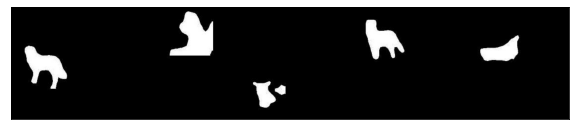

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


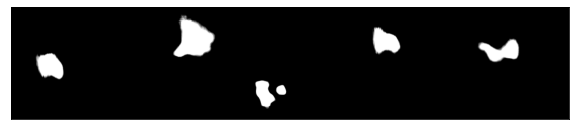



Train - Actual Depth


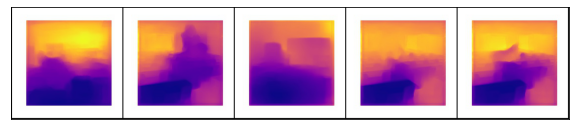

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


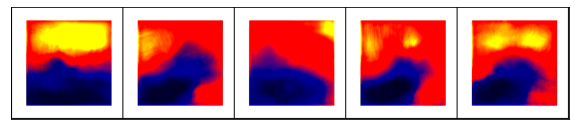

Best val loss: 0.355043
train: bce: 0.347500, dice: 0.434912, loss: 0.347500
train: bce: 0.349042, dice: 0.438924, loss: 0.349042
train: bce: 0.349123, dice: 0.437899, loss: 0.349123
train: bce: 0.348674, dice: 0.436827, loss: 0.348674
train: bce: 0.348532, dice: 0.436690, loss: 0.348532
train: bce: 0.347985, dice: 0.435858, loss: 0.347985
train: bce: 0.347919, dice: 0.434299, loss: 0.347919
train: bce: 0.347631, dice: 0.431709, loss: 0.347631
test: bce: 0.331929, dice: 0.400400, loss: 0.331929


Test - Actual mask: 64


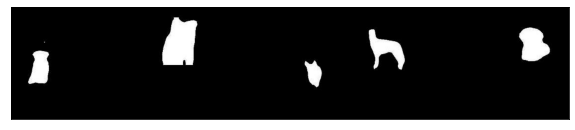

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


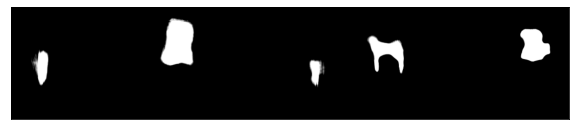



Test - Actual Depth


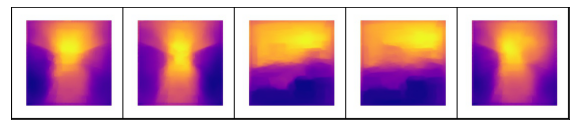



Test - Predicted Depth


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


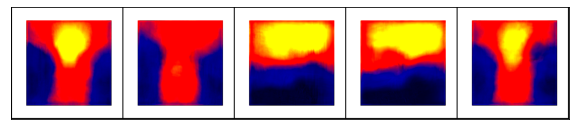

test: bce: 0.346919, dice: 0.426794, loss: 0.346919
test: bce: 0.345785, dice: 0.419821, loss: 0.345785
test: bce: 0.345921, dice: 0.418259, loss: 0.345921
************* 
Epoch: 64 	Training Loss: 0.344912 	Validation Loss: 0.345453

>>>>>>>> 
Epoch 65/81, LR: 0.01
train: bce: 0.344137, dice: 0.396866, loss: 0.344137
train: bce: 0.345179, dice: 0.422831, loss: 0.345179
train: bce: 0.345356, dice: 0.424113, loss: 0.345356
train: bce: 0.345802, dice: 0.421540, loss: 0.345802
train: bce: 0.345849, dice: 0.421325, loss: 0.345849
train: bce: 0.345333, dice: 0.419871, loss: 0.345333
train: bce: 0.345130, dice: 0.419121, loss: 0.345130
train: bce: 0.345129, dice: 0.419174, loss: 0.345129
train: bce: 0.345135, dice: 0.419594, loss: 0.345135
test: bce: 0.341623, dice: 0.393385, loss: 0.341623
test: bce: 0.345837, dice: 0.418644, loss: 0.345837
test: bce: 0.344615, dice: 0.420150, loss: 0.344615
test: bce: 0.343530, dice: 0.415992, loss: 0.343530
************* 
Epoch: 65 	Training Loss: 0.344137

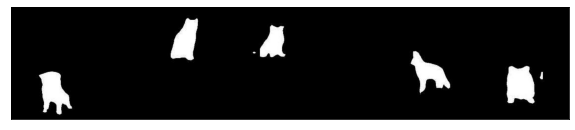

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


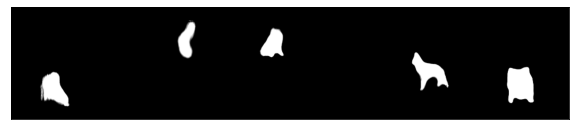



Train - Actual Depth


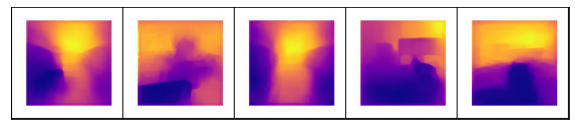

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


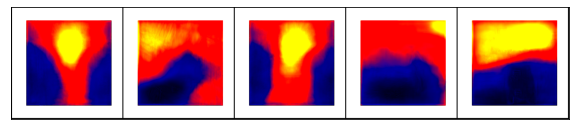

Best val loss: 0.323950
train: bce: 0.341397, dice: 0.402454, loss: 0.341397
train: bce: 0.341837, dice: 0.402339, loss: 0.341837
train: bce: 0.341582, dice: 0.401891, loss: 0.341582
train: bce: 0.341395, dice: 0.398651, loss: 0.341395
train: bce: 0.340932, dice: 0.397365, loss: 0.340932
train: bce: 0.340963, dice: 0.398894, loss: 0.340963
train: bce: 0.340794, dice: 0.398534, loss: 0.340794
train: bce: 0.340848, dice: 0.399959, loss: 0.340848
test: bce: 0.353210, dice: 0.410595, loss: 0.353210


Test - Actual mask: 68


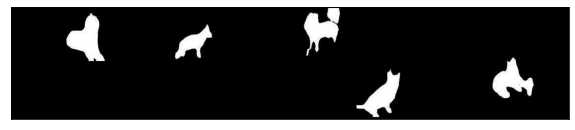

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


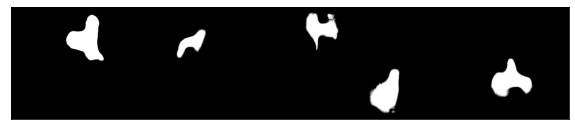



Test - Actual Depth


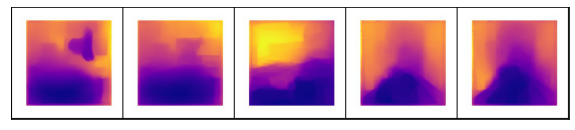

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


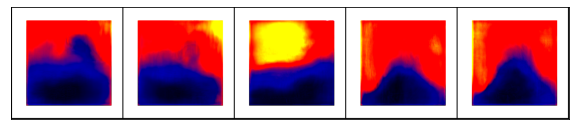

test: bce: 0.341037, dice: 0.401636, loss: 0.341037
test: bce: 0.340284, dice: 0.400117, loss: 0.340284
test: bce: 0.340393, dice: 0.400564, loss: 0.340393
************* 
Epoch: 68 	Training Loss: 0.323289 	Validation Loss: 0.340432

>>>>>>>> 
Epoch 69/81, LR: 0.01
train: bce: 0.334376, dice: 0.396939, loss: 0.334376
train: bce: 0.340051, dice: 0.392002, loss: 0.340051
train: bce: 0.339719, dice: 0.394409, loss: 0.339719
train: bce: 0.339272, dice: 0.397871, loss: 0.339272
train: bce: 0.339054, dice: 0.397193, loss: 0.339054
train: bce: 0.339487, dice: 0.396935, loss: 0.339487
train: bce: 0.339353, dice: 0.395594, loss: 0.339353
train: bce: 0.339570, dice: 0.395307, loss: 0.339570
train: bce: 0.339287, dice: 0.393877, loss: 0.339287
test: bce: 0.348965, dice: 0.438399, loss: 0.348965
test: bce: 0.338800, dice: 0.388368, loss: 0.338800
test: bce: 0.339635, dice: 0.388656, loss: 0.339635
test: bce: 0.338984, dice: 0.388389, loss: 0.338984
************* 
Epoch: 69 	Training Loss: 0.332771

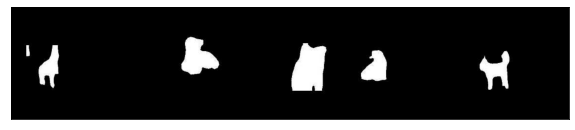

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


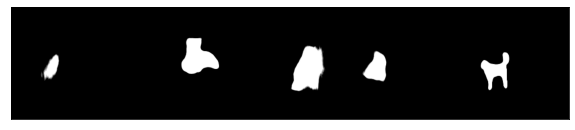



Train - Actual Depth


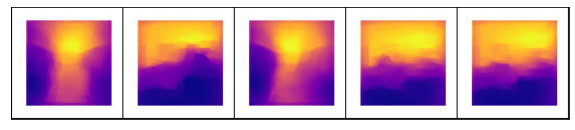

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


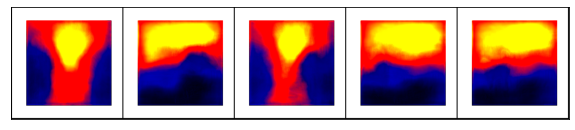

Best val loss: 0.335861
train: bce: 0.337930, dice: 0.386223, loss: 0.337930
train: bce: 0.336764, dice: 0.383656, loss: 0.336764
train: bce: 0.337159, dice: 0.384880, loss: 0.337159
train: bce: 0.336602, dice: 0.385738, loss: 0.336602
train: bce: 0.337141, dice: 0.384935, loss: 0.337141
train: bce: 0.337292, dice: 0.385764, loss: 0.337292
train: bce: 0.337186, dice: 0.384980, loss: 0.337186
train: bce: 0.337306, dice: 0.385692, loss: 0.337306
test: bce: 0.334862, dice: 0.345192, loss: 0.334862


Test - Actual mask: 72


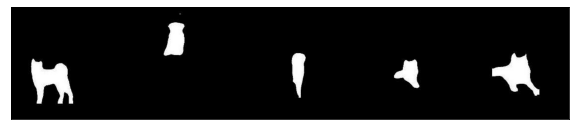

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


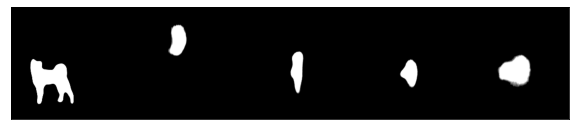



Test - Actual Depth


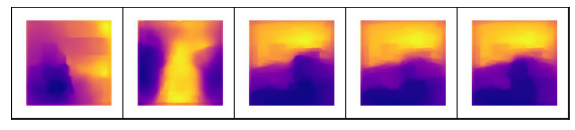

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


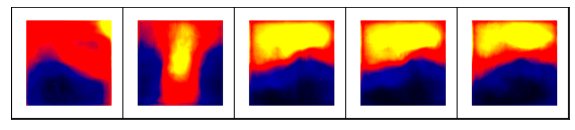

test: bce: 0.336737, dice: 0.381613, loss: 0.336737
test: bce: 0.337187, dice: 0.383506, loss: 0.337187
test: bce: 0.337566, dice: 0.386793, loss: 0.337566
************* 
Epoch: 72 	Training Loss: 0.334699 	Validation Loss: 0.337761

>>>>>>>> 
Epoch 73/81, LR: 0.01
train: bce: 0.343855, dice: 0.364927, loss: 0.343855
train: bce: 0.339380, dice: 0.388937, loss: 0.339380
train: bce: 0.338084, dice: 0.386225, loss: 0.338084
train: bce: 0.337578, dice: 0.387274, loss: 0.337578
train: bce: 0.337700, dice: 0.387174, loss: 0.337700
train: bce: 0.337799, dice: 0.386876, loss: 0.337799
train: bce: 0.337595, dice: 0.386769, loss: 0.337595
train: bce: 0.337486, dice: 0.386518, loss: 0.337486
train: bce: 0.337411, dice: 0.386544, loss: 0.337411
test: bce: 0.331142, dice: 0.328467, loss: 0.331142
test: bce: 0.336154, dice: 0.381410, loss: 0.336154
test: bce: 0.336856, dice: 0.385315, loss: 0.336856
test: bce: 0.336640, dice: 0.386919, loss: 0.336640
************* 
Epoch: 73 	Training Loss: 0.336463

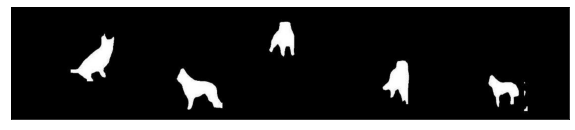

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


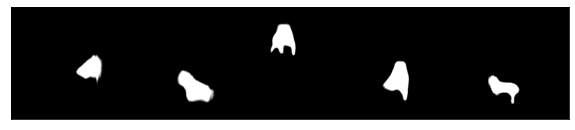



Train - Actual Depth


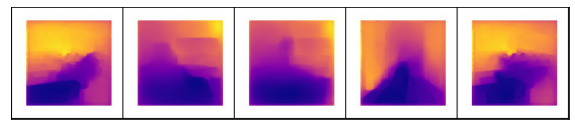

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


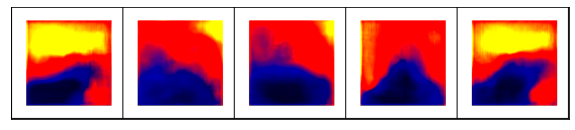

Best val loss: 0.349498
train: bce: 0.337141, dice: 0.380350, loss: 0.337141
train: bce: 0.335711, dice: 0.377135, loss: 0.335711
train: bce: 0.335577, dice: 0.376277, loss: 0.335577
train: bce: 0.334816, dice: 0.373973, loss: 0.334816
train: bce: 0.334967, dice: 0.374936, loss: 0.334967
train: bce: 0.334869, dice: 0.375742, loss: 0.334869
train: bce: 0.335460, dice: 0.376833, loss: 0.335460
train: bce: 0.335442, dice: 0.377190, loss: 0.335442
test: bce: 0.340500, dice: 0.356017, loss: 0.340500


Test - Actual mask: 76


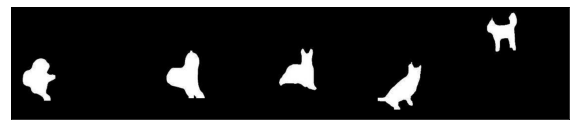

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


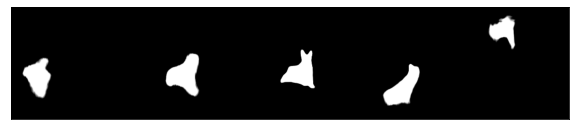



Test - Actual Depth


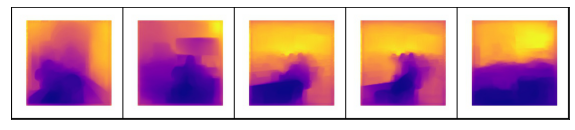

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


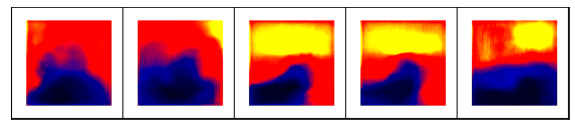

test: bce: 0.340330, dice: 0.387598, loss: 0.340330
test: bce: 0.338329, dice: 0.382676, loss: 0.338329
test: bce: 0.338636, dice: 0.382950, loss: 0.338636
************* 
Epoch: 76 	Training Loss: 0.334808 	Validation Loss: 0.338811

>>>>>>>> 
Epoch 77/81, LR: 0.01
train: bce: 0.338840, dice: 0.410284, loss: 0.338840
train: bce: 0.335619, dice: 0.375490, loss: 0.335619
train: bce: 0.334806, dice: 0.372852, loss: 0.334806
train: bce: 0.334815, dice: 0.373755, loss: 0.334815
train: bce: 0.334648, dice: 0.373022, loss: 0.334648
train: bce: 0.334787, dice: 0.374235, loss: 0.334787
train: bce: 0.334277, dice: 0.374567, loss: 0.334277
train: bce: 0.334537, dice: 0.374376, loss: 0.334537
train: bce: 0.334915, dice: 0.375103, loss: 0.334915
test: bce: 0.334431, dice: 0.391361, loss: 0.334431
test: bce: 0.336216, dice: 0.377657, loss: 0.336216
test: bce: 0.336442, dice: 0.374338, loss: 0.336442
test: bce: 0.336873, dice: 0.375164, loss: 0.336873
************* 
Epoch: 77 	Training Loss: 0.332920

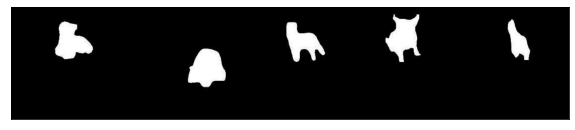

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


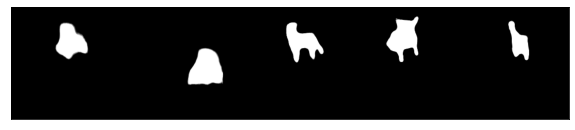



Train - Actual Depth


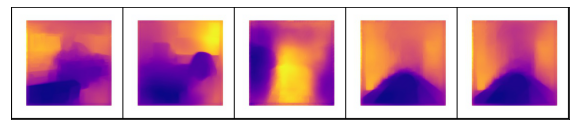

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


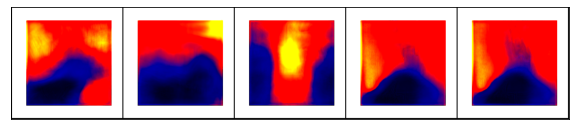

Best val loss: 0.335197
train: bce: 0.333991, dice: 0.372058, loss: 0.333991
train: bce: 0.334650, dice: 0.370860, loss: 0.334650
train: bce: 0.335037, dice: 0.370704, loss: 0.335037
train: bce: 0.334568, dice: 0.369995, loss: 0.334568
train: bce: 0.334691, dice: 0.371292, loss: 0.334691
train: bce: 0.334476, dice: 0.370768, loss: 0.334476
train: bce: 0.334194, dice: 0.371017, loss: 0.334194
train: bce: 0.334355, dice: 0.371700, loss: 0.334355
test: bce: 0.324565, dice: 0.340413, loss: 0.324565


Test - Actual mask: 80


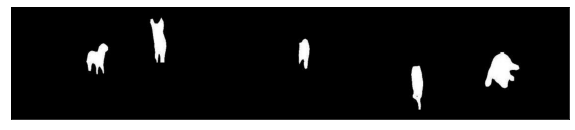

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


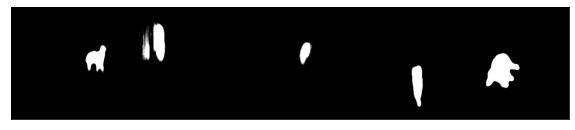



Test - Actual Depth


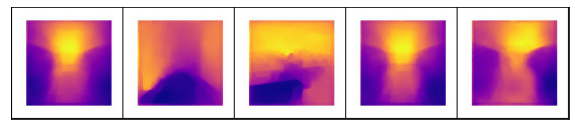

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


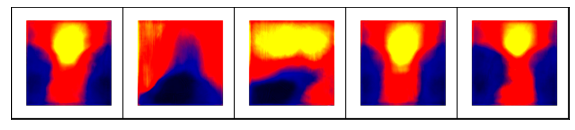

test: bce: 0.335197, dice: 0.375334, loss: 0.335197
test: bce: 0.334306, dice: 0.375238, loss: 0.334306
test: bce: 0.334753, dice: 0.373769, loss: 0.334753
************* 
Epoch: 80 	Training Loss: 0.328424 	Validation Loss: 0.334874

>>>>>>>> 
Epoch 81/81, LR: 0.01
train: bce: 0.321990, dice: 0.321863, loss: 0.321990
train: bce: 0.334182, dice: 0.374753, loss: 0.334182
train: bce: 0.333416, dice: 0.369397, loss: 0.333416
train: bce: 0.333579, dice: 0.370315, loss: 0.333579
train: bce: 0.333604, dice: 0.370935, loss: 0.333604
train: bce: 0.333433, dice: 0.369212, loss: 0.333433
train: bce: 0.333535, dice: 0.369889, loss: 0.333535
train: bce: 0.333875, dice: 0.370425, loss: 0.333875
train: bce: 0.333798, dice: 0.370273, loss: 0.333798
test: bce: 0.332939, dice: 0.358306, loss: 0.332939
test: bce: 0.333608, dice: 0.369117, loss: 0.333608
test: bce: 0.333590, dice: 0.371444, loss: 0.333590
test: bce: 0.333958, dice: 0.372232, loss: 0.333958
************* 
Epoch: 81 	Training Loss: 0.321990

In [33]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_3_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, EPOCHS, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

In [0]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 4

30001
Last Epoch : 62, with loss: 0.3309582481980324
>>>>>>>> 
Epoch 62/71, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.590348, dice: 0.853057, loss: 0.590348
train: bce: 0.448340, dice: 0.848946, loss: 0.448340
train: bce: 0.415777, dice: 0.744651, loss: 0.415777
train: bce: 0.399679, dice: 0.683214, loss: 0.399679
train: bce: 0.389550, dice: 0.643634, loss: 0.389550
train: bce: 0.382220, dice: 0.616451, loss: 0.382220
train: bce: 0.377031, dice: 0.594164, loss: 0.377031
train: bce: 0.372590, dice: 0.576767, loss: 0.372590
train: bce: 0.369206, dice: 0.563571, loss: 0.369206
test: bce: 0.339069, dice: 0.424980, loss: 0.339069
test: bce: 0.341131, dice: 0.436613, loss: 0.341131
test: bce: 0.342498, dice: 0.441227, loss: 0.342498
test: bce: 0.342389, dice: 0.444089, loss: 0.342389
************* 
Epoch: 62 	Training Loss: 0.367187 	Validation Loss: 0.342416

>>>>>>>> 
Epoch 63/71, LR: 0.01
train: bce: 0.339695, dice: 0.423089, loss: 0.339695
train: bce: 0.342262, dice: 0.454332, loss: 0.342262
train: bce: 0.342214, dice: 0.454982, loss: 0.342214
train: bce: 0.341201, dice: 0.450569, loss: 0.

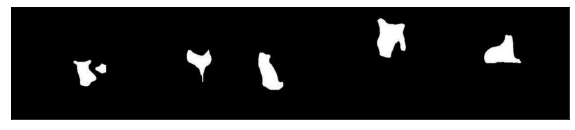

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


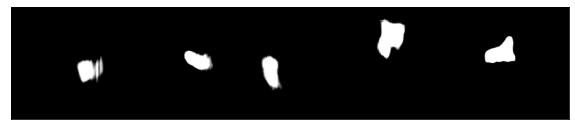



Train - Actual Depth


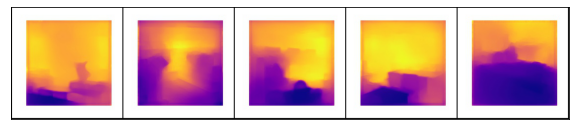

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


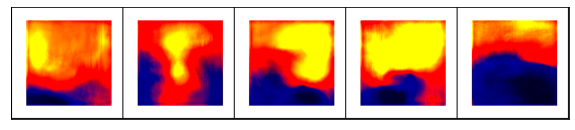

Best val loss: 0.335559
train: bce: 0.333530, dice: 0.417891, loss: 0.333530
train: bce: 0.333992, dice: 0.421080, loss: 0.333992
train: bce: 0.334192, dice: 0.420241, loss: 0.334192
train: bce: 0.334152, dice: 0.420852, loss: 0.334152
train: bce: 0.334209, dice: 0.421492, loss: 0.334209
train: bce: 0.334316, dice: 0.420704, loss: 0.334316
train: bce: 0.333987, dice: 0.421335, loss: 0.333987
train: bce: 0.333981, dice: 0.421281, loss: 0.333981
test: bce: 0.332136, dice: 0.392560, loss: 0.332136


Test - Actual mask: 64


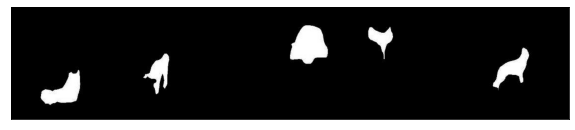

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


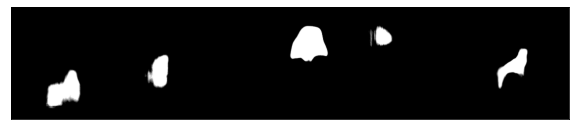



Test - Actual Depth


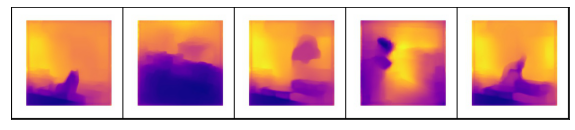

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


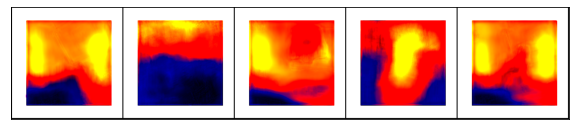

test: bce: 0.334716, dice: 0.425669, loss: 0.334716
test: bce: 0.334560, dice: 0.424732, loss: 0.334560
test: bce: 0.334240, dice: 0.422844, loss: 0.334240
************* 
Epoch: 64 	Training Loss: 0.331914 	Validation Loss: 0.333559

>>>>>>>> 
Epoch 65/71, LR: 0.01
train: bce: 0.338148, dice: 0.420561, loss: 0.338148
train: bce: 0.332206, dice: 0.417955, loss: 0.332206
train: bce: 0.332846, dice: 0.414908, loss: 0.332846
train: bce: 0.332364, dice: 0.414612, loss: 0.332364
train: bce: 0.332352, dice: 0.413803, loss: 0.332352
train: bce: 0.331843, dice: 0.412097, loss: 0.331843
train: bce: 0.332149, dice: 0.411989, loss: 0.332149
train: bce: 0.331887, dice: 0.411854, loss: 0.331887
train: bce: 0.331751, dice: 0.411245, loss: 0.331751
test: bce: 0.321969, dice: 0.348774, loss: 0.321969
test: bce: 0.329078, dice: 0.395645, loss: 0.329078
test: bce: 0.328700, dice: 0.393631, loss: 0.328700
test: bce: 0.329282, dice: 0.397046, loss: 0.329282
************* 
Epoch: 65 	Training Loss: 0.330615

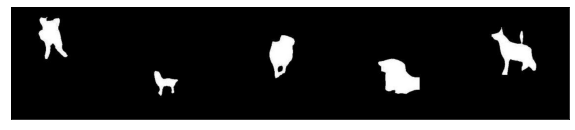

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


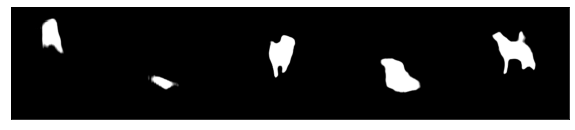



Train - Actual Depth


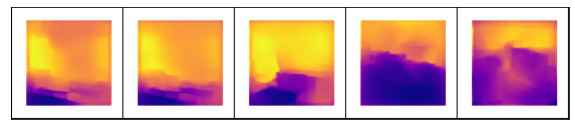

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


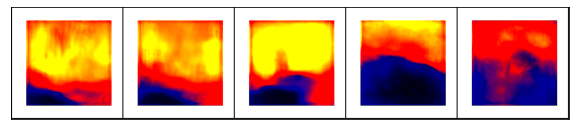

Best val loss: 0.326363
train: bce: 0.327533, dice: 0.396575, loss: 0.327533
train: bce: 0.327812, dice: 0.391896, loss: 0.327812
train: bce: 0.328743, dice: 0.395073, loss: 0.328743
train: bce: 0.328073, dice: 0.394685, loss: 0.328073
train: bce: 0.328255, dice: 0.394071, loss: 0.328255
train: bce: 0.327931, dice: 0.393179, loss: 0.327931
train: bce: 0.327477, dice: 0.392278, loss: 0.327477
train: bce: 0.327484, dice: 0.392090, loss: 0.327484
test: bce: 0.334744, dice: 0.394496, loss: 0.334744


Test - Actual mask: 68


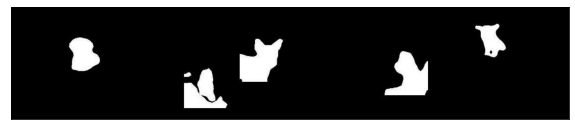

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


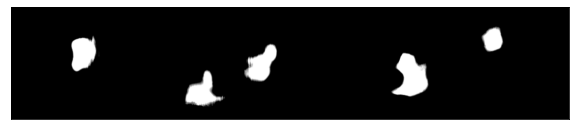



Test - Actual Depth


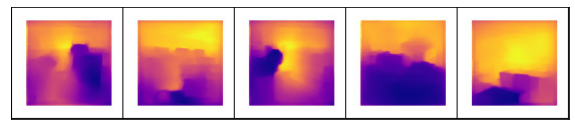

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


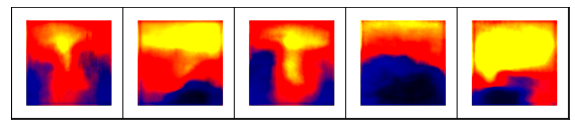

test: bce: 0.326065, dice: 0.390224, loss: 0.326065
test: bce: 0.326777, dice: 0.390041, loss: 0.326777
test: bce: 0.326120, dice: 0.386739, loss: 0.326120
************* 
Epoch: 68 	Training Loss: 0.321818 	Validation Loss: 0.326582

Validation loss decreased (0.328111 --> 0.326582).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 69/71, LR: 0.01
train: bce: 0.329947, dice: 0.357012, loss: 0.329947
train: bce: 0.326078, dice: 0.386545, loss: 0.326078
train: bce: 0.325380, dice: 0.385517, loss: 0.325380
train: bce: 0.325081, dice: 0.385539, loss: 0.325081
train: bce: 0.325789, dice: 0.388388, loss: 0.325789
train: bce: 0.326448, dice: 0.388994, loss: 0.326448
train: bce: 0.326373, dice: 0.389349, loss: 0.326373
train: bce: 0.326154, dice: 0.387293, loss: 0.326154
train: bce: 0.326269, dice: 0.388099, loss: 0.326269
test: bce: 0.323478, dice: 0.421820, loss: 0.323478
test: bce: 0.327668, dice:

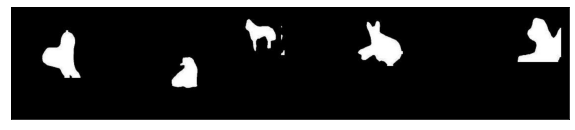

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


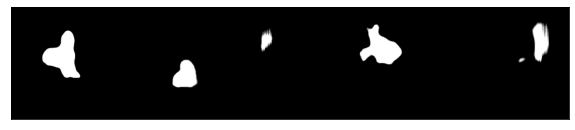



Train - Actual Depth


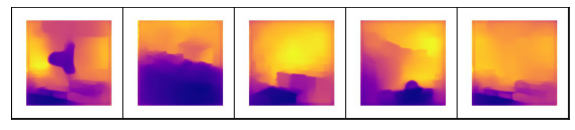

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


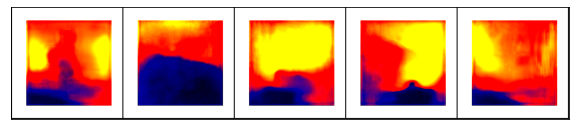

Best val loss: 0.330644
train: bce: 0.323869, dice: 0.372394, loss: 0.323869
train: bce: 0.323991, dice: 0.375580, loss: 0.323991
train: bce: 0.324777, dice: 0.378934, loss: 0.324777
train: bce: 0.324615, dice: 0.379524, loss: 0.324615
train: bce: 0.324382, dice: 0.379414, loss: 0.324382
train: bce: 0.324524, dice: 0.379882, loss: 0.324524
train: bce: 0.324419, dice: 0.379716, loss: 0.324419
train: bce: 0.324655, dice: 0.380454, loss: 0.324655
test: bce: 0.324353, dice: 0.342475, loss: 0.324353


Test - Actual mask: 72


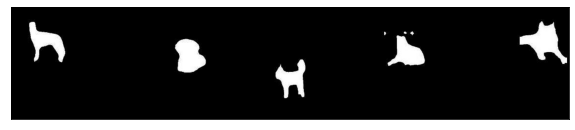

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


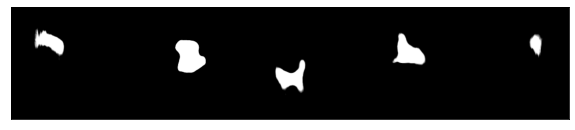



Test - Actual Depth


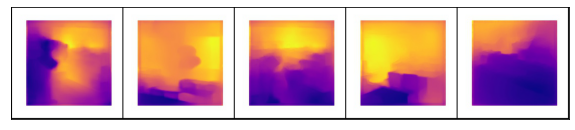

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


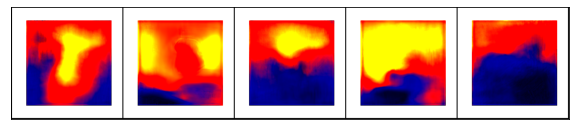

test: bce: 0.323064, dice: 0.369945, loss: 0.323064
test: bce: 0.323927, dice: 0.374159, loss: 0.323927
test: bce: 0.324149, dice: 0.376571, loss: 0.324149
************* 
Epoch: 72 	Training Loss: 0.321779 	Validation Loss: 0.324665

Validation loss decreased (0.324795 --> 0.324665).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
time: 1h 35min 52s


In [48]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_4_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


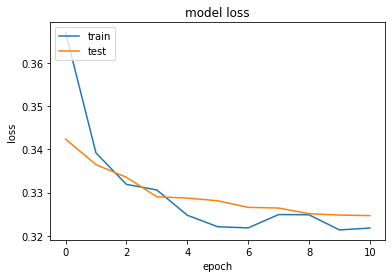

<Figure size 432x288 with 0 Axes>

time: 362 ms


In [49]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 5

30001
Last Epoch : 81, with loss: 0.3153046412269274
>>>>>>>> 
Epoch 81/90, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.299685, dice: 0.319424, loss: 0.299685
train: bce: 0.313389, dice: 0.355112, loss: 0.313389
train: bce: 0.314065, dice: 0.358837, loss: 0.314065
train: bce: 0.313455, dice: 0.361578, loss: 0.313455
train: bce: 0.313513, dice: 0.360092, loss: 0.313513
train: bce: 0.313718, dice: 0.360902, loss: 0.313718
train: bce: 0.314125, dice: 0.362568, loss: 0.314125
train: bce: 0.313864, dice: 0.361975, loss: 0.313864
train: bce: 0.313828, dice: 0.361324, loss: 0.313828
test: bce: 0.325392, dice: 0.377263, loss: 0.325392
test: bce: 0.315387, dice: 0.360522, loss: 0.315387
test: bce: 0.313468, dice: 0.355833, loss: 0.313468
test: bce: 0.313342, dice: 0.356921, loss: 0.313342
************* 
Epoch: 81 	Training Loss: 0.299685 	Validation Loss: 0.313581

Validation loss decreased (0.315305 --> 0.313581).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 82/90, LR: 0.01
train: bce: 0.323051, dice

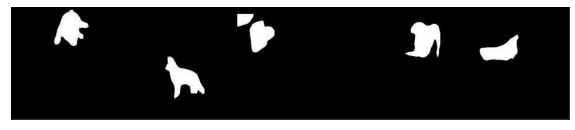

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


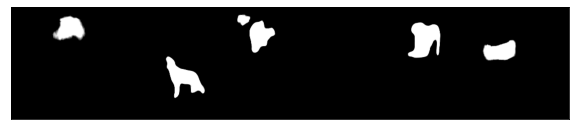



Train - Actual Depth


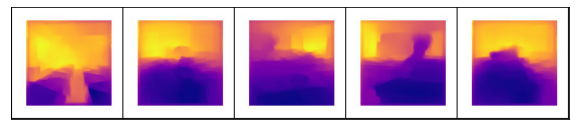

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


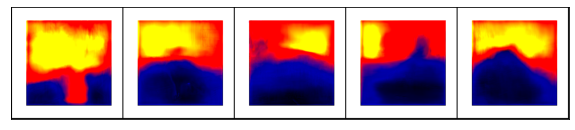

Best val loss: 0.305179
train: bce: 0.311313, dice: 0.349795, loss: 0.311313
train: bce: 0.311541, dice: 0.349638, loss: 0.311541
train: bce: 0.311290, dice: 0.348339, loss: 0.311290
train: bce: 0.311408, dice: 0.349311, loss: 0.311408
train: bce: 0.311315, dice: 0.349982, loss: 0.311315
train: bce: 0.311174, dice: 0.349861, loss: 0.311174
train: bce: 0.311429, dice: 0.351672, loss: 0.311429
train: bce: 0.311565, dice: 0.351494, loss: 0.311565
test: bce: 0.317513, dice: 0.357197, loss: 0.317513


Test - Actual mask: 84


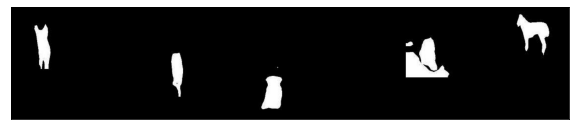

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


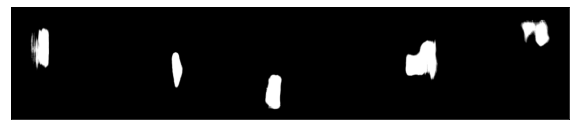



Test - Actual Depth


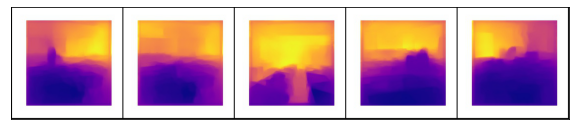

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


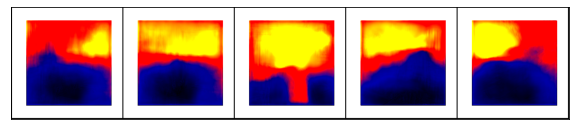

test: bce: 0.310921, dice: 0.342983, loss: 0.310921
test: bce: 0.311292, dice: 0.344201, loss: 0.311292
test: bce: 0.312325, dice: 0.348565, loss: 0.312325
************* 
Epoch: 84 	Training Loss: 0.305179 	Validation Loss: 0.312208

Validation loss decreased (0.312305 --> 0.312208).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 85/90, LR: 0.01
train: bce: 0.324959, dice: 0.426755, loss: 0.324959
train: bce: 0.312015, dice: 0.351326, loss: 0.312015
train: bce: 0.311714, dice: 0.350466, loss: 0.311714
train: bce: 0.311744, dice: 0.349917, loss: 0.311744
train: bce: 0.311708, dice: 0.350049, loss: 0.311708
train: bce: 0.311966, dice: 0.351503, loss: 0.311966
train: bce: 0.311700, dice: 0.351198, loss: 0.311700
train: bce: 0.311780, dice: 0.351249, loss: 0.311780
train: bce: 0.311779, dice: 0.351957, loss: 0.311779
test: bce: 0.320589, dice: 0.395218, loss: 0.320589
test: bce: 0.311999, dice:

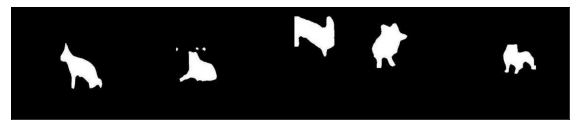

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


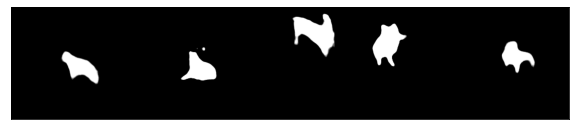



Train - Actual Depth


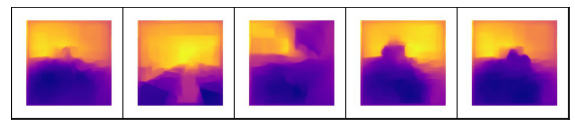

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


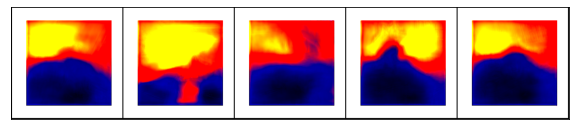

Best val loss: 0.310438
train: bce: 0.310021, dice: 0.343504, loss: 0.310021
train: bce: 0.309957, dice: 0.342274, loss: 0.309957
train: bce: 0.310752, dice: 0.343504, loss: 0.310752
train: bce: 0.310990, dice: 0.344847, loss: 0.310990
train: bce: 0.310921, dice: 0.344509, loss: 0.310921
train: bce: 0.310608, dice: 0.344763, loss: 0.310608
train: bce: 0.310602, dice: 0.345037, loss: 0.310602
train: bce: 0.310576, dice: 0.345809, loss: 0.310576
test: bce: 0.303265, dice: 0.316777, loss: 0.303265


Test - Actual mask: 88


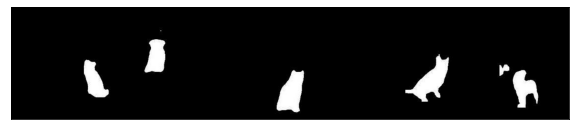

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


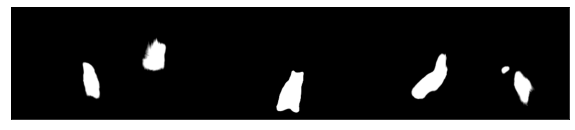



Test - Actual Depth


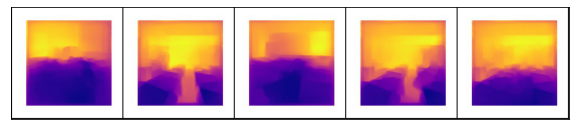

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


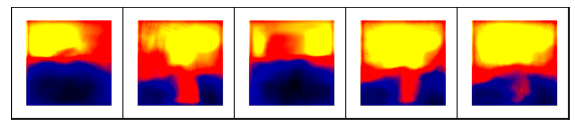

test: bce: 0.309950, dice: 0.343284, loss: 0.309950
test: bce: 0.310455, dice: 0.341118, loss: 0.310455
test: bce: 0.310058, dice: 0.339596, loss: 0.310058
************* 
Epoch: 88 	Training Loss: 0.306774 	Validation Loss: 0.310653

Validation loss decreased (0.311148 --> 0.310653).  Saving model ...
Checkpoint saved: /content/drive/My Drive/eva-4/assignment-15/assignment-15-final/saved_models/best_model.pth
>>>>>>>> 
Epoch 89/90, LR: 0.01
train: bce: 0.310773, dice: 0.326204, loss: 0.310773
train: bce: 0.309760, dice: 0.338938, loss: 0.309760
train: bce: 0.310482, dice: 0.344270, loss: 0.310482
train: bce: 0.310168, dice: 0.344618, loss: 0.310168
train: bce: 0.310103, dice: 0.343550, loss: 0.310103
train: bce: 0.309943, dice: 0.342808, loss: 0.309943
train: bce: 0.309927, dice: 0.342613, loss: 0.309927
train: bce: 0.309918, dice: 0.342993, loss: 0.309918
train: bce: 0.309894, dice: 0.343555, loss: 0.309894
test: bce: 0.323058, dice: 0.349557, loss: 0.323058
test: bce: 0.312117, dice:

In [15]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_5_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


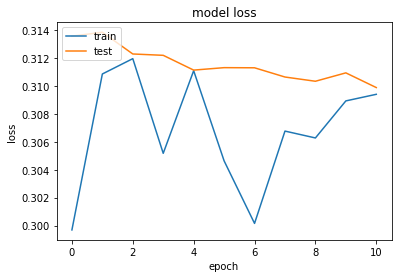

<Figure size 432x288 with 0 Axes>

time: 558 ms


In [16]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 6

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.574942, dice: 0.736778, loss: 0.574942


Train - Actual mask


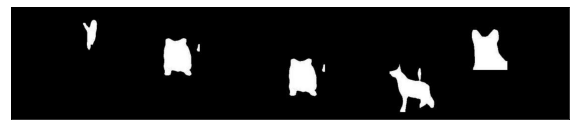

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


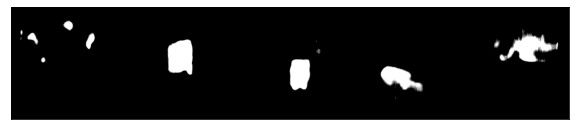



Train - Actual Depth


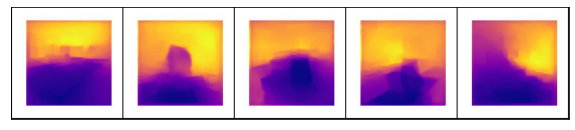

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


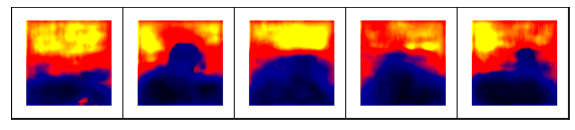

Best val loss: 0.574942
train: bce: 0.389177, dice: 0.668516, loss: 0.389177
train: bce: 0.366930, dice: 0.579506, loss: 0.366930
train: bce: 0.356229, dice: 0.535287, loss: 0.356229
train: bce: 0.349957, dice: 0.510561, loss: 0.349957
train: bce: 0.345906, dice: 0.493923, loss: 0.345906
train: bce: 0.342431, dice: 0.481167, loss: 0.342431
train: bce: 0.339714, dice: 0.470492, loss: 0.339714
train: bce: 0.337911, dice: 0.462069, loss: 0.337911
test: bce: 0.314898, dice: 0.365186, loss: 0.314898


Test - Actual mask: 92


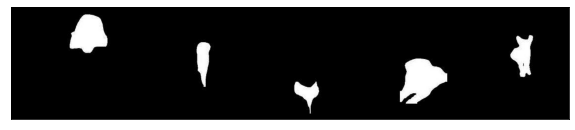

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


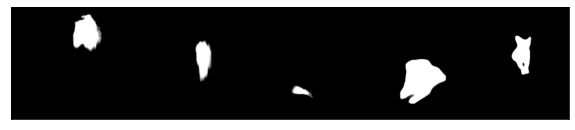



Test - Actual Depth


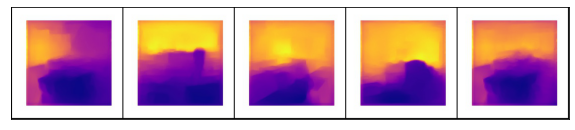

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


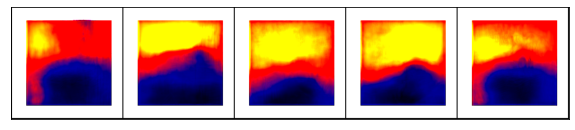

test: bce: 0.322136, dice: 0.399592, loss: 0.322136
test: bce: 0.322094, dice: 0.395820, loss: 0.322094
test: bce: 0.322060, dice: 0.396392, loss: 0.322060
************* 
Epoch: 92 	Training Loss: 0.336910 	Validation Loss: 0.322694

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.337154, dice: 0.453628, loss: 0.337154
train: bce: 0.322168, dice: 0.394589, loss: 0.322168
train: bce: 0.321595, dice: 0.390400, loss: 0.321595
train: bce: 0.322383, dice: 0.393006, loss: 0.322383
train: bce: 0.322237, dice: 0.393930, loss: 0.322237
train: bce: 0.321396, dice: 0.390957, loss: 0.321396
train: bce: 0.321448, dice: 0.390458, loss: 0.321448
train: bce: 0.321050, dice: 0.388976, loss: 0.321050
train: bce: 0.320949, dice: 0.388771, loss: 0.320949
test: bce: 0.321225, dice: 0.423848, loss: 0.321225
test: bce: 0.316542, dice: 0.372873, loss: 0.316542
test: bce: 0.316820, dice: 0.372983, loss: 0.316820
test: bce: 0.317064, dice: 0.373621, loss: 0.317064
************* 
Epoch: 93 	Training Loss: 0.32055

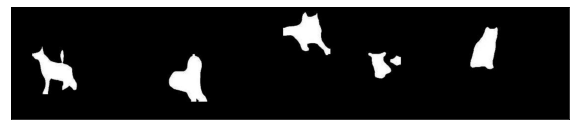

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


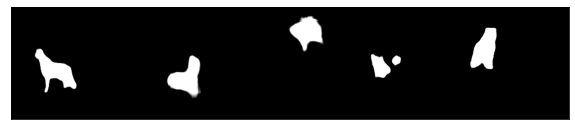



Train - Actual Depth


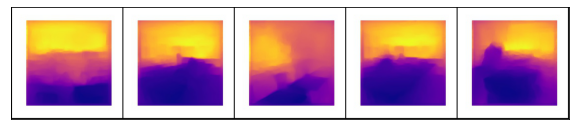

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


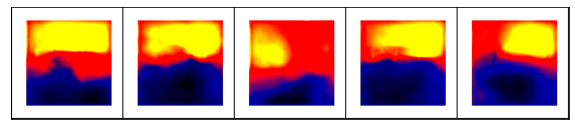

Best val loss: 0.311167
train: bce: 0.314869, dice: 0.378269, loss: 0.314869
train: bce: 0.315171, dice: 0.373838, loss: 0.315171
train: bce: 0.315721, dice: 0.372309, loss: 0.315721
train: bce: 0.315647, dice: 0.371194, loss: 0.315647
train: bce: 0.315703, dice: 0.370118, loss: 0.315703
train: bce: 0.315308, dice: 0.367746, loss: 0.315308
train: bce: 0.315321, dice: 0.367031, loss: 0.315321
train: bce: 0.315050, dice: 0.365581, loss: 0.315050
test: bce: 0.317018, dice: 0.375171, loss: 0.317018


Test - Actual mask: 96


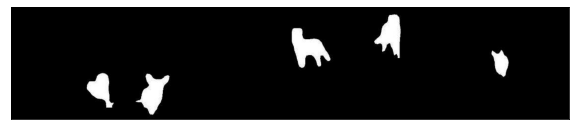

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


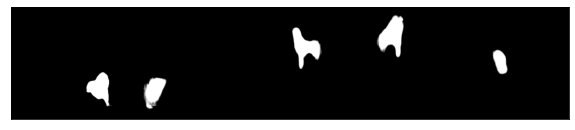



Test - Actual Depth


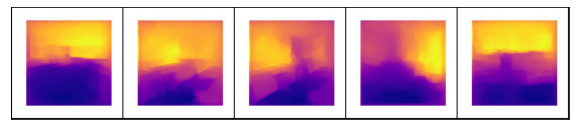



Test - Predicted Depth


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


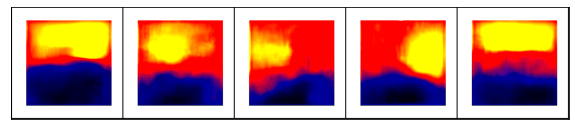

test: bce: 0.315588, dice: 0.362608, loss: 0.315588
test: bce: 0.315233, dice: 0.361794, loss: 0.315233
test: bce: 0.314602, dice: 0.360757, loss: 0.314602
************* 
Epoch: 96 	Training Loss: 0.311167 	Validation Loss: 0.314634

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.322500, dice: 0.375108, loss: 0.322500
train: bce: 0.315204, dice: 0.369332, loss: 0.315204
train: bce: 0.314567, dice: 0.364464, loss: 0.314567
train: bce: 0.313805, dice: 0.358580, loss: 0.313805
train: bce: 0.313367, dice: 0.357672, loss: 0.313367
train: bce: 0.313628, dice: 0.359931, loss: 0.313628
train: bce: 0.313764, dice: 0.359662, loss: 0.313764
train: bce: 0.313603, dice: 0.359260, loss: 0.313603
train: bce: 0.313685, dice: 0.359693, loss: 0.313685
test: bce: 0.306355, dice: 0.368709, loss: 0.306355
test: bce: 0.314471, dice: 0.360652, loss: 0.314471
test: bce: 0.313963, dice: 0.356666, loss: 0.313963
test: bce: 0.313407, dice: 0.353879, loss: 0.313407
************* 
Epoch: 97 	Training Loss: 0.31038

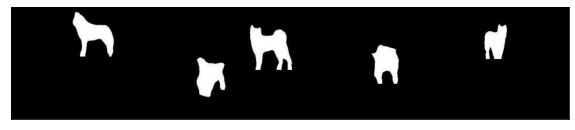

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


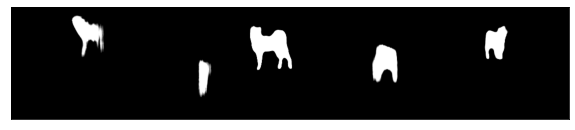



Train - Actual Depth


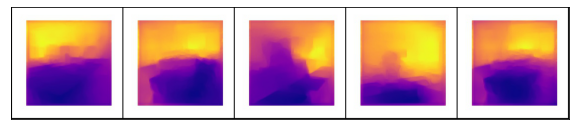

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


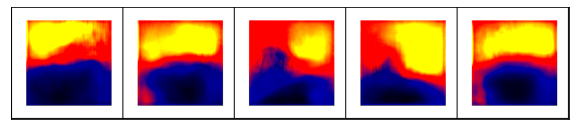

Best val loss: 0.313442
train: bce: 0.312330, dice: 0.350226, loss: 0.312330
train: bce: 0.312628, dice: 0.354738, loss: 0.312628
train: bce: 0.312581, dice: 0.353435, loss: 0.312581
train: bce: 0.311934, dice: 0.352977, loss: 0.311934
train: bce: 0.312284, dice: 0.352244, loss: 0.312284
train: bce: 0.312311, dice: 0.351921, loss: 0.312311
train: bce: 0.312204, dice: 0.352124, loss: 0.312204
train: bce: 0.312102, dice: 0.352379, loss: 0.312102
test: bce: 0.317713, dice: 0.331828, loss: 0.317713


Test - Actual mask: 100


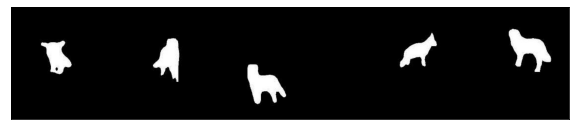

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


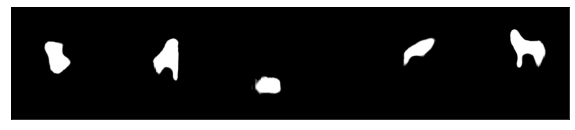



Test - Actual Depth


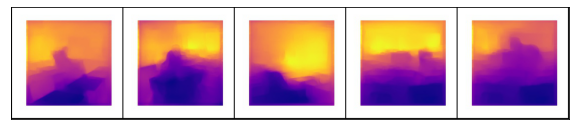

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


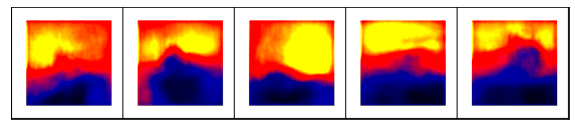

test: bce: 0.312393, dice: 0.349213, loss: 0.312393
test: bce: 0.310962, dice: 0.344020, loss: 0.310962
test: bce: 0.311314, dice: 0.345294, loss: 0.311314
************* 
Epoch: 100 	Training Loss: 0.307712 	Validation Loss: 0.311140

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.306747, dice: 0.361257, loss: 0.306747
train: bce: 0.310302, dice: 0.346555, loss: 0.310302
train: bce: 0.310827, dice: 0.349117, loss: 0.310827
train: bce: 0.311156, dice: 0.348442, loss: 0.311156
train: bce: 0.311938, dice: 0.350746, loss: 0.311938
train: bce: 0.311491, dice: 0.349066, loss: 0.311491
train: bce: 0.311370, dice: 0.347844, loss: 0.311370
train: bce: 0.311281, dice: 0.347976, loss: 0.311281
train: bce: 0.311100, dice: 0.347501, loss: 0.311100
test: bce: 0.319217, dice: 0.395761, loss: 0.319217
test: bce: 0.311205, dice: 0.344345, loss: 0.311205
test: bce: 0.310917, dice: 0.343010, loss: 0.310917
test: bce: 0.311247, dice: 0.344893, loss: 0.311247
************* 
Epoch: 101 	Training Loss: 0.30

In [17]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_6_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


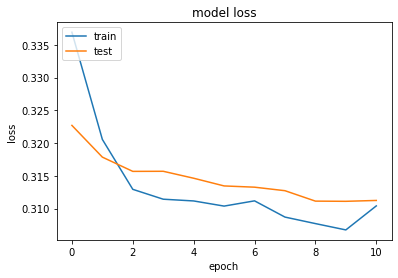

<Figure size 432x288 with 0 Axes>

time: 243 ms


In [18]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 7

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.600300, dice: 0.832563, loss: 0.600300


Train - Actual mask


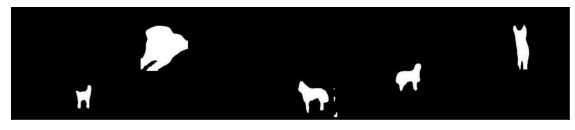

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


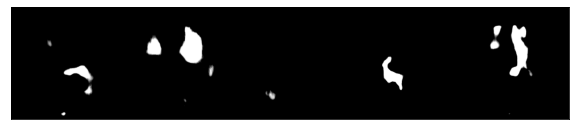



Train - Actual Depth


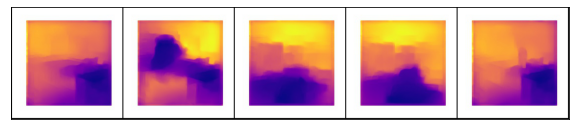

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


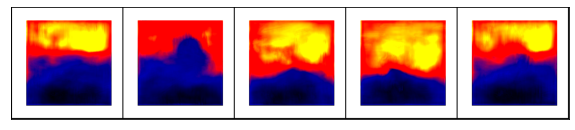

Best val loss: 0.600300
train: bce: 0.421404, dice: 0.699183, loss: 0.421404
train: bce: 0.394441, dice: 0.608472, loss: 0.394441
train: bce: 0.381762, dice: 0.561182, loss: 0.381762
train: bce: 0.374543, dice: 0.533713, loss: 0.374543
train: bce: 0.368879, dice: 0.513994, loss: 0.368879
train: bce: 0.365129, dice: 0.501035, loss: 0.365129
train: bce: 0.362646, dice: 0.490762, loss: 0.362646
train: bce: 0.360054, dice: 0.480282, loss: 0.360054
test: bce: 0.354881, dice: 0.409182, loss: 0.354881


Test - Actual mask: 92


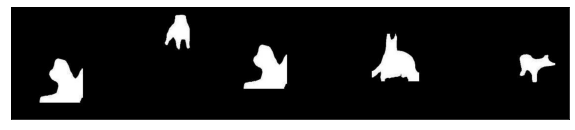

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


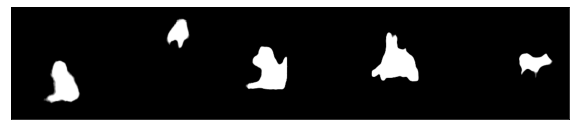



Test - Actual Depth


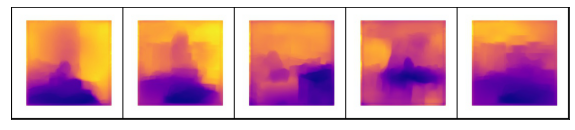

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


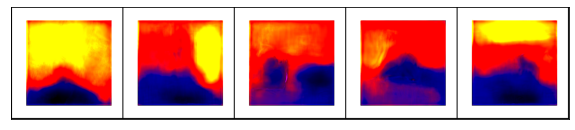

test: bce: 0.341155, dice: 0.400972, loss: 0.341155
test: bce: 0.342952, dice: 0.407468, loss: 0.342952
test: bce: 0.342564, dice: 0.409174, loss: 0.342564
************* 
Epoch: 92 	Training Loss: 0.358618 	Validation Loss: 0.341525

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.338436, dice: 0.427497, loss: 0.338436
train: bce: 0.344297, dice: 0.415357, loss: 0.344297
train: bce: 0.342318, dice: 0.412320, loss: 0.342318
train: bce: 0.341334, dice: 0.407615, loss: 0.341334
train: bce: 0.340681, dice: 0.406315, loss: 0.340681
train: bce: 0.340384, dice: 0.405608, loss: 0.340384
train: bce: 0.340264, dice: 0.403530, loss: 0.340264
train: bce: 0.339988, dice: 0.401272, loss: 0.339988
train: bce: 0.339686, dice: 0.400437, loss: 0.339686
test: bce: 0.329486, dice: 0.358207, loss: 0.329486
test: bce: 0.335121, dice: 0.380365, loss: 0.335121
test: bce: 0.334726, dice: 0.382255, loss: 0.334726
test: bce: 0.334824, dice: 0.384492, loss: 0.334824
************* 
Epoch: 93 	Training Loss: 0.33843

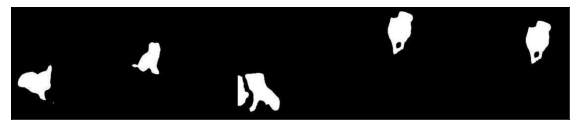

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


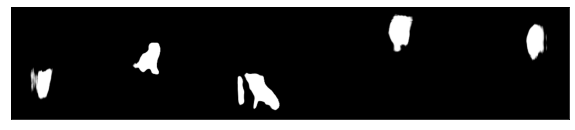



Train - Actual Depth


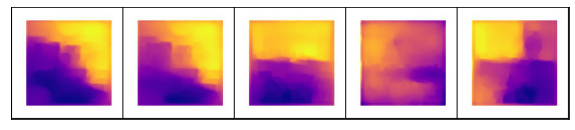

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


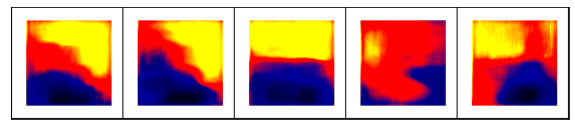

Best val loss: 0.336467
train: bce: 0.331223, dice: 0.377329, loss: 0.331223
train: bce: 0.331783, dice: 0.375021, loss: 0.331783
train: bce: 0.331710, dice: 0.373650, loss: 0.331710
train: bce: 0.332608, dice: 0.374840, loss: 0.332608
train: bce: 0.332750, dice: 0.374354, loss: 0.332750
train: bce: 0.332369, dice: 0.372125, loss: 0.332369
train: bce: 0.332375, dice: 0.371442, loss: 0.332375
train: bce: 0.332508, dice: 0.372076, loss: 0.332508
test: bce: 0.325161, dice: 0.418990, loss: 0.325161


Test - Actual mask: 96


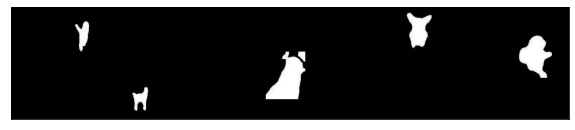

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


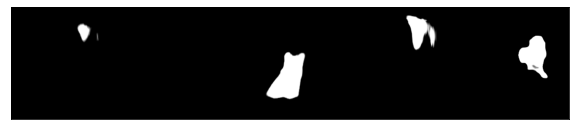



Test - Actual Depth


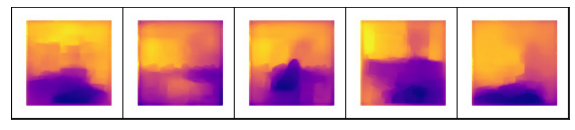



Test - Predicted Depth


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


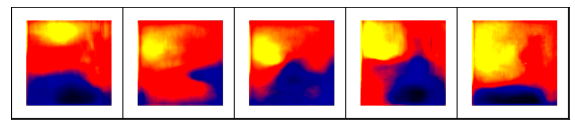

test: bce: 0.329605, dice: 0.375584, loss: 0.329605
test: bce: 0.331746, dice: 0.375295, loss: 0.331746
test: bce: 0.331598, dice: 0.373069, loss: 0.331598
************* 
Epoch: 96 	Training Loss: 0.330274 	Validation Loss: 0.331491

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.336421, dice: 0.423501, loss: 0.336421
train: bce: 0.333931, dice: 0.373099, loss: 0.333931
train: bce: 0.332866, dice: 0.371615, loss: 0.332866
train: bce: 0.332538, dice: 0.374169, loss: 0.332538
train: bce: 0.332597, dice: 0.373303, loss: 0.332597
train: bce: 0.332378, dice: 0.372726, loss: 0.332378
train: bce: 0.332139, dice: 0.371410, loss: 0.332139
train: bce: 0.332080, dice: 0.370128, loss: 0.332080
train: bce: 0.331889, dice: 0.368642, loss: 0.331889
test: bce: 0.327552, dice: 0.359122, loss: 0.327552
test: bce: 0.331132, dice: 0.370868, loss: 0.331132
test: bce: 0.331815, dice: 0.370502, loss: 0.331815
test: bce: 0.331757, dice: 0.370831, loss: 0.331757
************* 
Epoch: 97 	Training Loss: 0.32304

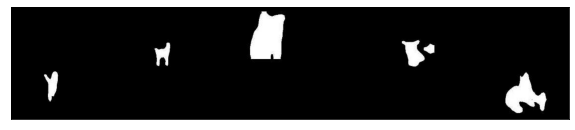

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


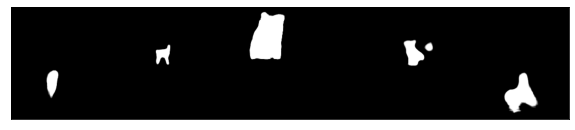



Train - Actual Depth


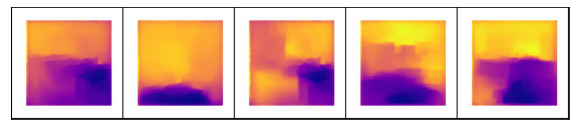

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


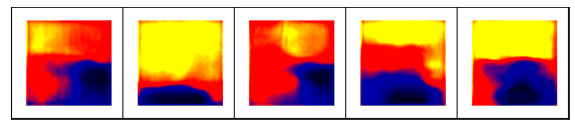

Best val loss: 0.329903
train: bce: 0.328317, dice: 0.363042, loss: 0.328317
train: bce: 0.329305, dice: 0.359237, loss: 0.329305
train: bce: 0.329633, dice: 0.361367, loss: 0.329633
train: bce: 0.329527, dice: 0.361214, loss: 0.329527
train: bce: 0.329635, dice: 0.361968, loss: 0.329635
train: bce: 0.329640, dice: 0.362051, loss: 0.329640
train: bce: 0.329631, dice: 0.361277, loss: 0.329631
train: bce: 0.329558, dice: 0.360209, loss: 0.329558
test: bce: 0.339273, dice: 0.370635, loss: 0.339273


Test - Actual mask: 100


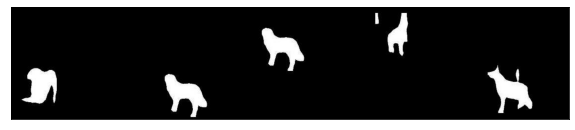

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


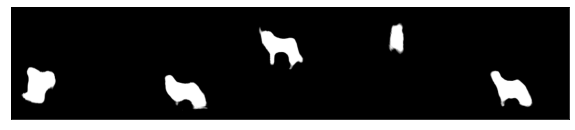



Test - Actual Depth


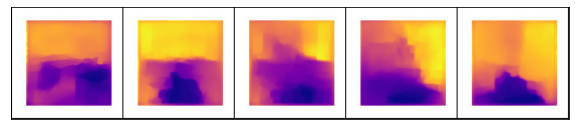



Test - Predicted Depth


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


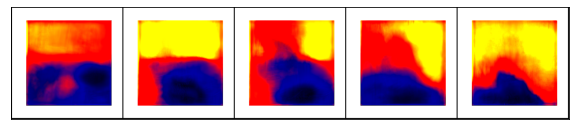

test: bce: 0.326858, dice: 0.354107, loss: 0.326858
test: bce: 0.327716, dice: 0.357486, loss: 0.327716
test: bce: 0.328279, dice: 0.358126, loss: 0.328279
************* 
Epoch: 100 	Training Loss: 0.324742 	Validation Loss: 0.328862

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.317380, dice: 0.352400, loss: 0.317380
train: bce: 0.330710, dice: 0.363269, loss: 0.330710
train: bce: 0.330179, dice: 0.358874, loss: 0.330179
train: bce: 0.329686, dice: 0.359960, loss: 0.329686
train: bce: 0.329752, dice: 0.358981, loss: 0.329752
train: bce: 0.329321, dice: 0.358270, loss: 0.329321
train: bce: 0.329174, dice: 0.357204, loss: 0.329174
train: bce: 0.329074, dice: 0.356572, loss: 0.329074
train: bce: 0.328899, dice: 0.356932, loss: 0.328899
test: bce: 0.337934, dice: 0.381261, loss: 0.337934
test: bce: 0.329058, dice: 0.359935, loss: 0.329058
test: bce: 0.328677, dice: 0.357996, loss: 0.328677
test: bce: 0.328788, dice: 0.358048, loss: 0.328788
************* 
Epoch: 101 	Training Loss: 0.31

In [19]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_7_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


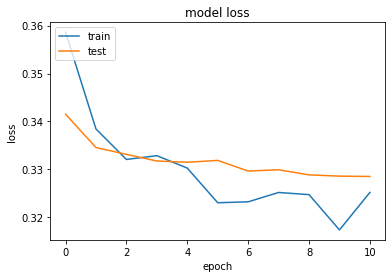

<Figure size 432x288 with 0 Axes>

time: 219 ms


In [20]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 8

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.699733, dice: 0.828566, loss: 0.699733


Train - Actual mask


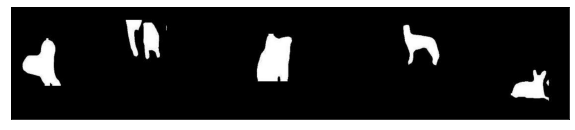

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


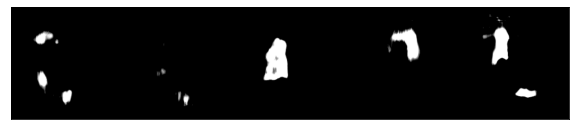



Train - Actual Depth


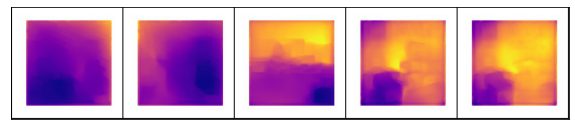

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


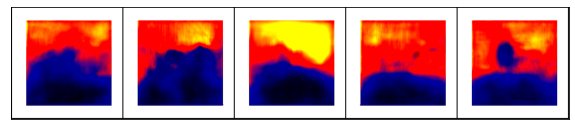

Best val loss: 0.699733
train: bce: 0.434526, dice: 0.703088, loss: 0.434526
train: bce: 0.407592, dice: 0.624078, loss: 0.407592
train: bce: 0.394611, dice: 0.579559, loss: 0.394611
train: bce: 0.387519, dice: 0.556403, loss: 0.387519
train: bce: 0.382059, dice: 0.537541, loss: 0.382059
train: bce: 0.377877, dice: 0.522521, loss: 0.377877
train: bce: 0.374623, dice: 0.509190, loss: 0.374623
train: bce: 0.372380, dice: 0.501969, loss: 0.372380
test: bce: 0.331426, dice: 0.323908, loss: 0.331426


Test - Actual mask: 92


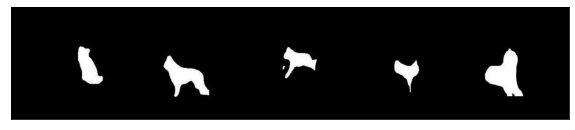

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


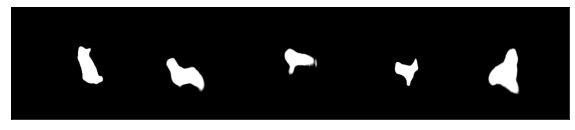



Test - Actual Depth


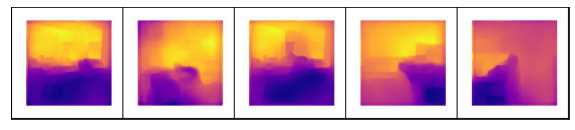

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


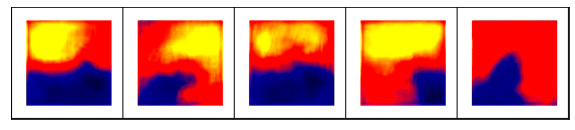

test: bce: 0.348991, dice: 0.415792, loss: 0.348991
test: bce: 0.350777, dice: 0.422155, loss: 0.350777
test: bce: 0.350929, dice: 0.420513, loss: 0.350929
************* 
Epoch: 92 	Training Loss: 0.370767 	Validation Loss: 0.350621

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.355098, dice: 0.408767, loss: 0.355098
train: bce: 0.354315, dice: 0.422996, loss: 0.354315
train: bce: 0.353550, dice: 0.426002, loss: 0.353550
train: bce: 0.352250, dice: 0.423673, loss: 0.352250
train: bce: 0.351742, dice: 0.421903, loss: 0.351742
train: bce: 0.351301, dice: 0.419729, loss: 0.351301
train: bce: 0.350939, dice: 0.418386, loss: 0.350939
train: bce: 0.350097, dice: 0.416496, loss: 0.350097
train: bce: 0.349668, dice: 0.415051, loss: 0.349668
test: bce: 0.341668, dice: 0.381818, loss: 0.341668
test: bce: 0.346263, dice: 0.395654, loss: 0.346263
test: bce: 0.346588, dice: 0.397778, loss: 0.346588
test: bce: 0.345601, dice: 0.396333, loss: 0.345601
************* 
Epoch: 93 	Training Loss: 0.34943

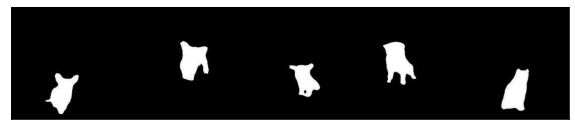

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


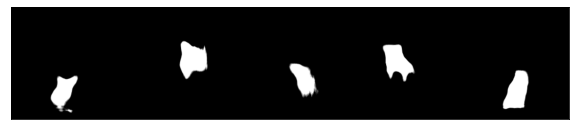



Train - Actual Depth


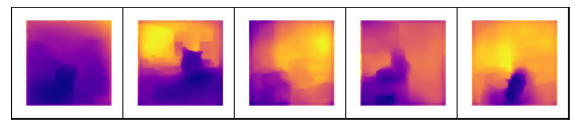

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


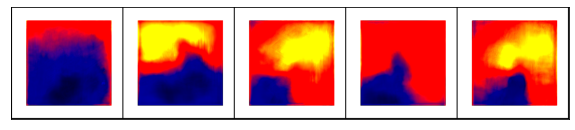

Best val loss: 0.338064
train: bce: 0.342162, dice: 0.383938, loss: 0.342162
train: bce: 0.343754, dice: 0.388412, loss: 0.343754
train: bce: 0.343541, dice: 0.389285, loss: 0.343541
train: bce: 0.343361, dice: 0.389242, loss: 0.343361
train: bce: 0.343289, dice: 0.389757, loss: 0.343289
train: bce: 0.343311, dice: 0.390169, loss: 0.343311
train: bce: 0.343228, dice: 0.389534, loss: 0.343228
train: bce: 0.342871, dice: 0.387725, loss: 0.342871
test: bce: 0.336742, dice: 0.350507, loss: 0.336742


Test - Actual mask: 96


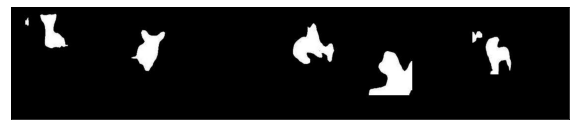

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


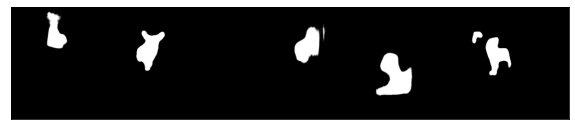



Test - Actual Depth


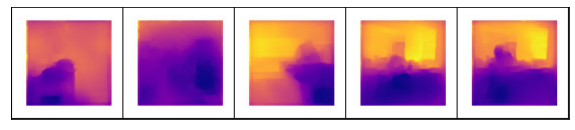

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


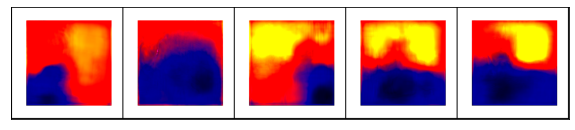

test: bce: 0.342964, dice: 0.387595, loss: 0.342964
test: bce: 0.341876, dice: 0.380698, loss: 0.341876
test: bce: 0.341943, dice: 0.376764, loss: 0.341943
************* 
Epoch: 96 	Training Loss: 0.338064 	Validation Loss: 0.342178

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.351183, dice: 0.376168, loss: 0.351183
train: bce: 0.341676, dice: 0.381151, loss: 0.341676
train: bce: 0.341607, dice: 0.384278, loss: 0.341607
train: bce: 0.341550, dice: 0.383637, loss: 0.341550
train: bce: 0.341509, dice: 0.382630, loss: 0.341509
train: bce: 0.341693, dice: 0.381353, loss: 0.341693
train: bce: 0.341528, dice: 0.382327, loss: 0.341528
train: bce: 0.341337, dice: 0.381168, loss: 0.341337
train: bce: 0.341531, dice: 0.381144, loss: 0.341531
test: bce: 0.339238, dice: 0.362612, loss: 0.339238
test: bce: 0.342238, dice: 0.366550, loss: 0.342238
test: bce: 0.340405, dice: 0.367393, loss: 0.340405
test: bce: 0.340447, dice: 0.369453, loss: 0.340447
************* 
Epoch: 97 	Training Loss: 0.34006

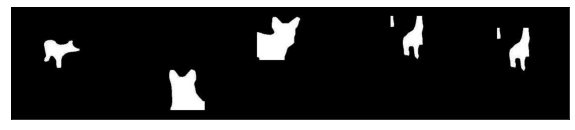

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


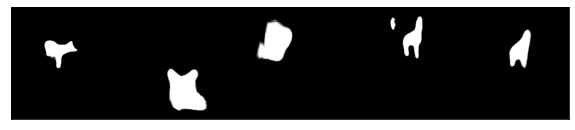



Train - Actual Depth


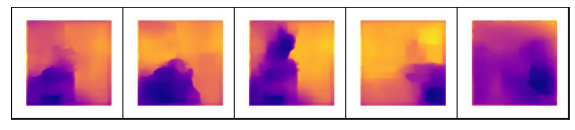

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


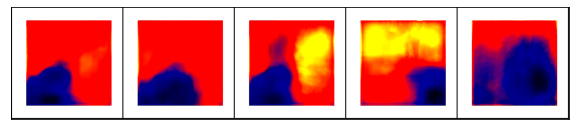

Best val loss: 0.337748
train: bce: 0.339936, dice: 0.372759, loss: 0.339936
train: bce: 0.338961, dice: 0.370346, loss: 0.338961
train: bce: 0.338707, dice: 0.371374, loss: 0.338707
train: bce: 0.339188, dice: 0.372918, loss: 0.339188
train: bce: 0.339125, dice: 0.371526, loss: 0.339125
train: bce: 0.339219, dice: 0.372263, loss: 0.339219
train: bce: 0.339456, dice: 0.372046, loss: 0.339456
train: bce: 0.339469, dice: 0.371846, loss: 0.339469
test: bce: 0.334038, dice: 0.362112, loss: 0.334038


Test - Actual mask: 100


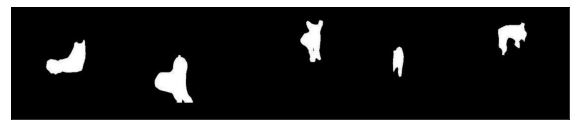

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


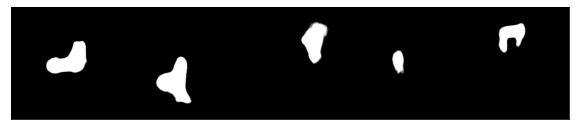



Test - Actual Depth


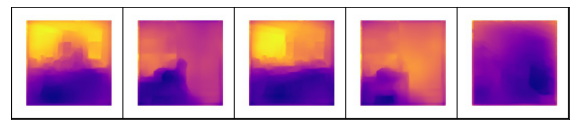

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


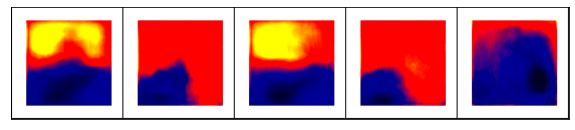

test: bce: 0.338947, dice: 0.363019, loss: 0.338947
test: bce: 0.338949, dice: 0.365381, loss: 0.338949
test: bce: 0.338804, dice: 0.363872, loss: 0.338804
************* 
Epoch: 100 	Training Loss: 0.337409 	Validation Loss: 0.338565

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.330989, dice: 0.344754, loss: 0.330989
train: bce: 0.340011, dice: 0.376445, loss: 0.340011
train: bce: 0.340460, dice: 0.376377, loss: 0.340460
train: bce: 0.339883, dice: 0.372346, loss: 0.339883
train: bce: 0.340121, dice: 0.372634, loss: 0.340121
train: bce: 0.339667, dice: 0.372339, loss: 0.339667
train: bce: 0.339206, dice: 0.371278, loss: 0.339206
train: bce: 0.339209, dice: 0.371005, loss: 0.339209
train: bce: 0.339183, dice: 0.370870, loss: 0.339183
test: bce: 0.330372, dice: 0.320225, loss: 0.330372
test: bce: 0.338804, dice: 0.367518, loss: 0.338804
test: bce: 0.337724, dice: 0.367864, loss: 0.337724
test: bce: 0.337867, dice: 0.367418, loss: 0.337867
************* 
Epoch: 101 	Training Loss: 0.33

In [21]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_8_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


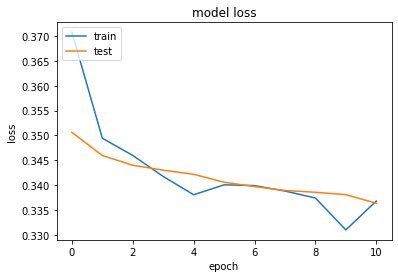

<Figure size 432x288 with 0 Axes>

time: 263 ms


In [22]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 9

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.696729, dice: 0.838765, loss: 0.696729


Train - Actual mask


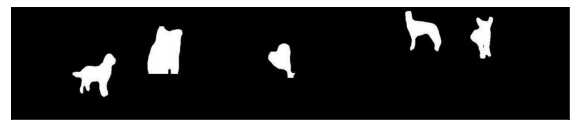

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


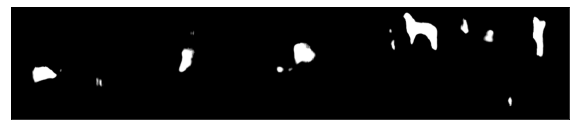



Train - Actual Depth


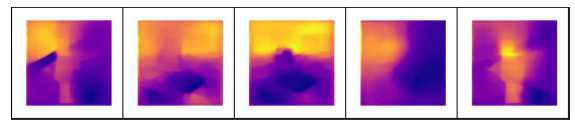

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


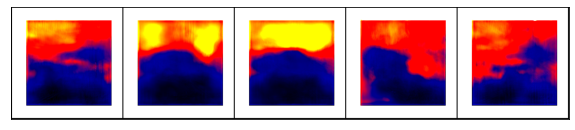

Best val loss: 0.696729
train: bce: 0.418277, dice: 0.702723, loss: 0.418277
train: bce: 0.393374, dice: 0.617756, loss: 0.393374
train: bce: 0.382179, dice: 0.572058, loss: 0.382179
train: bce: 0.374366, dice: 0.544237, loss: 0.374366
train: bce: 0.369758, dice: 0.526788, loss: 0.369758
train: bce: 0.365838, dice: 0.513790, loss: 0.365838
train: bce: 0.362859, dice: 0.500965, loss: 0.362859
train: bce: 0.360914, dice: 0.492673, loss: 0.360914
test: bce: 0.352944, dice: 0.470055, loss: 0.352944


Test - Actual mask: 92


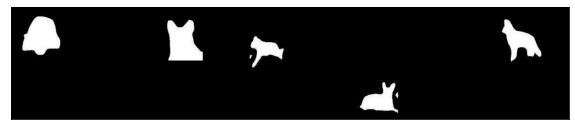

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


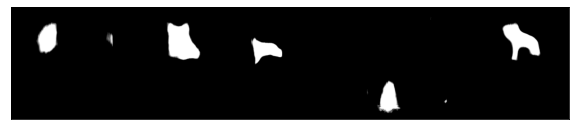



Test - Actual Depth


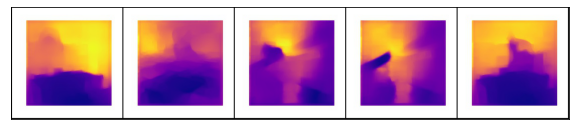

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


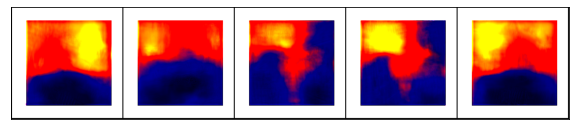

test: bce: 0.344121, dice: 0.420443, loss: 0.344121
test: bce: 0.345822, dice: 0.423110, loss: 0.345822
test: bce: 0.344898, dice: 0.418737, loss: 0.344898
************* 
Epoch: 92 	Training Loss: 0.359604 	Validation Loss: 0.344729

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.325575, dice: 0.372692, loss: 0.325575
train: bce: 0.344132, dice: 0.423869, loss: 0.344132
train: bce: 0.342197, dice: 0.421659, loss: 0.342197
train: bce: 0.341694, dice: 0.419750, loss: 0.341694
train: bce: 0.341879, dice: 0.419508, loss: 0.341879
train: bce: 0.341417, dice: 0.418450, loss: 0.341417
train: bce: 0.340677, dice: 0.416651, loss: 0.340677
train: bce: 0.340249, dice: 0.415459, loss: 0.340249
train: bce: 0.340278, dice: 0.415184, loss: 0.340278
test: bce: 0.332129, dice: 0.385713, loss: 0.332129
test: bce: 0.338729, dice: 0.417962, loss: 0.338729
test: bce: 0.337928, dice: 0.415656, loss: 0.337928
test: bce: 0.337453, dice: 0.414158, loss: 0.337453
************* 
Epoch: 93 	Training Loss: 0.32557

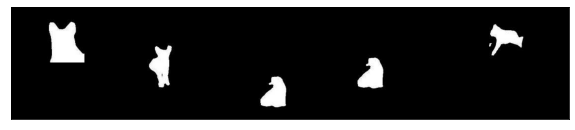

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


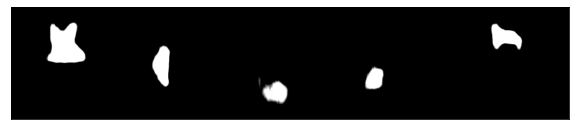



Train - Actual Depth


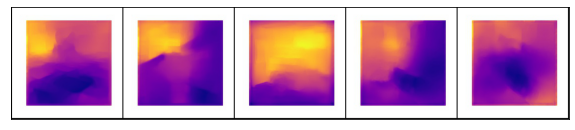

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


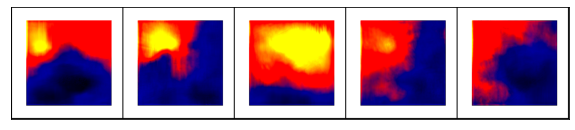

Best val loss: 0.334972
train: bce: 0.333133, dice: 0.384974, loss: 0.333133
train: bce: 0.333825, dice: 0.384813, loss: 0.333825
train: bce: 0.332690, dice: 0.382306, loss: 0.332690
train: bce: 0.332822, dice: 0.381967, loss: 0.332822
train: bce: 0.332462, dice: 0.381450, loss: 0.332462
train: bce: 0.332502, dice: 0.382355, loss: 0.332502
train: bce: 0.332505, dice: 0.383332, loss: 0.332505
train: bce: 0.332562, dice: 0.383451, loss: 0.332562
test: bce: 0.327117, dice: 0.374613, loss: 0.327117


Test - Actual mask: 96


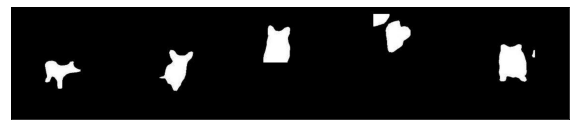

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


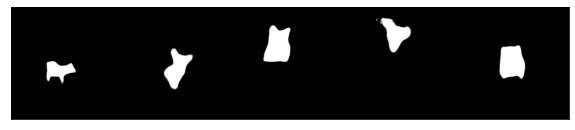



Test - Actual Depth


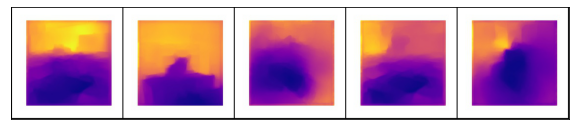

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


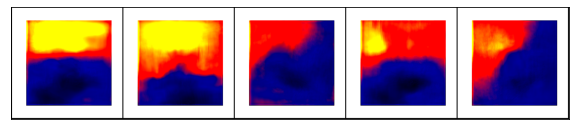

test: bce: 0.331324, dice: 0.381682, loss: 0.331324
test: bce: 0.331513, dice: 0.382967, loss: 0.331513
test: bce: 0.332025, dice: 0.382083, loss: 0.332025
************* 
Epoch: 96 	Training Loss: 0.327437 	Validation Loss: 0.332776

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.336319, dice: 0.386635, loss: 0.336319
train: bce: 0.329857, dice: 0.376587, loss: 0.329857
train: bce: 0.330515, dice: 0.377620, loss: 0.330515
train: bce: 0.330683, dice: 0.377018, loss: 0.330683
train: bce: 0.332063, dice: 0.380705, loss: 0.332063
train: bce: 0.331717, dice: 0.380270, loss: 0.331717
train: bce: 0.331997, dice: 0.379624, loss: 0.331997
train: bce: 0.331954, dice: 0.380684, loss: 0.331954
train: bce: 0.331808, dice: 0.381244, loss: 0.331808
test: bce: 0.332105, dice: 0.409004, loss: 0.332105
test: bce: 0.331272, dice: 0.385874, loss: 0.331272
test: bce: 0.331878, dice: 0.387654, loss: 0.331878
test: bce: 0.331267, dice: 0.384751, loss: 0.331267
************* 
Epoch: 97 	Training Loss: 0.32603

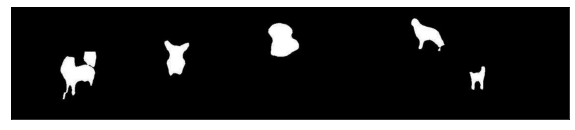

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


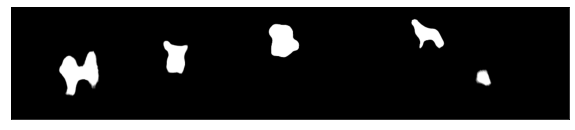



Train - Actual Depth


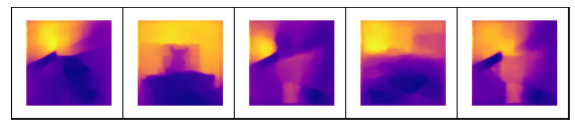

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


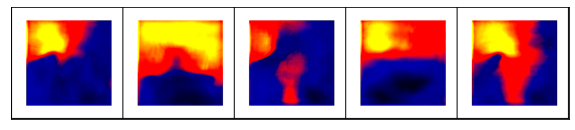

Best val loss: 0.323736
train: bce: 0.329156, dice: 0.371657, loss: 0.329156
train: bce: 0.329416, dice: 0.370964, loss: 0.329416
train: bce: 0.329113, dice: 0.371917, loss: 0.329113
train: bce: 0.328952, dice: 0.368960, loss: 0.328952
train: bce: 0.329021, dice: 0.367581, loss: 0.329021
train: bce: 0.329294, dice: 0.369531, loss: 0.329294
train: bce: 0.329333, dice: 0.369279, loss: 0.329333
train: bce: 0.328965, dice: 0.368414, loss: 0.328965
test: bce: 0.349149, dice: 0.325632, loss: 0.349149


Test - Actual mask: 100


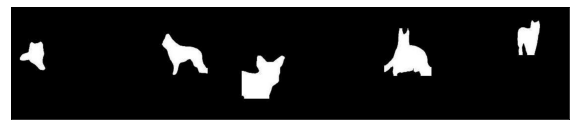

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


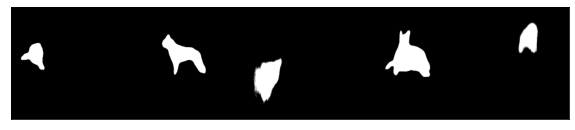



Test - Actual Depth


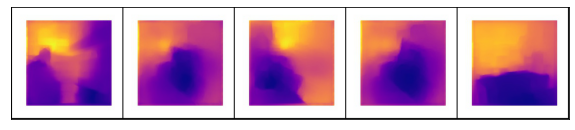

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


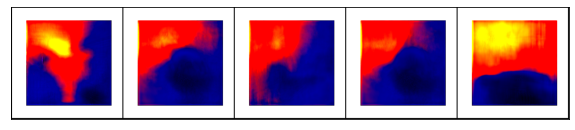

test: bce: 0.329750, dice: 0.381561, loss: 0.329750
test: bce: 0.329026, dice: 0.378658, loss: 0.329026
test: bce: 0.328564, dice: 0.376064, loss: 0.328564
************* 
Epoch: 100 	Training Loss: 0.323365 	Validation Loss: 0.328457

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.327557, dice: 0.359577, loss: 0.327557
train: bce: 0.330282, dice: 0.367219, loss: 0.330282
train: bce: 0.329478, dice: 0.371052, loss: 0.329478
train: bce: 0.329409, dice: 0.370169, loss: 0.329409
train: bce: 0.329128, dice: 0.368161, loss: 0.329128
train: bce: 0.329034, dice: 0.368319, loss: 0.329034
train: bce: 0.329033, dice: 0.368463, loss: 0.329033
train: bce: 0.328706, dice: 0.367207, loss: 0.328706
train: bce: 0.328453, dice: 0.366692, loss: 0.328453
test: bce: 0.343733, dice: 0.390694, loss: 0.343733
test: bce: 0.328890, dice: 0.363145, loss: 0.328890
test: bce: 0.328002, dice: 0.363023, loss: 0.328002
test: bce: 0.328063, dice: 0.365376, loss: 0.328063
************* 
Epoch: 101 	Training Loss: 0.32

In [17]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_9_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


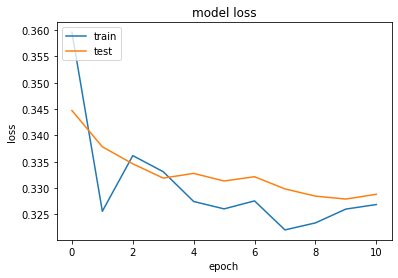

<Figure size 432x288 with 0 Axes>

time: 493 ms


In [18]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 10

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.637055, dice: 0.813375, loss: 0.637055


Train - Actual mask


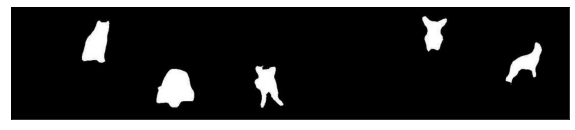

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


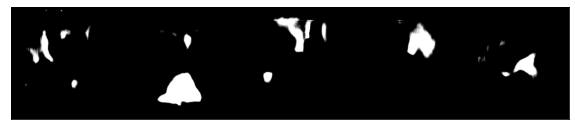



Train - Actual Depth


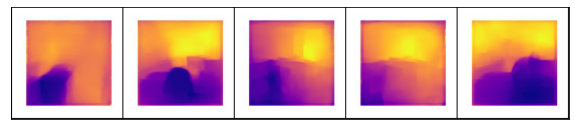

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


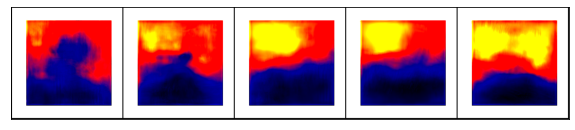

Best val loss: 0.637055
train: bce: 0.422897, dice: 0.707253, loss: 0.422897
train: bce: 0.397628, dice: 0.621188, loss: 0.397628
train: bce: 0.385382, dice: 0.577081, loss: 0.385382
train: bce: 0.377958, dice: 0.549498, loss: 0.377958
train: bce: 0.372869, dice: 0.529655, loss: 0.372869
train: bce: 0.368852, dice: 0.514336, loss: 0.368852
train: bce: 0.366202, dice: 0.504546, loss: 0.366202
train: bce: 0.364068, dice: 0.495126, loss: 0.364068
test: bce: 0.345696, dice: 0.501769, loss: 0.345696


Test - Actual mask: 92


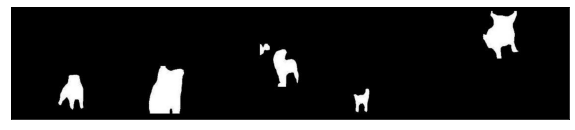

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


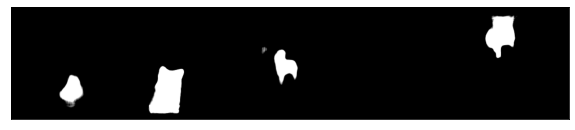



Test - Actual Depth


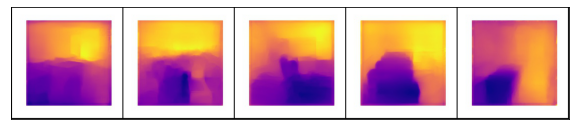

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


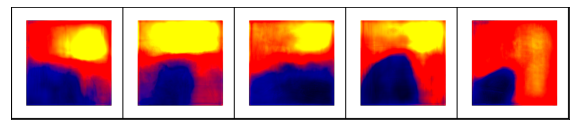

test: bce: 0.344683, dice: 0.430844, loss: 0.344683
test: bce: 0.343777, dice: 0.426040, loss: 0.343777
test: bce: 0.344360, dice: 0.424456, loss: 0.344360
************* 
Epoch: 92 	Training Loss: 0.362615 	Validation Loss: 0.344441

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.332491, dice: 0.395898, loss: 0.332491
train: bce: 0.345062, dice: 0.419464, loss: 0.345062
train: bce: 0.342737, dice: 0.413587, loss: 0.342737
train: bce: 0.342204, dice: 0.412051, loss: 0.342204
train: bce: 0.342166, dice: 0.409279, loss: 0.342166
train: bce: 0.342608, dice: 0.411318, loss: 0.342608
train: bce: 0.342502, dice: 0.411679, loss: 0.342502
train: bce: 0.342468, dice: 0.410613, loss: 0.342468
train: bce: 0.342373, dice: 0.409508, loss: 0.342373
test: bce: 0.337754, dice: 0.407067, loss: 0.337754
test: bce: 0.338749, dice: 0.389917, loss: 0.338749
test: bce: 0.339041, dice: 0.393274, loss: 0.339041
test: bce: 0.339206, dice: 0.394520, loss: 0.339206
************* 
Epoch: 93 	Training Loss: 0.33249

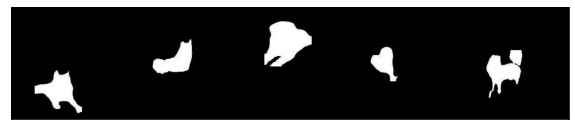

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


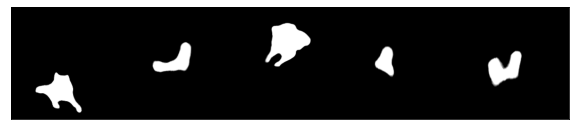



Train - Actual Depth


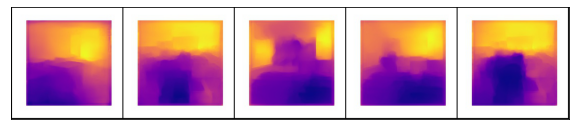

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


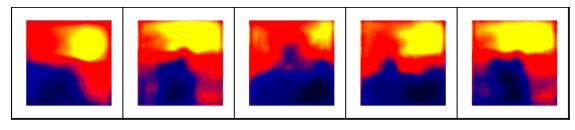

Best val loss: 0.322132
train: bce: 0.337382, dice: 0.386320, loss: 0.337382
train: bce: 0.337052, dice: 0.389974, loss: 0.337052
train: bce: 0.336302, dice: 0.386845, loss: 0.336302
train: bce: 0.336104, dice: 0.386236, loss: 0.336104
train: bce: 0.336006, dice: 0.384505, loss: 0.336006
train: bce: 0.335975, dice: 0.384677, loss: 0.335975
train: bce: 0.335913, dice: 0.383629, loss: 0.335913
train: bce: 0.335737, dice: 0.382844, loss: 0.335737
test: bce: 0.327168, dice: 0.385675, loss: 0.327168


Test - Actual mask: 96


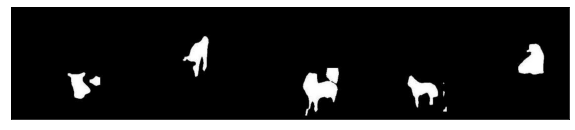

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


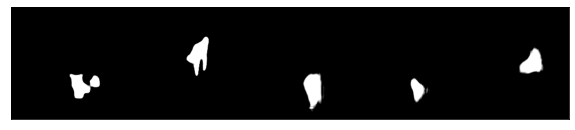



Test - Actual Depth


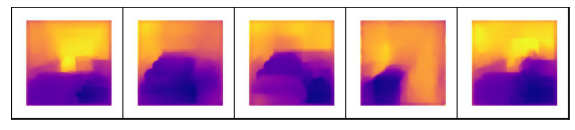

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


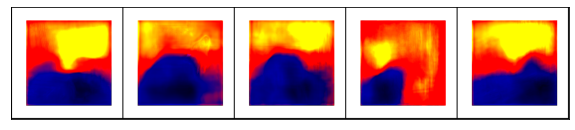

test: bce: 0.334996, dice: 0.370373, loss: 0.334996
test: bce: 0.334600, dice: 0.368122, loss: 0.334600
test: bce: 0.334394, dice: 0.367681, loss: 0.334394
************* 
Epoch: 96 	Training Loss: 0.322132 	Validation Loss: 0.334032

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.336358, dice: 0.399341, loss: 0.336358
train: bce: 0.335585, dice: 0.384439, loss: 0.335585
train: bce: 0.334946, dice: 0.381786, loss: 0.334946
train: bce: 0.334901, dice: 0.379762, loss: 0.334901
train: bce: 0.334958, dice: 0.377391, loss: 0.334958
train: bce: 0.334566, dice: 0.376696, loss: 0.334566
train: bce: 0.334378, dice: 0.375874, loss: 0.334378
train: bce: 0.334206, dice: 0.375235, loss: 0.334206
train: bce: 0.334102, dice: 0.375343, loss: 0.334102
test: bce: 0.330716, dice: 0.374866, loss: 0.330716
test: bce: 0.331964, dice: 0.376073, loss: 0.331964
test: bce: 0.333802, dice: 0.378679, loss: 0.333802
test: bce: 0.334542, dice: 0.380380, loss: 0.334542
************* 
Epoch: 97 	Training Loss: 0.33374

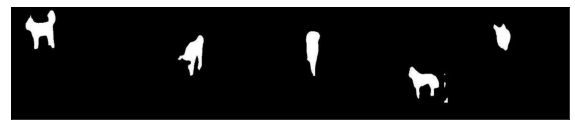

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


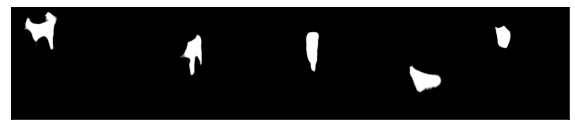



Train - Actual Depth


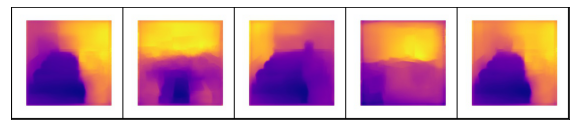

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


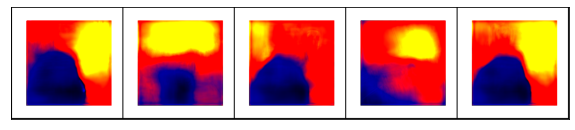

Best val loss: 0.347766
train: bce: 0.333241, dice: 0.366313, loss: 0.333241
train: bce: 0.332859, dice: 0.367258, loss: 0.332859
train: bce: 0.332044, dice: 0.364533, loss: 0.332044
train: bce: 0.331481, dice: 0.362766, loss: 0.331481
train: bce: 0.331605, dice: 0.364039, loss: 0.331605
train: bce: 0.331591, dice: 0.363692, loss: 0.331591
train: bce: 0.331810, dice: 0.365219, loss: 0.331810
train: bce: 0.332005, dice: 0.365401, loss: 0.332005
test: bce: 0.335171, dice: 0.359978, loss: 0.335171


Test - Actual mask: 100


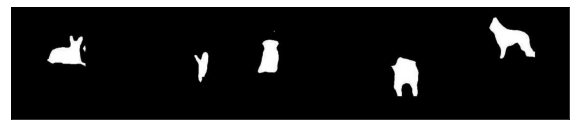

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


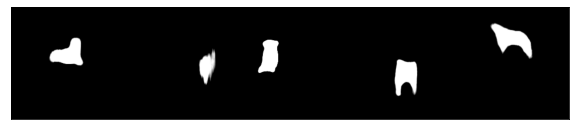



Test - Actual Depth


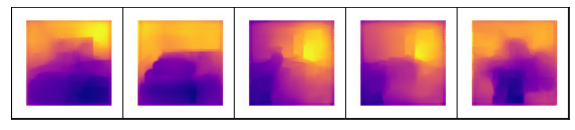

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


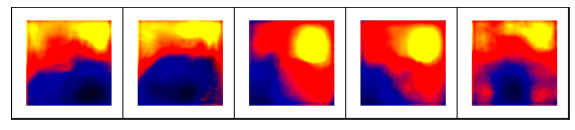

test: bce: 0.330333, dice: 0.357677, loss: 0.330333
test: bce: 0.332377, dice: 0.366387, loss: 0.332377
test: bce: 0.332066, dice: 0.363851, loss: 0.332066
************* 
Epoch: 100 	Training Loss: 0.331378 	Validation Loss: 0.331537

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.324188, dice: 0.354972, loss: 0.324188
train: bce: 0.332035, dice: 0.362237, loss: 0.332035
train: bce: 0.331989, dice: 0.366000, loss: 0.331989
train: bce: 0.331932, dice: 0.366253, loss: 0.331932
train: bce: 0.331726, dice: 0.364050, loss: 0.331726
train: bce: 0.332113, dice: 0.365008, loss: 0.332113
train: bce: 0.332037, dice: 0.364762, loss: 0.332037
train: bce: 0.331675, dice: 0.363959, loss: 0.331675
train: bce: 0.331700, dice: 0.364067, loss: 0.331700
test: bce: 0.342513, dice: 0.379486, loss: 0.342513
test: bce: 0.330508, dice: 0.365984, loss: 0.330508
test: bce: 0.331087, dice: 0.364332, loss: 0.331087
test: bce: 0.331918, dice: 0.365893, loss: 0.331918
************* 
Epoch: 101 	Training Loss: 0.32

In [19]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_10_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


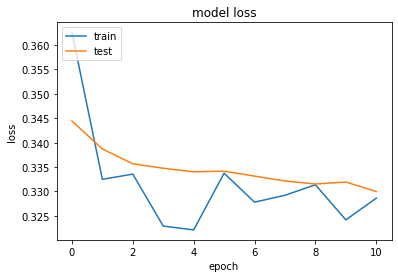

<Figure size 432x288 with 0 Axes>

time: 159 ms


In [20]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 11

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.624612, dice: 0.897613, loss: 0.624612


Train - Actual mask


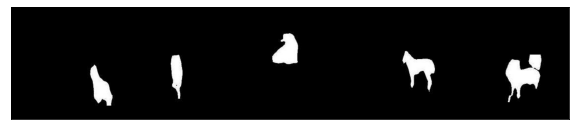

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


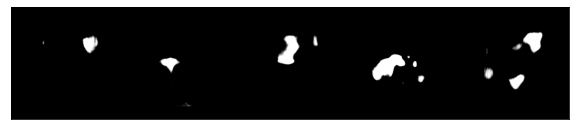



Train - Actual Depth


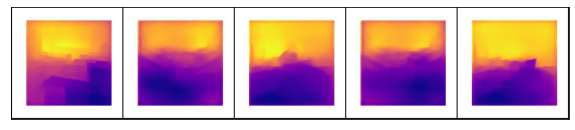

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


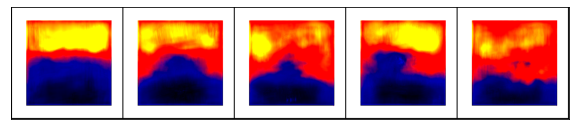

Best val loss: 0.624612
train: bce: 0.408327, dice: 0.701646, loss: 0.408327
train: bce: 0.380823, dice: 0.601636, loss: 0.380823
train: bce: 0.369268, dice: 0.554100, loss: 0.369268
train: bce: 0.362203, dice: 0.525546, loss: 0.362203
train: bce: 0.358054, dice: 0.508444, loss: 0.358054
train: bce: 0.354323, dice: 0.493591, loss: 0.354323
train: bce: 0.351474, dice: 0.481384, loss: 0.351474
train: bce: 0.349495, dice: 0.473154, loss: 0.349495
test: bce: 0.330852, dice: 0.414811, loss: 0.330852


Test - Actual mask: 92


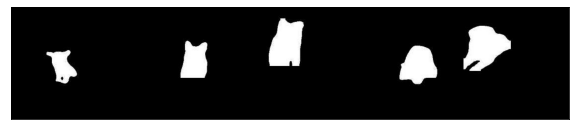

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


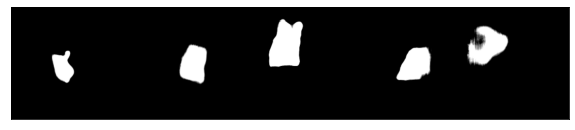



Test - Actual Depth


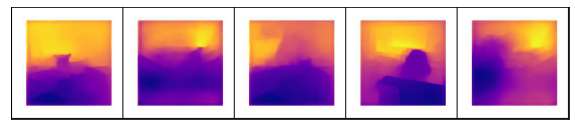

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


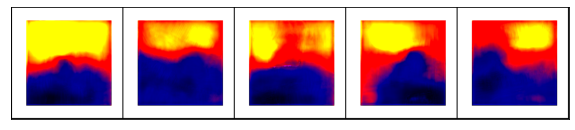

test: bce: 0.330971, dice: 0.400419, loss: 0.330971
test: bce: 0.331628, dice: 0.401950, loss: 0.331628
test: bce: 0.331659, dice: 0.402769, loss: 0.331659
************* 
Epoch: 92 	Training Loss: 0.348002 	Validation Loss: 0.330803

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.330034, dice: 0.409978, loss: 0.330034
train: bce: 0.335314, dice: 0.419379, loss: 0.335314
train: bce: 0.333395, dice: 0.406088, loss: 0.333395
train: bce: 0.332513, dice: 0.402151, loss: 0.332513
train: bce: 0.331414, dice: 0.401052, loss: 0.331414
train: bce: 0.331229, dice: 0.399586, loss: 0.331229
train: bce: 0.330535, dice: 0.397670, loss: 0.330535
train: bce: 0.330092, dice: 0.396025, loss: 0.330092
train: bce: 0.329678, dice: 0.394159, loss: 0.329678
test: bce: 0.346055, dice: 0.424519, loss: 0.346055
test: bce: 0.325394, dice: 0.385398, loss: 0.325394
test: bce: 0.325100, dice: 0.382114, loss: 0.325100
test: bce: 0.326508, dice: 0.387822, loss: 0.326508
************* 
Epoch: 93 	Training Loss: 0.32907

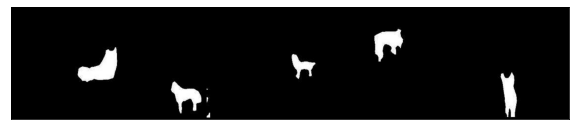

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


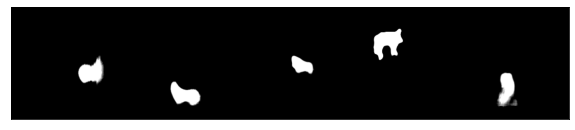



Train - Actual Depth


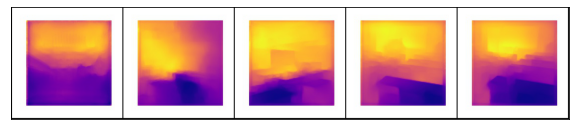

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


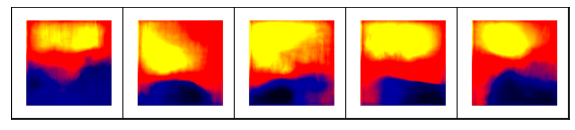

Best val loss: 0.323288
train: bce: 0.324743, dice: 0.379155, loss: 0.324743
train: bce: 0.324286, dice: 0.374697, loss: 0.324286
train: bce: 0.324480, dice: 0.373312, loss: 0.324480
train: bce: 0.323909, dice: 0.371294, loss: 0.323909
train: bce: 0.323527, dice: 0.369225, loss: 0.323527
train: bce: 0.323287, dice: 0.367854, loss: 0.323287
train: bce: 0.323206, dice: 0.367481, loss: 0.323206
train: bce: 0.323027, dice: 0.366922, loss: 0.323027
test: bce: 0.311981, dice: 0.332949, loss: 0.311981


Test - Actual mask: 96


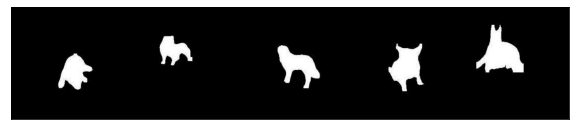

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


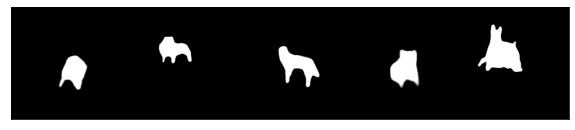



Test - Actual Depth


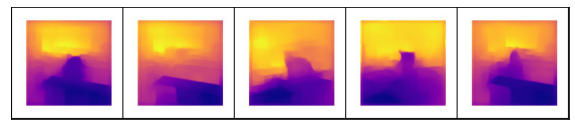

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


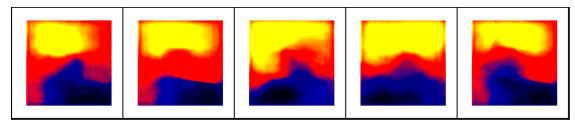

test: bce: 0.322211, dice: 0.372645, loss: 0.322211
test: bce: 0.323002, dice: 0.375188, loss: 0.323002
test: bce: 0.322359, dice: 0.374006, loss: 0.322359
************* 
Epoch: 96 	Training Loss: 0.320814 	Validation Loss: 0.322462

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.338985, dice: 0.400652, loss: 0.338985
train: bce: 0.322919, dice: 0.364641, loss: 0.322919
train: bce: 0.323161, dice: 0.366767, loss: 0.323161
train: bce: 0.323337, dice: 0.367511, loss: 0.323337
train: bce: 0.323154, dice: 0.367091, loss: 0.323154
train: bce: 0.323081, dice: 0.366109, loss: 0.323081
train: bce: 0.323039, dice: 0.365953, loss: 0.323039
train: bce: 0.322762, dice: 0.364987, loss: 0.322762
train: bce: 0.322458, dice: 0.363283, loss: 0.322458
test: bce: 0.312365, dice: 0.345936, loss: 0.312365
test: bce: 0.321605, dice: 0.369035, loss: 0.321605
test: bce: 0.320456, dice: 0.366582, loss: 0.320456
test: bce: 0.320531, dice: 0.366379, loss: 0.320531
************* 
Epoch: 97 	Training Loss: 0.32158

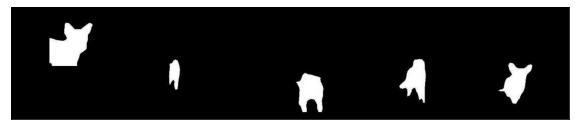

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


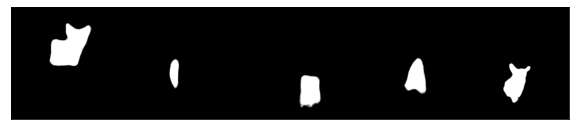



Train - Actual Depth


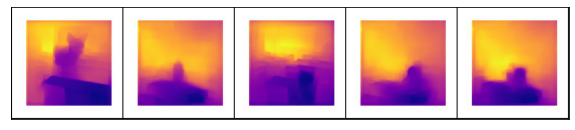

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


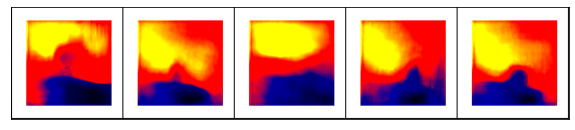

Best val loss: 0.315307
train: bce: 0.318908, dice: 0.350773, loss: 0.318908
train: bce: 0.320206, dice: 0.353862, loss: 0.320206
train: bce: 0.320600, dice: 0.354605, loss: 0.320600
train: bce: 0.320720, dice: 0.355794, loss: 0.320720
train: bce: 0.320616, dice: 0.356040, loss: 0.320616
train: bce: 0.320732, dice: 0.355107, loss: 0.320732
train: bce: 0.320620, dice: 0.354977, loss: 0.320620
train: bce: 0.320618, dice: 0.355185, loss: 0.320618
test: bce: 0.321066, dice: 0.411700, loss: 0.321066


Test - Actual mask: 100


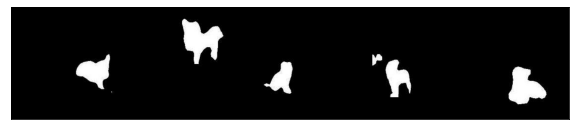

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


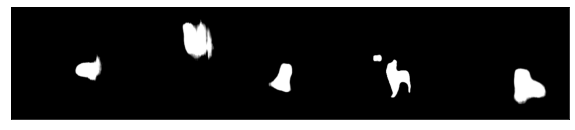



Test - Actual Depth


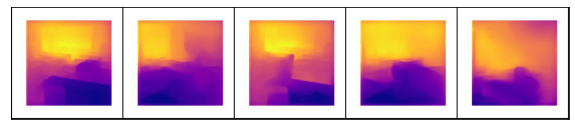

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


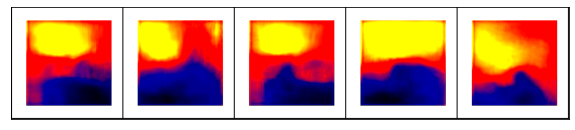

test: bce: 0.320535, dice: 0.361733, loss: 0.320535
test: bce: 0.320674, dice: 0.361235, loss: 0.320674
test: bce: 0.319981, dice: 0.359500, loss: 0.319981
************* 
Epoch: 100 	Training Loss: 0.314672 	Validation Loss: 0.319751

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.308917, dice: 0.354339, loss: 0.308917
train: bce: 0.319448, dice: 0.355097, loss: 0.319448
train: bce: 0.319730, dice: 0.355426, loss: 0.319730
train: bce: 0.320427, dice: 0.355193, loss: 0.320427
train: bce: 0.320530, dice: 0.354287, loss: 0.320530
train: bce: 0.320352, dice: 0.354149, loss: 0.320352
train: bce: 0.320413, dice: 0.354908, loss: 0.320413
train: bce: 0.320298, dice: 0.354582, loss: 0.320298
train: bce: 0.320074, dice: 0.354364, loss: 0.320074
test: bce: 0.331279, dice: 0.476158, loss: 0.331279
test: bce: 0.319759, dice: 0.359566, loss: 0.319759
test: bce: 0.318983, dice: 0.354294, loss: 0.318983
test: bce: 0.319049, dice: 0.355091, loss: 0.319049
************* 
Epoch: 101 	Training Loss: 0.30

In [21]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_11_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


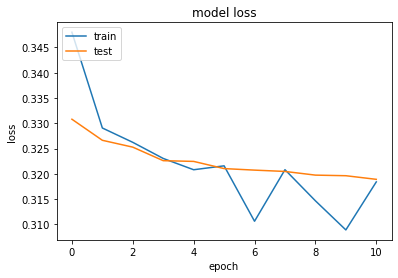

<Figure size 432x288 with 0 Axes>

time: 163 ms


In [22]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 12

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.668630, dice: 0.878476, loss: 0.668630


Train - Actual mask


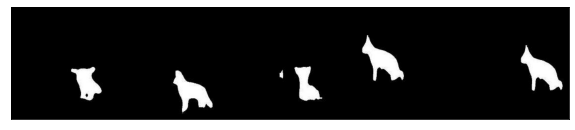

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


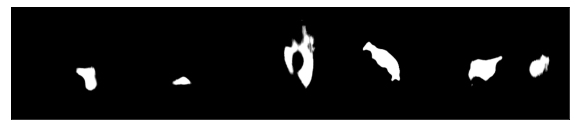



Train - Actual Depth


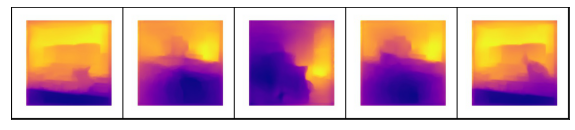

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


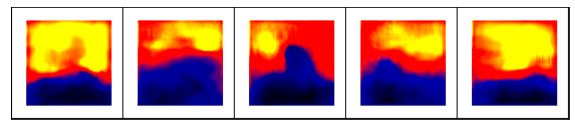

Best val loss: 0.668630
train: bce: 0.431378, dice: 0.765876, loss: 0.431378
train: bce: 0.400715, dice: 0.662729, loss: 0.400715
train: bce: 0.386578, dice: 0.610306, loss: 0.386578
train: bce: 0.376938, dice: 0.574424, loss: 0.376938
train: bce: 0.370440, dice: 0.550903, loss: 0.370440
train: bce: 0.365993, dice: 0.532532, loss: 0.365993
train: bce: 0.362866, dice: 0.519445, loss: 0.362866
train: bce: 0.360007, dice: 0.507808, loss: 0.360007
test: bce: 0.314366, dice: 0.382962, loss: 0.314366


Test - Actual mask: 92


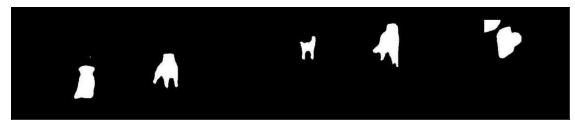

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


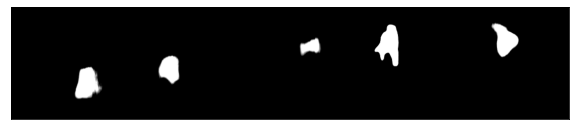



Test - Actual Depth


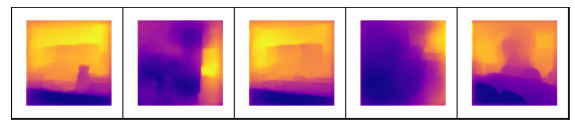

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


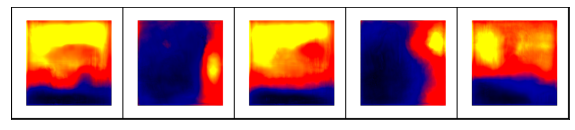

test: bce: 0.338676, dice: 0.423543, loss: 0.338676
test: bce: 0.339018, dice: 0.421419, loss: 0.339018
test: bce: 0.338781, dice: 0.420739, loss: 0.338781
************* 
Epoch: 92 	Training Loss: 0.358151 	Validation Loss: 0.338246

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.337747, dice: 0.419092, loss: 0.337747
train: bce: 0.336710, dice: 0.419131, loss: 0.336710
train: bce: 0.337577, dice: 0.415040, loss: 0.337577
train: bce: 0.336727, dice: 0.412127, loss: 0.336727
train: bce: 0.336608, dice: 0.412965, loss: 0.336608
train: bce: 0.336450, dice: 0.411673, loss: 0.336450
train: bce: 0.336040, dice: 0.409903, loss: 0.336040
train: bce: 0.335354, dice: 0.407408, loss: 0.335354
train: bce: 0.334797, dice: 0.405616, loss: 0.334797
test: bce: 0.333578, dice: 0.406473, loss: 0.333578
test: bce: 0.332781, dice: 0.398765, loss: 0.332781
test: bce: 0.332182, dice: 0.398802, loss: 0.332182
test: bce: 0.333559, dice: 0.403719, loss: 0.333559
************* 
Epoch: 93 	Training Loss: 0.33455

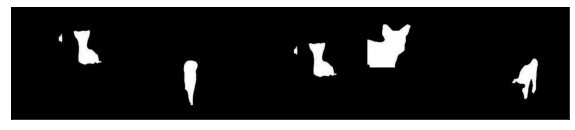

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


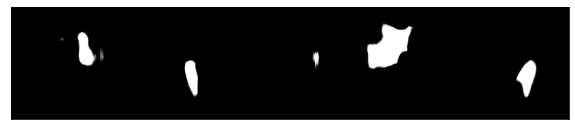



Train - Actual Depth


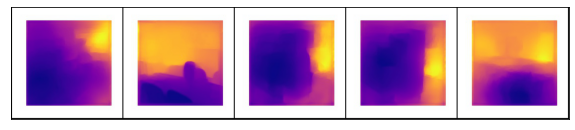

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


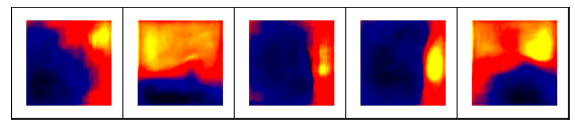

Best val loss: 0.333965
train: bce: 0.329514, dice: 0.387839, loss: 0.329514
train: bce: 0.328940, dice: 0.383771, loss: 0.328940
train: bce: 0.328798, dice: 0.381677, loss: 0.328798
train: bce: 0.328667, dice: 0.382081, loss: 0.328667
train: bce: 0.328669, dice: 0.379822, loss: 0.328669
train: bce: 0.328613, dice: 0.380486, loss: 0.328613
train: bce: 0.328803, dice: 0.381361, loss: 0.328803
train: bce: 0.328688, dice: 0.380991, loss: 0.328688
test: bce: 0.343965, dice: 0.414686, loss: 0.343965


Test - Actual mask: 96


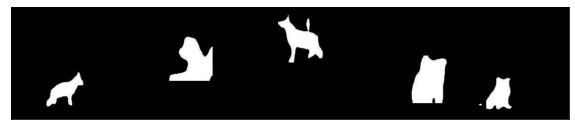

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


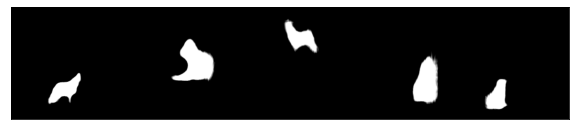



Test - Actual Depth


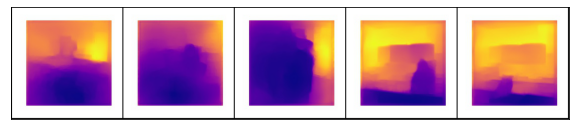

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


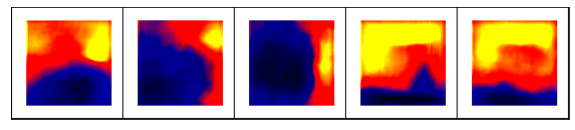

test: bce: 0.325860, dice: 0.372511, loss: 0.325860
test: bce: 0.325783, dice: 0.371662, loss: 0.325783
test: bce: 0.325792, dice: 0.371673, loss: 0.325792
************* 
Epoch: 96 	Training Loss: 0.325425 	Validation Loss: 0.326343

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.334529, dice: 0.395684, loss: 0.334529
train: bce: 0.328447, dice: 0.381680, loss: 0.328447
train: bce: 0.328694, dice: 0.382343, loss: 0.328694
train: bce: 0.327762, dice: 0.379825, loss: 0.327762
train: bce: 0.328333, dice: 0.381099, loss: 0.328333
train: bce: 0.328134, dice: 0.379819, loss: 0.328134
train: bce: 0.327867, dice: 0.377575, loss: 0.327867
train: bce: 0.327560, dice: 0.375976, loss: 0.327560
train: bce: 0.327469, dice: 0.375661, loss: 0.327469
test: bce: 0.327111, dice: 0.311016, loss: 0.327111
test: bce: 0.325400, dice: 0.370131, loss: 0.325400
test: bce: 0.325570, dice: 0.369092, loss: 0.325570
test: bce: 0.325101, dice: 0.368835, loss: 0.325101
************* 
Epoch: 97 	Training Loss: 0.32599

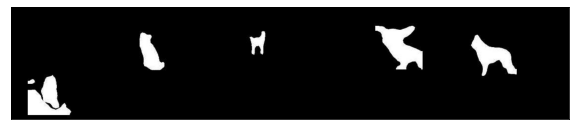

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


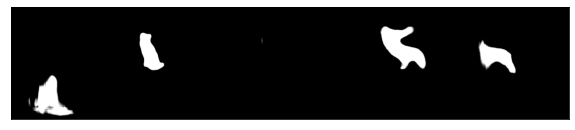



Train - Actual Depth


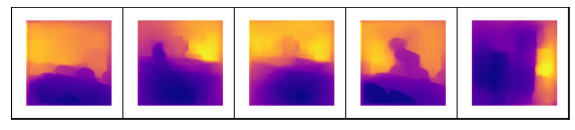

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


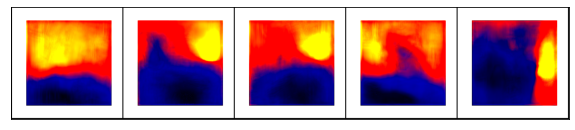

Best val loss: 0.325225
train: bce: 0.325153, dice: 0.368637, loss: 0.325153
train: bce: 0.324937, dice: 0.362842, loss: 0.324937
train: bce: 0.324847, dice: 0.363394, loss: 0.324847
train: bce: 0.325327, dice: 0.366478, loss: 0.325327
train: bce: 0.325435, dice: 0.366198, loss: 0.325435
train: bce: 0.324983, dice: 0.366209, loss: 0.324983
train: bce: 0.325057, dice: 0.366327, loss: 0.325057
train: bce: 0.324975, dice: 0.365781, loss: 0.324975
test: bce: 0.326338, dice: 0.403100, loss: 0.326338


Test - Actual mask: 100


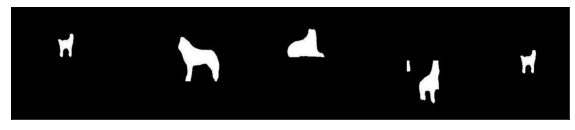

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


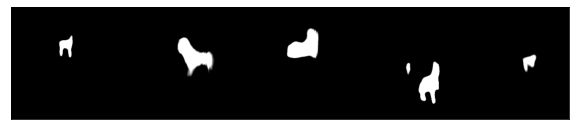



Test - Actual Depth


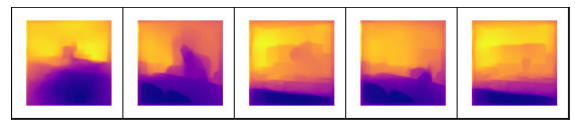

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


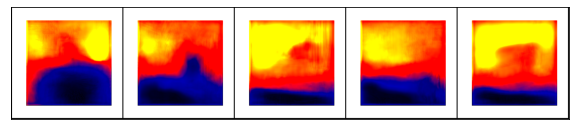

test: bce: 0.323760, dice: 0.358870, loss: 0.323760
test: bce: 0.323313, dice: 0.354135, loss: 0.323313
test: bce: 0.324163, dice: 0.356896, loss: 0.324163
************* 
Epoch: 100 	Training Loss: 0.322535 	Validation Loss: 0.324809

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.320075, dice: 0.333617, loss: 0.320075
train: bce: 0.325186, dice: 0.371053, loss: 0.325186
train: bce: 0.324676, dice: 0.368539, loss: 0.324676
train: bce: 0.324505, dice: 0.367498, loss: 0.324505
train: bce: 0.324206, dice: 0.365246, loss: 0.324206
train: bce: 0.324124, dice: 0.364683, loss: 0.324124
train: bce: 0.324208, dice: 0.365187, loss: 0.324208
train: bce: 0.324296, dice: 0.364878, loss: 0.324296
train: bce: 0.324400, dice: 0.365112, loss: 0.324400
test: bce: 0.316265, dice: 0.314412, loss: 0.316265
test: bce: 0.322100, dice: 0.348616, loss: 0.322100
test: bce: 0.323670, dice: 0.356260, loss: 0.323670
test: bce: 0.323951, dice: 0.357003, loss: 0.323951
************* 
Epoch: 101 	Training Loss: 0.31

In [24]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_12_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


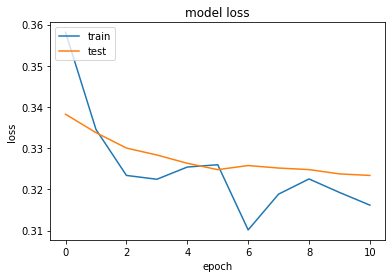

<Figure size 432x288 with 0 Axes>

time: 165 ms


In [25]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 13

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.690775, dice: 0.867352, loss: 0.690775


Train - Actual mask


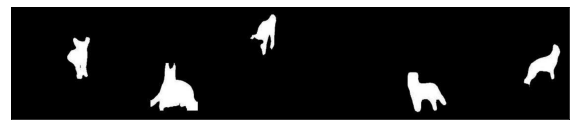

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


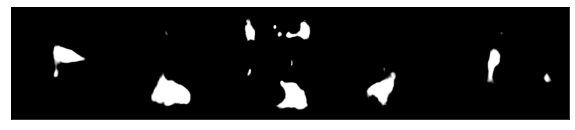



Train - Actual Depth


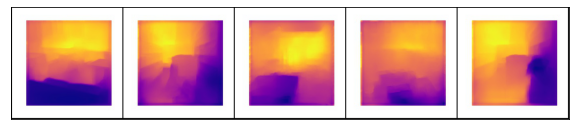

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


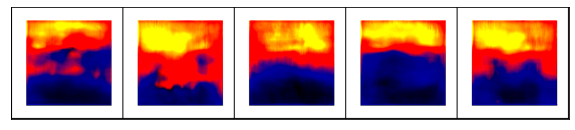

Best val loss: 0.690775
train: bce: 0.435949, dice: 0.740868, loss: 0.435949
train: bce: 0.407026, dice: 0.648085, loss: 0.407026
train: bce: 0.393081, dice: 0.593746, loss: 0.393081
train: bce: 0.385381, dice: 0.562021, loss: 0.385381
train: bce: 0.379882, dice: 0.540547, loss: 0.379882
train: bce: 0.375843, dice: 0.524972, loss: 0.375843
train: bce: 0.372372, dice: 0.509751, loss: 0.372372
train: bce: 0.369754, dice: 0.500624, loss: 0.369754
test: bce: 0.358228, dice: 0.402364, loss: 0.358228


Test - Actual mask: 92


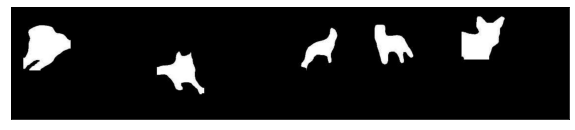

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


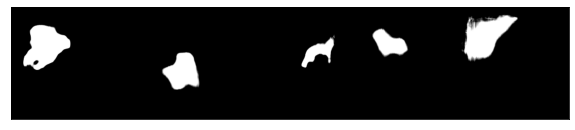



Test - Actual Depth


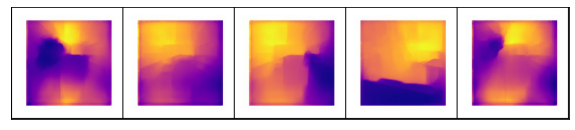

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


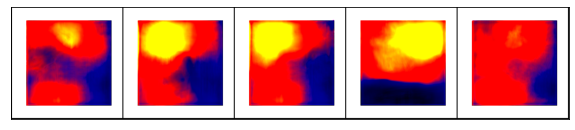

test: bce: 0.348532, dice: 0.407358, loss: 0.348532
test: bce: 0.349290, dice: 0.411201, loss: 0.349290
test: bce: 0.349032, dice: 0.411723, loss: 0.349032
************* 
Epoch: 92 	Training Loss: 0.368268 	Validation Loss: 0.348962

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.356780, dice: 0.430319, loss: 0.356780
train: bce: 0.348277, dice: 0.416248, loss: 0.348277
train: bce: 0.348450, dice: 0.416367, loss: 0.348450
train: bce: 0.347790, dice: 0.413913, loss: 0.347790
train: bce: 0.347043, dice: 0.410787, loss: 0.347043
train: bce: 0.347103, dice: 0.410490, loss: 0.347103
train: bce: 0.346844, dice: 0.407870, loss: 0.346844
train: bce: 0.346746, dice: 0.407684, loss: 0.346746
train: bce: 0.346495, dice: 0.406256, loss: 0.346495
test: bce: 0.341192, dice: 0.358855, loss: 0.341192
test: bce: 0.344416, dice: 0.389729, loss: 0.344416
test: bce: 0.344412, dice: 0.389473, loss: 0.344412
test: bce: 0.344725, dice: 0.391276, loss: 0.344725
************* 
Epoch: 93 	Training Loss: 0.34637

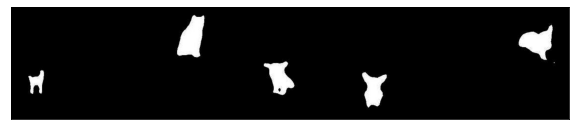

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


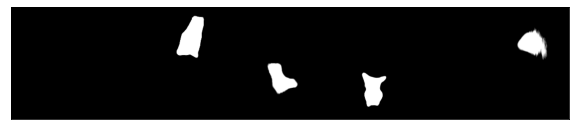



Train - Actual Depth


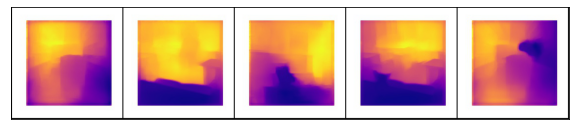

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


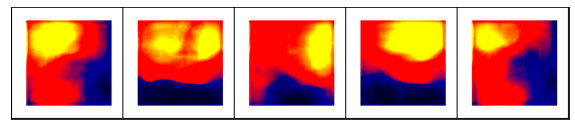

Best val loss: 0.328707
train: bce: 0.339902, dice: 0.379887, loss: 0.339902
train: bce: 0.340625, dice: 0.380624, loss: 0.340625
train: bce: 0.341252, dice: 0.380858, loss: 0.341252
train: bce: 0.340872, dice: 0.381226, loss: 0.340872
train: bce: 0.340890, dice: 0.381243, loss: 0.340890
train: bce: 0.340959, dice: 0.381389, loss: 0.340959
train: bce: 0.340814, dice: 0.381207, loss: 0.340814
train: bce: 0.340669, dice: 0.380546, loss: 0.340669
test: bce: 0.321629, dice: 0.320242, loss: 0.321629


Test - Actual mask: 96


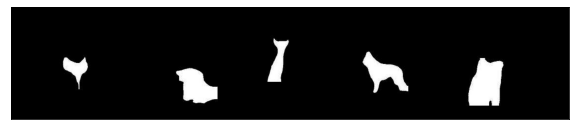

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


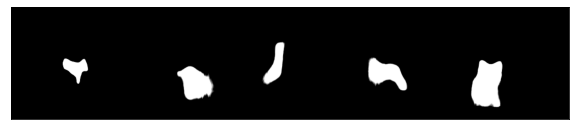



Test - Actual Depth


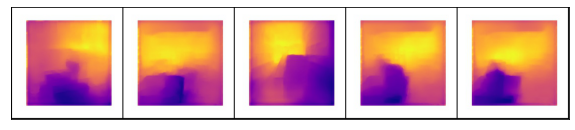

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


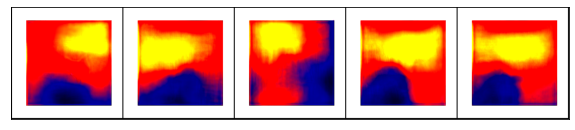

test: bce: 0.337923, dice: 0.364151, loss: 0.337923
test: bce: 0.338103, dice: 0.366001, loss: 0.338103
test: bce: 0.338618, dice: 0.368703, loss: 0.338618
************* 
Epoch: 96 	Training Loss: 0.328707 	Validation Loss: 0.339045

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.347913, dice: 0.382638, loss: 0.347913
train: bce: 0.339592, dice: 0.377404, loss: 0.339592
train: bce: 0.338988, dice: 0.373847, loss: 0.338988
train: bce: 0.339617, dice: 0.375772, loss: 0.339617
train: bce: 0.339341, dice: 0.375256, loss: 0.339341
train: bce: 0.339130, dice: 0.374162, loss: 0.339130
train: bce: 0.338985, dice: 0.374244, loss: 0.338985
train: bce: 0.339011, dice: 0.373930, loss: 0.339011
train: bce: 0.338802, dice: 0.372619, loss: 0.338802
test: bce: 0.335354, dice: 0.349864, loss: 0.335354
test: bce: 0.337350, dice: 0.357077, loss: 0.337350
test: bce: 0.338218, dice: 0.359620, loss: 0.338218
test: bce: 0.338867, dice: 0.359645, loss: 0.338867
************* 
Epoch: 97 	Training Loss: 0.33877

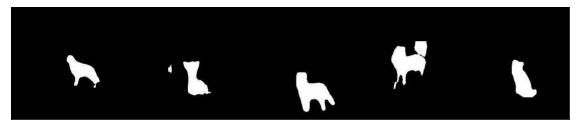

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


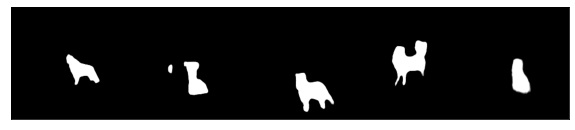



Train - Actual Depth


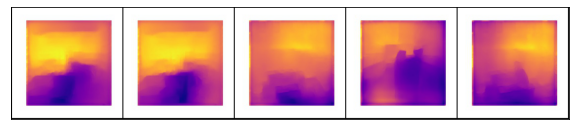

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


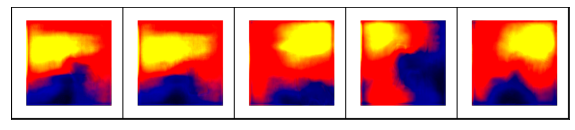

Best val loss: 0.349851
train: bce: 0.335674, dice: 0.358732, loss: 0.335674
train: bce: 0.336522, dice: 0.362763, loss: 0.336522
train: bce: 0.336225, dice: 0.362215, loss: 0.336225
train: bce: 0.336562, dice: 0.363036, loss: 0.336562
train: bce: 0.336915, dice: 0.364805, loss: 0.336915
train: bce: 0.336742, dice: 0.364039, loss: 0.336742
train: bce: 0.336754, dice: 0.362968, loss: 0.336754
train: bce: 0.336620, dice: 0.362702, loss: 0.336620
test: bce: 0.347221, dice: 0.349207, loss: 0.347221


Test - Actual mask: 100


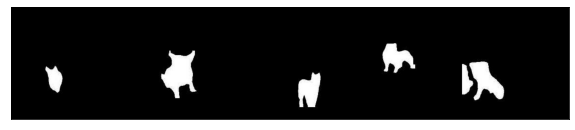

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


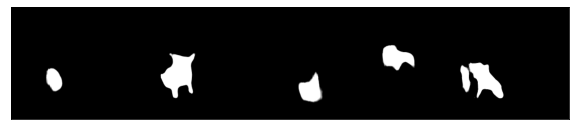



Test - Actual Depth


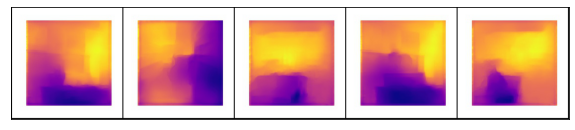

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


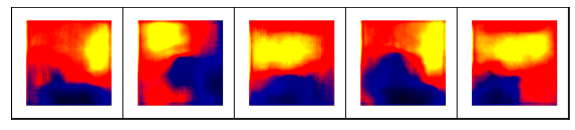

test: bce: 0.334702, dice: 0.365994, loss: 0.334702
test: bce: 0.335625, dice: 0.365110, loss: 0.335625
test: bce: 0.335736, dice: 0.364984, loss: 0.335736
************* 
Epoch: 100 	Training Loss: 0.334548 	Validation Loss: 0.336189

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.338794, dice: 0.369855, loss: 0.338794
train: bce: 0.335747, dice: 0.361546, loss: 0.335747
train: bce: 0.336601, dice: 0.365903, loss: 0.336601
train: bce: 0.337045, dice: 0.365378, loss: 0.337045
train: bce: 0.337058, dice: 0.364754, loss: 0.337058
train: bce: 0.336990, dice: 0.363988, loss: 0.336990
train: bce: 0.336483, dice: 0.362111, loss: 0.336483
train: bce: 0.336391, dice: 0.361490, loss: 0.336391
train: bce: 0.336158, dice: 0.361211, loss: 0.336158
test: bce: 0.333225, dice: 0.373350, loss: 0.333225
test: bce: 0.337404, dice: 0.359447, loss: 0.337404
test: bce: 0.336878, dice: 0.357982, loss: 0.336878
test: bce: 0.336976, dice: 0.359039, loss: 0.336976
************* 
Epoch: 101 	Training Loss: 0.33

In [26]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_13_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


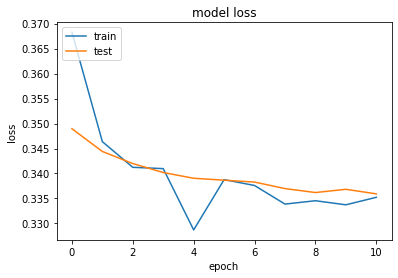

<Figure size 432x288 with 0 Axes>

time: 157 ms


In [27]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 14

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.700370, dice: 0.898968, loss: 0.700370


Train - Actual mask


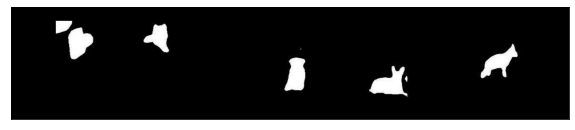

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


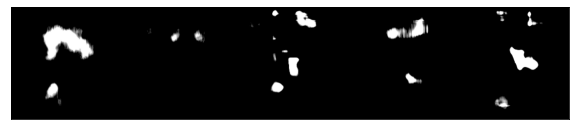



Train - Actual Depth


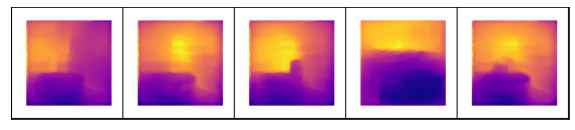

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


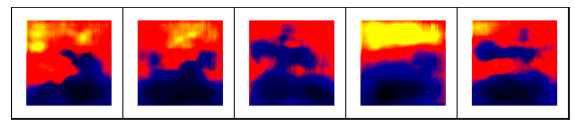

Best val loss: 0.700370
train: bce: 0.445257, dice: 0.790458, loss: 0.445257
train: bce: 0.412899, dice: 0.674877, loss: 0.412899
train: bce: 0.397095, dice: 0.616982, loss: 0.397095
train: bce: 0.387412, dice: 0.581419, loss: 0.387412
train: bce: 0.381331, dice: 0.555441, loss: 0.381331
train: bce: 0.376650, dice: 0.535616, loss: 0.376650
train: bce: 0.373321, dice: 0.522145, loss: 0.373321
train: bce: 0.370083, dice: 0.509434, loss: 0.370083
test: bce: 0.350265, dice: 0.411559, loss: 0.350265


Test - Actual mask: 92


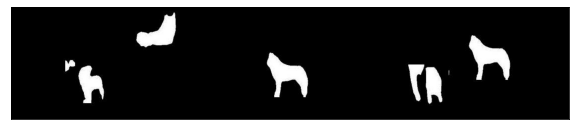

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


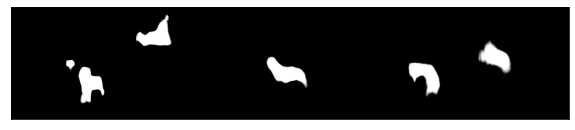



Test - Actual Depth


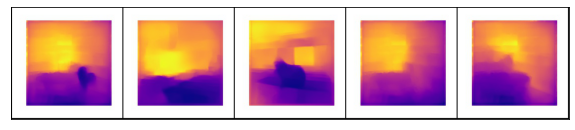

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


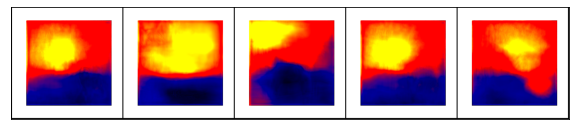

test: bce: 0.348501, dice: 0.421744, loss: 0.348501
test: bce: 0.347494, dice: 0.418549, loss: 0.347494
test: bce: 0.346888, dice: 0.415728, loss: 0.346888
************* 
Epoch: 92 	Training Loss: 0.368352 	Validation Loss: 0.347236

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.367414, dice: 0.443402, loss: 0.367414
train: bce: 0.350892, dice: 0.435803, loss: 0.350892
train: bce: 0.349274, dice: 0.427473, loss: 0.349274
train: bce: 0.348372, dice: 0.420979, loss: 0.348372
train: bce: 0.348183, dice: 0.419093, loss: 0.348183
train: bce: 0.347412, dice: 0.416883, loss: 0.347412
train: bce: 0.347093, dice: 0.416222, loss: 0.347093
train: bce: 0.346706, dice: 0.414790, loss: 0.346706
train: bce: 0.346183, dice: 0.412635, loss: 0.346183
test: bce: 0.359381, dice: 0.392981, loss: 0.359381
test: bce: 0.342198, dice: 0.393480, loss: 0.342198
test: bce: 0.341802, dice: 0.392597, loss: 0.341802
test: bce: 0.342354, dice: 0.391955, loss: 0.342354
************* 
Epoch: 93 	Training Loss: 0.34601

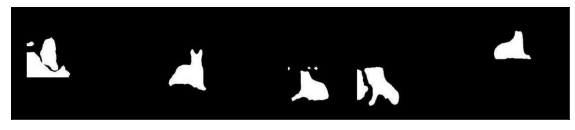

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


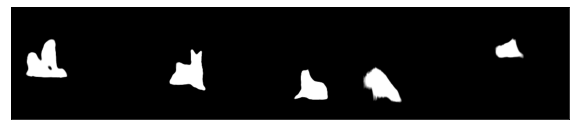



Train - Actual Depth


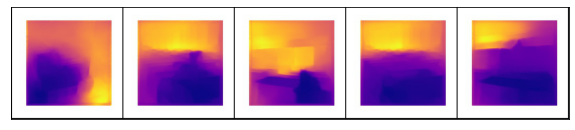

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


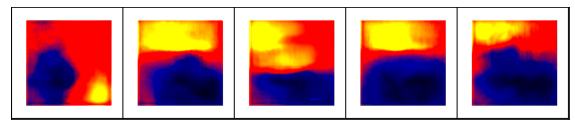

Best val loss: 0.339968
train: bce: 0.338516, dice: 0.384097, loss: 0.338516
train: bce: 0.338511, dice: 0.385673, loss: 0.338511
train: bce: 0.339034, dice: 0.385473, loss: 0.339034
train: bce: 0.339489, dice: 0.386683, loss: 0.339489
train: bce: 0.339217, dice: 0.383710, loss: 0.339217
train: bce: 0.339429, dice: 0.382344, loss: 0.339429
train: bce: 0.338990, dice: 0.381507, loss: 0.338990
train: bce: 0.338869, dice: 0.381206, loss: 0.338869
test: bce: 0.323281, dice: 0.363455, loss: 0.323281


Test - Actual mask: 96


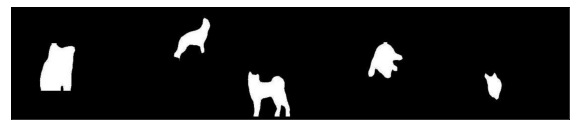

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


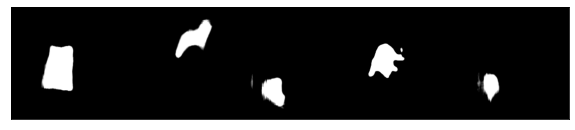



Test - Actual Depth


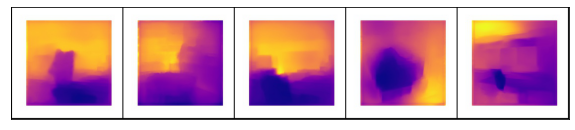

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


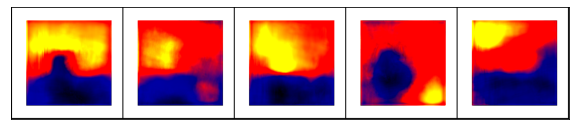

test: bce: 0.336910, dice: 0.382950, loss: 0.336910
test: bce: 0.336969, dice: 0.377095, loss: 0.336969
test: bce: 0.336746, dice: 0.375138, loss: 0.336746
************* 
Epoch: 96 	Training Loss: 0.337624 	Validation Loss: 0.336288

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.342149, dice: 0.418044, loss: 0.342149
train: bce: 0.338107, dice: 0.381212, loss: 0.338107
train: bce: 0.338090, dice: 0.380411, loss: 0.338090
train: bce: 0.337614, dice: 0.380265, loss: 0.337614
train: bce: 0.337570, dice: 0.379583, loss: 0.337570
train: bce: 0.337221, dice: 0.377404, loss: 0.337221
train: bce: 0.336991, dice: 0.375742, loss: 0.336991
train: bce: 0.337065, dice: 0.375162, loss: 0.337065
train: bce: 0.337257, dice: 0.374326, loss: 0.337257
test: bce: 0.341495, dice: 0.421894, loss: 0.341495
test: bce: 0.337915, dice: 0.377350, loss: 0.337915
test: bce: 0.336481, dice: 0.371602, loss: 0.336481
test: bce: 0.336016, dice: 0.372405, loss: 0.336016
************* 
Epoch: 97 	Training Loss: 0.33155

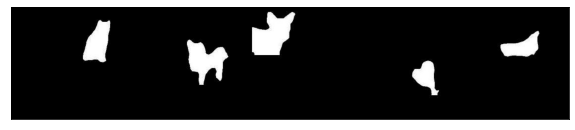

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


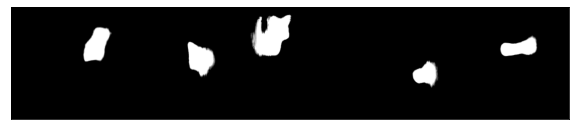



Train - Actual Depth


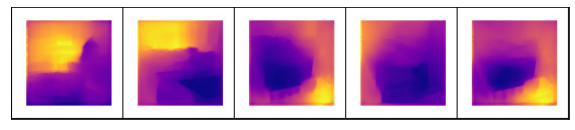

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


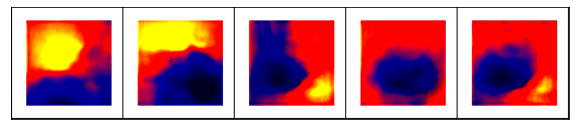

Best val loss: 0.354922
train: bce: 0.334738, dice: 0.365481, loss: 0.334738
train: bce: 0.334966, dice: 0.367624, loss: 0.334966
train: bce: 0.335220, dice: 0.367288, loss: 0.335220
train: bce: 0.334708, dice: 0.364467, loss: 0.334708
train: bce: 0.334811, dice: 0.363735, loss: 0.334811
train: bce: 0.334540, dice: 0.363397, loss: 0.334540
train: bce: 0.334622, dice: 0.364242, loss: 0.334622
train: bce: 0.334940, dice: 0.364765, loss: 0.334940
test: bce: 0.343604, dice: 0.452176, loss: 0.343604


Test - Actual mask: 100


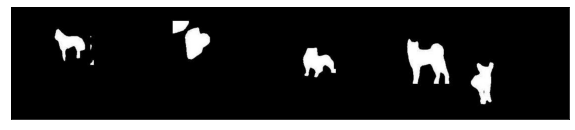

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


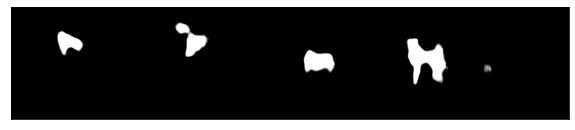



Test - Actual Depth


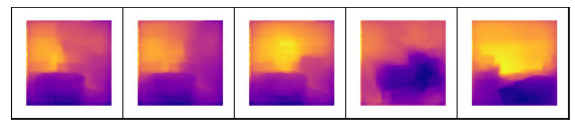

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


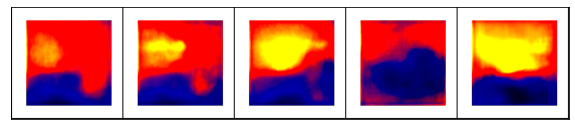

test: bce: 0.332848, dice: 0.363325, loss: 0.332848
test: bce: 0.333199, dice: 0.363326, loss: 0.333199
test: bce: 0.333143, dice: 0.361290, loss: 0.333143
************* 
Epoch: 100 	Training Loss: 0.333654 	Validation Loss: 0.333011

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.328382, dice: 0.360798, loss: 0.328382
train: bce: 0.336392, dice: 0.362506, loss: 0.336392
train: bce: 0.335724, dice: 0.362994, loss: 0.335724
train: bce: 0.335473, dice: 0.364949, loss: 0.335473
train: bce: 0.334912, dice: 0.363876, loss: 0.334912
train: bce: 0.334778, dice: 0.363106, loss: 0.334778
train: bce: 0.334154, dice: 0.361297, loss: 0.334154
train: bce: 0.334080, dice: 0.361393, loss: 0.334080
train: bce: 0.334135, dice: 0.361081, loss: 0.334135
test: bce: 0.328359, dice: 0.377659, loss: 0.328359
test: bce: 0.336945, dice: 0.382725, loss: 0.336945
test: bce: 0.335595, dice: 0.378495, loss: 0.335595
test: bce: 0.335550, dice: 0.380281, loss: 0.335550
************* 
Epoch: 101 	Training Loss: 0.32

In [28]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_14_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


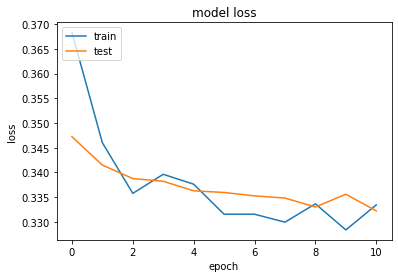

<Figure size 432x288 with 0 Axes>

time: 160 ms


In [29]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 15

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.536561, dice: 0.753053, loss: 0.536561


Train - Actual mask


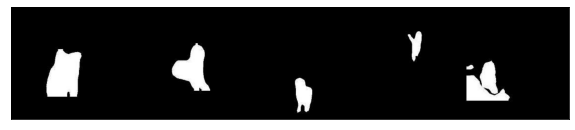

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


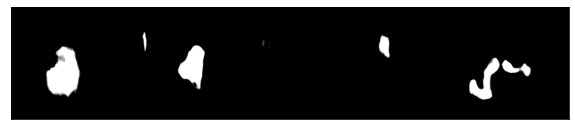



Train - Actual Depth


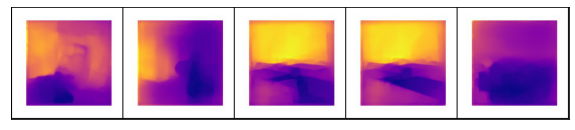

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


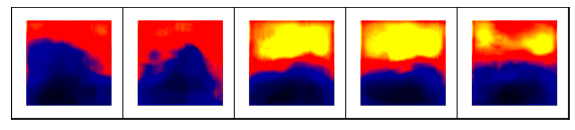

Best val loss: 0.536561
train: bce: 0.434687, dice: 0.733919, loss: 0.434687
train: bce: 0.406018, dice: 0.640716, loss: 0.406018
train: bce: 0.392753, dice: 0.591122, loss: 0.392753
train: bce: 0.385465, dice: 0.561655, loss: 0.385465
train: bce: 0.380350, dice: 0.541978, loss: 0.380350
train: bce: 0.376163, dice: 0.526200, loss: 0.376163
train: bce: 0.373102, dice: 0.514467, loss: 0.373102
train: bce: 0.370442, dice: 0.503819, loss: 0.370442
test: bce: 0.352175, dice: 0.465183, loss: 0.352175


Test - Actual mask: 92


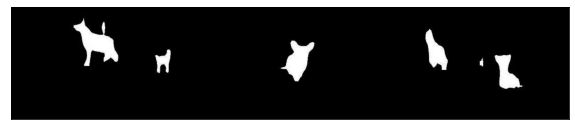

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


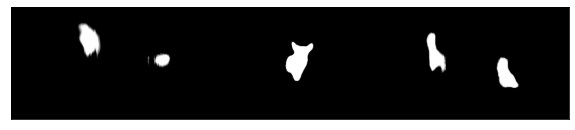



Test - Actual Depth


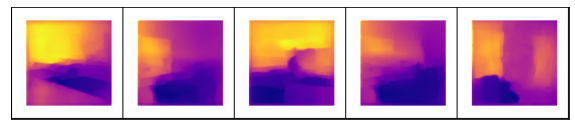

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


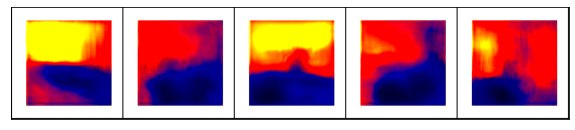

test: bce: 0.349261, dice: 0.418249, loss: 0.349261
test: bce: 0.350021, dice: 0.423620, loss: 0.350021
test: bce: 0.348931, dice: 0.420944, loss: 0.348931
************* 
Epoch: 92 	Training Loss: 0.368984 	Validation Loss: 0.349399

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.344391, dice: 0.376781, loss: 0.344391
train: bce: 0.350708, dice: 0.425921, loss: 0.350708
train: bce: 0.349848, dice: 0.423832, loss: 0.349848
train: bce: 0.349521, dice: 0.420053, loss: 0.349521
train: bce: 0.349581, dice: 0.418910, loss: 0.349581
train: bce: 0.349647, dice: 0.418059, loss: 0.349647
train: bce: 0.348929, dice: 0.417262, loss: 0.348929
train: bce: 0.348546, dice: 0.416247, loss: 0.348546
train: bce: 0.348416, dice: 0.415769, loss: 0.348416
test: bce: 0.330839, dice: 0.370154, loss: 0.330839
test: bce: 0.341589, dice: 0.396607, loss: 0.341589
test: bce: 0.342765, dice: 0.401625, loss: 0.342765
test: bce: 0.343314, dice: 0.403642, loss: 0.343314
************* 
Epoch: 93 	Training Loss: 0.34293

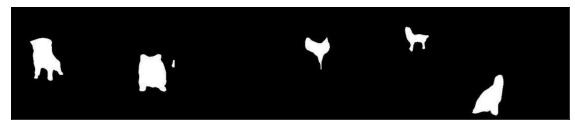

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


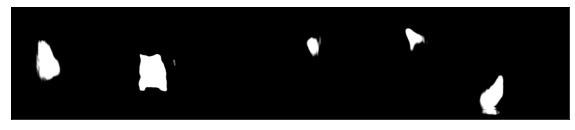



Train - Actual Depth


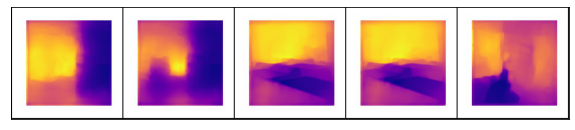

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


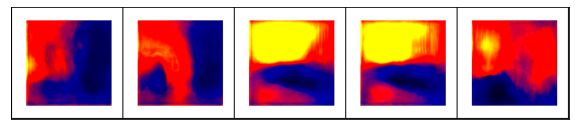

Best val loss: 0.332192
train: bce: 0.340562, dice: 0.391575, loss: 0.340562
train: bce: 0.340337, dice: 0.386890, loss: 0.340337
train: bce: 0.340542, dice: 0.383421, loss: 0.340542
train: bce: 0.340523, dice: 0.384149, loss: 0.340523
train: bce: 0.340512, dice: 0.383293, loss: 0.340512
train: bce: 0.340436, dice: 0.382114, loss: 0.340436
train: bce: 0.340586, dice: 0.383401, loss: 0.340586
train: bce: 0.340728, dice: 0.384314, loss: 0.340728
test: bce: 0.336507, dice: 0.356653, loss: 0.336507


Test - Actual mask: 96


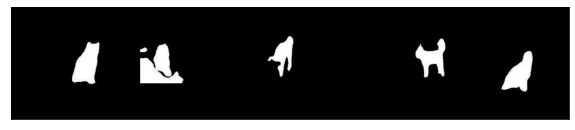



Test - Predicted mask


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


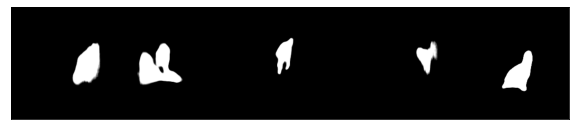



Test - Actual Depth


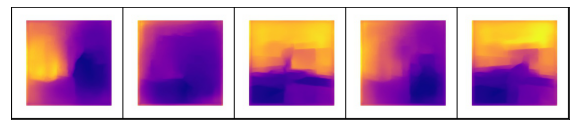

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


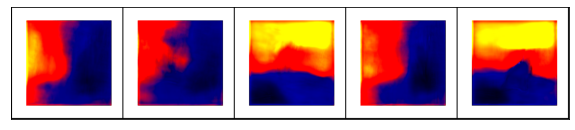

test: bce: 0.334091, dice: 0.363392, loss: 0.334091
test: bce: 0.336529, dice: 0.367738, loss: 0.336529
test: bce: 0.336989, dice: 0.368909, loss: 0.336989
************* 
Epoch: 96 	Training Loss: 0.332192 	Validation Loss: 0.337034

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.337177, dice: 0.356045, loss: 0.337177
train: bce: 0.339170, dice: 0.379071, loss: 0.339170
train: bce: 0.339293, dice: 0.380878, loss: 0.339293
train: bce: 0.339362, dice: 0.380522, loss: 0.339362
train: bce: 0.340467, dice: 0.383976, loss: 0.340467
train: bce: 0.340228, dice: 0.381843, loss: 0.340228
train: bce: 0.340229, dice: 0.382269, loss: 0.340229
train: bce: 0.339960, dice: 0.380085, loss: 0.339960
train: bce: 0.339659, dice: 0.378631, loss: 0.339659
test: bce: 0.334859, dice: 0.366491, loss: 0.334859
test: bce: 0.338943, dice: 0.375908, loss: 0.338943
test: bce: 0.337030, dice: 0.372530, loss: 0.337030
test: bce: 0.337570, dice: 0.374058, loss: 0.337570
************* 
Epoch: 97 	Training Loss: 0.33717

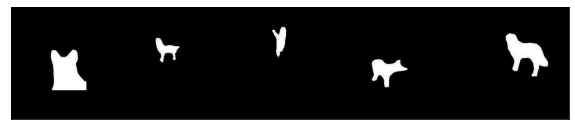

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


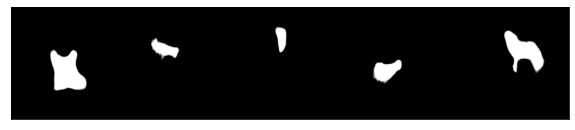



Train - Actual Depth


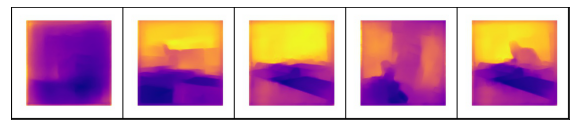

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


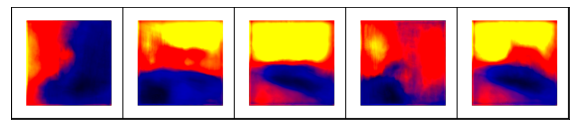

Best val loss: 0.330099
train: bce: 0.334565, dice: 0.368800, loss: 0.334565
train: bce: 0.336529, dice: 0.369078, loss: 0.336529
train: bce: 0.337381, dice: 0.371294, loss: 0.337381
train: bce: 0.337793, dice: 0.374339, loss: 0.337793
train: bce: 0.338163, dice: 0.374346, loss: 0.338163
train: bce: 0.337979, dice: 0.372903, loss: 0.337979
train: bce: 0.337598, dice: 0.371432, loss: 0.337598
train: bce: 0.337556, dice: 0.370584, loss: 0.337556
test: bce: 0.348197, dice: 0.395232, loss: 0.348197


Test - Actual mask: 100


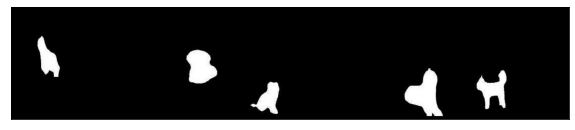

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


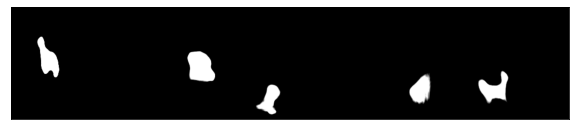



Test - Actual Depth


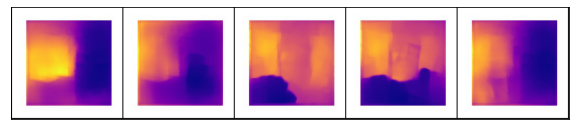

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


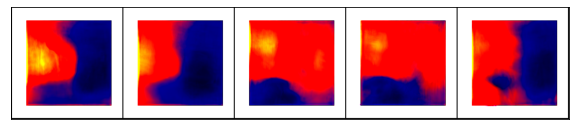

test: bce: 0.336137, dice: 0.371349, loss: 0.336137
test: bce: 0.336113, dice: 0.367927, loss: 0.336113
test: bce: 0.335747, dice: 0.366452, loss: 0.335747
************* 
Epoch: 100 	Training Loss: 0.328668 	Validation Loss: 0.335331

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.341591, dice: 0.374470, loss: 0.341591
train: bce: 0.337039, dice: 0.366522, loss: 0.337039
train: bce: 0.336947, dice: 0.363485, loss: 0.336947
train: bce: 0.336619, dice: 0.366886, loss: 0.336619
train: bce: 0.336470, dice: 0.366605, loss: 0.336470
train: bce: 0.336217, dice: 0.364352, loss: 0.336217
train: bce: 0.336236, dice: 0.363519, loss: 0.336236
train: bce: 0.336155, dice: 0.363192, loss: 0.336155
train: bce: 0.336269, dice: 0.363571, loss: 0.336269
test: bce: 0.321229, dice: 0.314288, loss: 0.321229
test: bce: 0.334266, dice: 0.363887, loss: 0.334266
test: bce: 0.334512, dice: 0.362815, loss: 0.334512
test: bce: 0.334636, dice: 0.366623, loss: 0.334636
************* 
Epoch: 101 	Training Loss: 0.33

In [30]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_15_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


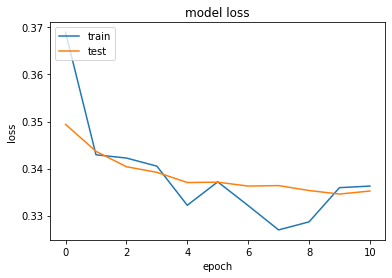

<Figure size 432x288 with 0 Axes>

time: 150 ms


In [31]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 16

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.655784, dice: 0.845185, loss: 0.655784


Train - Actual mask


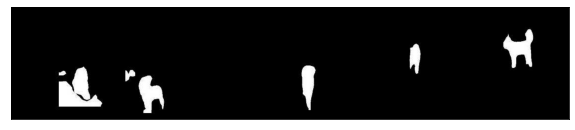

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


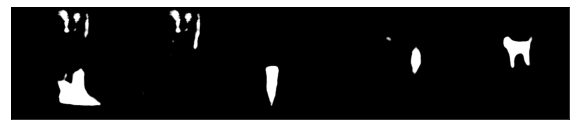



Train - Actual Depth


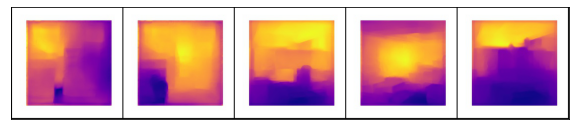

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


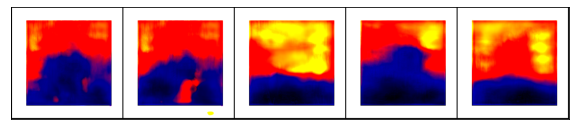

Best val loss: 0.655784
train: bce: 0.426467, dice: 0.708857, loss: 0.426467
train: bce: 0.399225, dice: 0.618603, loss: 0.399225
train: bce: 0.385783, dice: 0.574591, loss: 0.385783
train: bce: 0.377984, dice: 0.545112, loss: 0.377984
train: bce: 0.372973, dice: 0.525318, loss: 0.372973
train: bce: 0.369035, dice: 0.510431, loss: 0.369035
train: bce: 0.365892, dice: 0.498071, loss: 0.365892
train: bce: 0.363505, dice: 0.489457, loss: 0.363505
test: bce: 0.356819, dice: 0.401371, loss: 0.356819


Test - Actual mask: 92


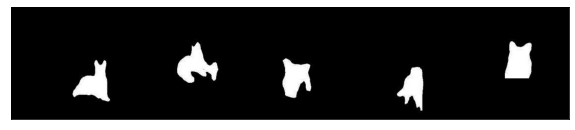

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


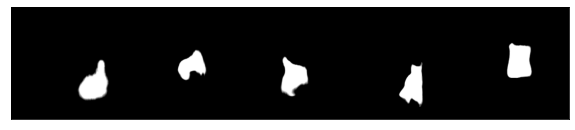



Test - Actual Depth


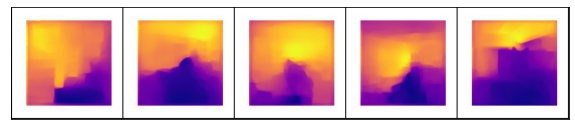

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


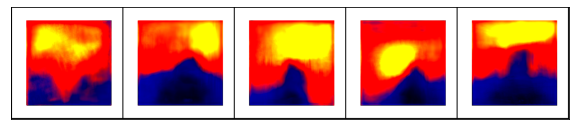

test: bce: 0.345649, dice: 0.419121, loss: 0.345649
test: bce: 0.344359, dice: 0.417912, loss: 0.344359
test: bce: 0.343337, dice: 0.415731, loss: 0.343337
************* 
Epoch: 92 	Training Loss: 0.361868 	Validation Loss: 0.343863

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.345007, dice: 0.413903, loss: 0.345007
train: bce: 0.344867, dice: 0.410590, loss: 0.344867
train: bce: 0.344257, dice: 0.414191, loss: 0.344257
train: bce: 0.343711, dice: 0.411136, loss: 0.343711
train: bce: 0.342974, dice: 0.409946, loss: 0.342974
train: bce: 0.342678, dice: 0.408954, loss: 0.342678
train: bce: 0.342590, dice: 0.409110, loss: 0.342590
train: bce: 0.342546, dice: 0.409501, loss: 0.342546
train: bce: 0.341976, dice: 0.407085, loss: 0.341976
test: bce: 0.332478, dice: 0.387386, loss: 0.332478
test: bce: 0.339660, dice: 0.393775, loss: 0.339660
test: bce: 0.339910, dice: 0.395888, loss: 0.339910
test: bce: 0.339443, dice: 0.395117, loss: 0.339443
************* 
Epoch: 93 	Training Loss: 0.34125

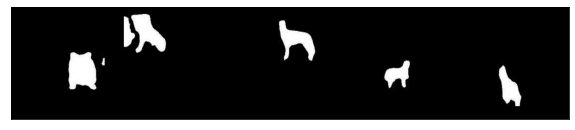

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


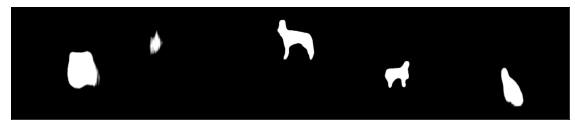



Train - Actual Depth


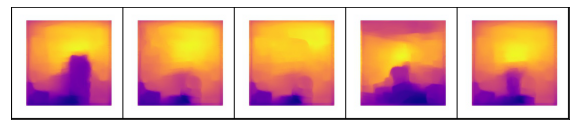

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


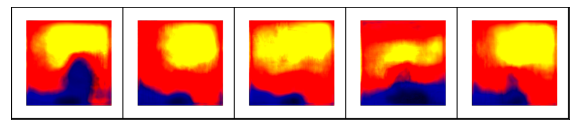

Best val loss: 0.344467
train: bce: 0.337187, dice: 0.382952, loss: 0.337187
train: bce: 0.336248, dice: 0.384403, loss: 0.336248
train: bce: 0.335931, dice: 0.386283, loss: 0.335931
train: bce: 0.335972, dice: 0.385997, loss: 0.335972
train: bce: 0.335294, dice: 0.382773, loss: 0.335294
train: bce: 0.335259, dice: 0.381503, loss: 0.335259
train: bce: 0.335618, dice: 0.382649, loss: 0.335618
train: bce: 0.335187, dice: 0.380503, loss: 0.335187
test: bce: 0.333613, dice: 0.353348, loss: 0.333613


Test - Actual mask: 96


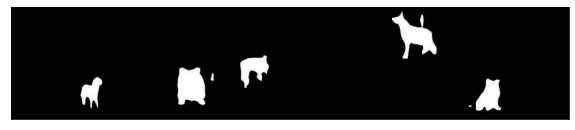

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


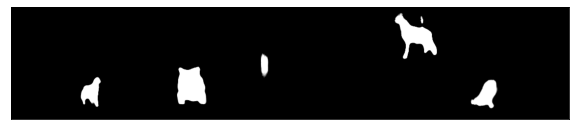



Test - Actual Depth


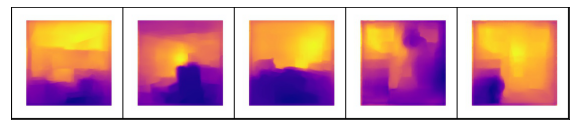

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


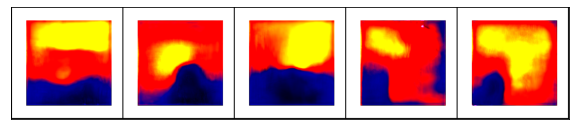

test: bce: 0.333919, dice: 0.375569, loss: 0.333919
test: bce: 0.334549, dice: 0.376462, loss: 0.334549
test: bce: 0.334360, dice: 0.374970, loss: 0.334360
************* 
Epoch: 96 	Training Loss: 0.334760 	Validation Loss: 0.334411

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.331979, dice: 0.357925, loss: 0.331979
train: bce: 0.332867, dice: 0.366908, loss: 0.332867
train: bce: 0.334108, dice: 0.378249, loss: 0.334108
train: bce: 0.334078, dice: 0.378648, loss: 0.334078
train: bce: 0.334188, dice: 0.377336, loss: 0.334188
train: bce: 0.334212, dice: 0.377556, loss: 0.334212
train: bce: 0.334144, dice: 0.377426, loss: 0.334144
train: bce: 0.334033, dice: 0.377264, loss: 0.334033
train: bce: 0.333923, dice: 0.376432, loss: 0.333923
test: bce: 0.322434, dice: 0.360704, loss: 0.322434
test: bce: 0.334234, dice: 0.378360, loss: 0.334234
test: bce: 0.333877, dice: 0.380365, loss: 0.333877
test: bce: 0.333675, dice: 0.377389, loss: 0.333675
************* 
Epoch: 97 	Training Loss: 0.33197

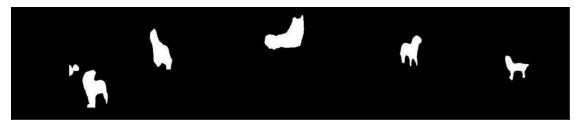

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


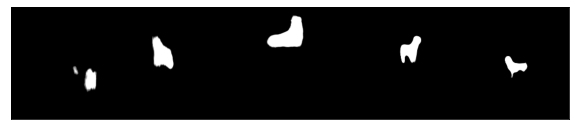



Train - Actual Depth


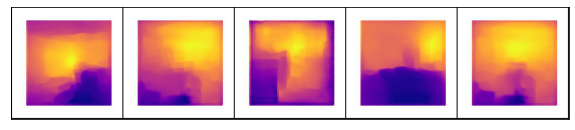

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


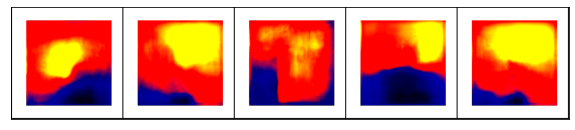

Best val loss: 0.332924
train: bce: 0.330048, dice: 0.362465, loss: 0.330048
train: bce: 0.330720, dice: 0.364088, loss: 0.330720
train: bce: 0.331211, dice: 0.364246, loss: 0.331211
train: bce: 0.331669, dice: 0.366014, loss: 0.331669
train: bce: 0.331716, dice: 0.366259, loss: 0.331716
train: bce: 0.331506, dice: 0.364738, loss: 0.331506
train: bce: 0.331237, dice: 0.363970, loss: 0.331237
train: bce: 0.331027, dice: 0.363376, loss: 0.331027
test: bce: 0.333282, dice: 0.375149, loss: 0.333282


Test - Actual mask: 100


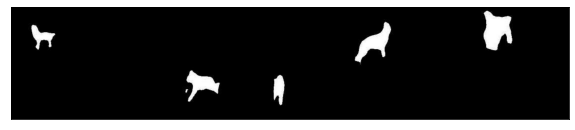

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


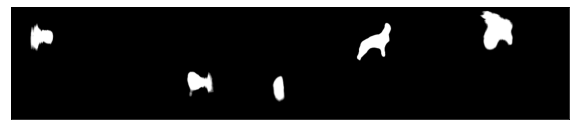



Test - Actual Depth


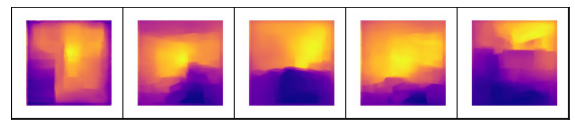

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


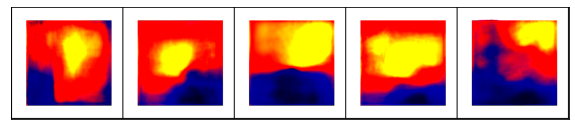

test: bce: 0.332731, dice: 0.364543, loss: 0.332731
test: bce: 0.332124, dice: 0.365362, loss: 0.332124
test: bce: 0.332213, dice: 0.364923, loss: 0.332213
************* 
Epoch: 100 	Training Loss: 0.326762 	Validation Loss: 0.332043

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.332776, dice: 0.385452, loss: 0.332776
train: bce: 0.332113, dice: 0.369912, loss: 0.332113
train: bce: 0.330921, dice: 0.364693, loss: 0.330921
train: bce: 0.331385, dice: 0.365266, loss: 0.331385
train: bce: 0.331497, dice: 0.365585, loss: 0.331497
train: bce: 0.331382, dice: 0.364725, loss: 0.331382
train: bce: 0.331415, dice: 0.365405, loss: 0.331415
train: bce: 0.331297, dice: 0.364629, loss: 0.331297
train: bce: 0.331028, dice: 0.364059, loss: 0.331028
test: bce: 0.319546, dice: 0.356484, loss: 0.319546
test: bce: 0.330413, dice: 0.359513, loss: 0.330413
test: bce: 0.332200, dice: 0.364427, loss: 0.332200
test: bce: 0.331638, dice: 0.364209, loss: 0.331638
************* 
Epoch: 101 	Training Loss: 0.32

In [32]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_16_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


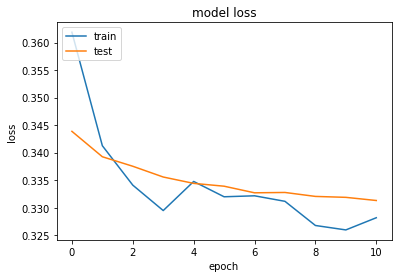

<Figure size 432x288 with 0 Axes>

time: 174 ms


In [33]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 17

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.675691, dice: 0.800080, loss: 0.675691


Train - Actual mask


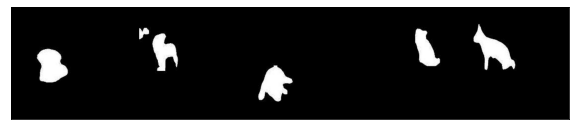

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


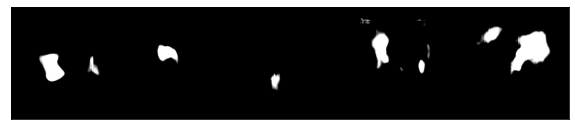



Train - Actual Depth


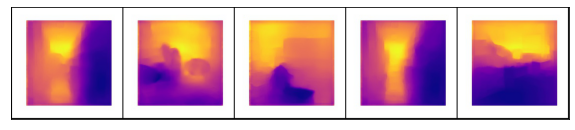

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


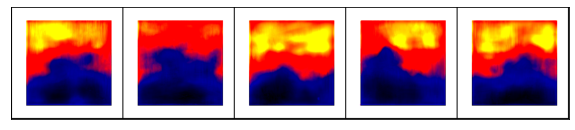

Best val loss: 0.675691
train: bce: 0.434247, dice: 0.730173, loss: 0.434247
train: bce: 0.401137, dice: 0.629654, loss: 0.401137
train: bce: 0.386571, dice: 0.579337, loss: 0.386571
train: bce: 0.378018, dice: 0.549130, loss: 0.378018
train: bce: 0.372279, dice: 0.530211, loss: 0.372279
train: bce: 0.368436, dice: 0.515235, loss: 0.368436
train: bce: 0.365235, dice: 0.503141, loss: 0.365235
train: bce: 0.362314, dice: 0.492922, loss: 0.362314
test: bce: 0.338406, dice: 0.401518, loss: 0.338406


Test - Actual mask: 92


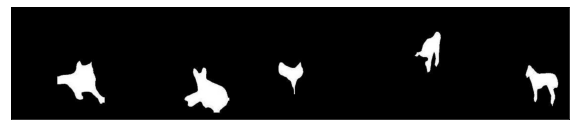

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


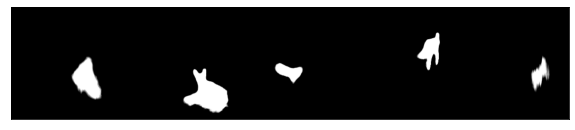



Test - Actual Depth


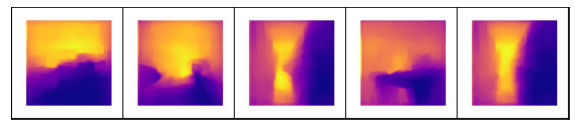

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


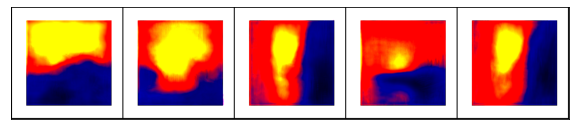

test: bce: 0.341765, dice: 0.419489, loss: 0.341765
test: bce: 0.342210, dice: 0.418709, loss: 0.342210
test: bce: 0.342233, dice: 0.418710, loss: 0.342233
************* 
Epoch: 92 	Training Loss: 0.360594 	Validation Loss: 0.342135

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.327281, dice: 0.375214, loss: 0.327281
train: bce: 0.340702, dice: 0.414518, loss: 0.340702
train: bce: 0.339902, dice: 0.410484, loss: 0.339902
train: bce: 0.340778, dice: 0.412132, loss: 0.340778
train: bce: 0.339399, dice: 0.406636, loss: 0.339399
train: bce: 0.339214, dice: 0.406038, loss: 0.339214
train: bce: 0.339072, dice: 0.406309, loss: 0.339072
train: bce: 0.339081, dice: 0.405684, loss: 0.339081
train: bce: 0.338661, dice: 0.404323, loss: 0.338661
test: bce: 0.339755, dice: 0.385200, loss: 0.339755
test: bce: 0.334546, dice: 0.387596, loss: 0.334546
test: bce: 0.334233, dice: 0.383765, loss: 0.334233
test: bce: 0.334684, dice: 0.386194, loss: 0.334684
************* 
Epoch: 93 	Training Loss: 0.32728

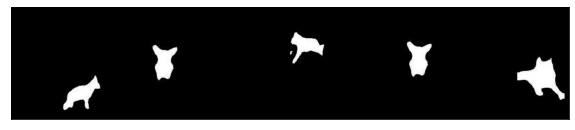

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


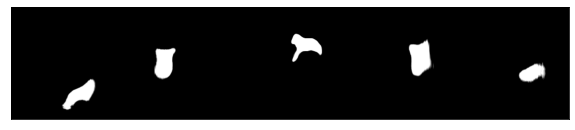



Train - Actual Depth


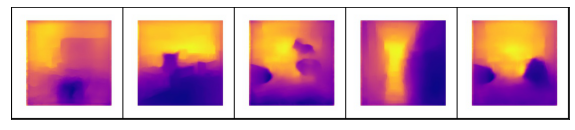

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


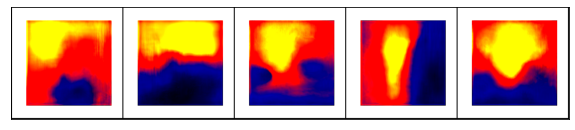

Best val loss: 0.334501
train: bce: 0.335561, dice: 0.390219, loss: 0.335561
train: bce: 0.333623, dice: 0.382287, loss: 0.333623
train: bce: 0.334077, dice: 0.382526, loss: 0.334077
train: bce: 0.333647, dice: 0.381361, loss: 0.333647
train: bce: 0.333241, dice: 0.380291, loss: 0.333241
train: bce: 0.333130, dice: 0.380821, loss: 0.333130
train: bce: 0.332974, dice: 0.380333, loss: 0.332974
train: bce: 0.332684, dice: 0.379111, loss: 0.332684
test: bce: 0.328718, dice: 0.352394, loss: 0.328718


Test - Actual mask: 96


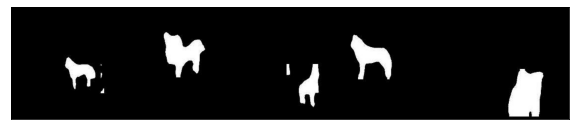

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


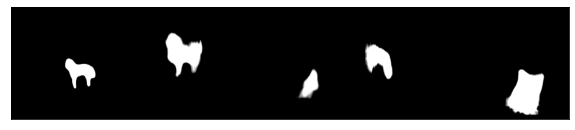



Test - Actual Depth


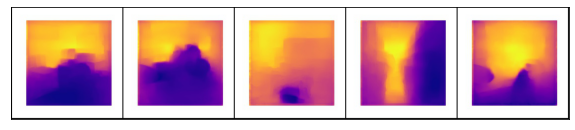

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


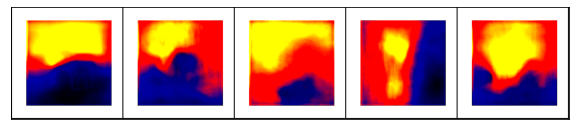

test: bce: 0.330631, dice: 0.375420, loss: 0.330631
test: bce: 0.331096, dice: 0.374882, loss: 0.331096
test: bce: 0.330649, dice: 0.374835, loss: 0.330649
************* 
Epoch: 96 	Training Loss: 0.332565 	Validation Loss: 0.330991

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.327015, dice: 0.393574, loss: 0.327015
train: bce: 0.330584, dice: 0.372853, loss: 0.330584
train: bce: 0.330934, dice: 0.370793, loss: 0.330934
train: bce: 0.330247, dice: 0.371034, loss: 0.330247
train: bce: 0.330530, dice: 0.370774, loss: 0.330530
train: bce: 0.330678, dice: 0.371587, loss: 0.330678
train: bce: 0.330813, dice: 0.371970, loss: 0.330813
train: bce: 0.330886, dice: 0.372981, loss: 0.330886
train: bce: 0.331061, dice: 0.373601, loss: 0.331061
test: bce: 0.314197, dice: 0.328730, loss: 0.314197
test: bce: 0.330920, dice: 0.371102, loss: 0.330920
test: bce: 0.330799, dice: 0.367537, loss: 0.330799
test: bce: 0.330256, dice: 0.368060, loss: 0.330256
************* 
Epoch: 97 	Training Loss: 0.32701

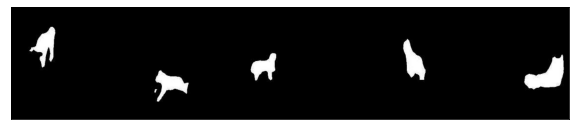

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


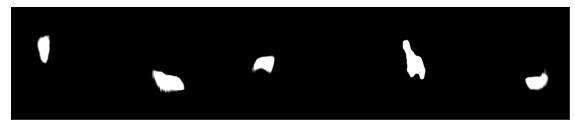



Train - Actual Depth


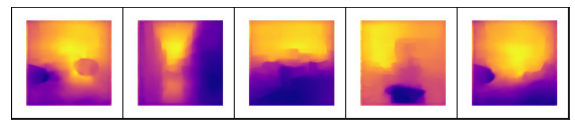

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


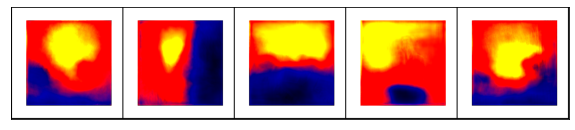

Best val loss: 0.342810
train: bce: 0.328960, dice: 0.366951, loss: 0.328960
train: bce: 0.328709, dice: 0.365317, loss: 0.328709
train: bce: 0.329477, dice: 0.365107, loss: 0.329477
train: bce: 0.329315, dice: 0.363710, loss: 0.329315
train: bce: 0.329536, dice: 0.364142, loss: 0.329536
train: bce: 0.329323, dice: 0.364440, loss: 0.329323
train: bce: 0.329296, dice: 0.365746, loss: 0.329296
train: bce: 0.329458, dice: 0.366220, loss: 0.329458
test: bce: 0.330456, dice: 0.367109, loss: 0.330456


Test - Actual mask: 100


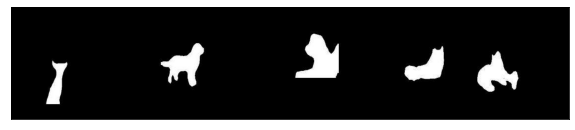

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


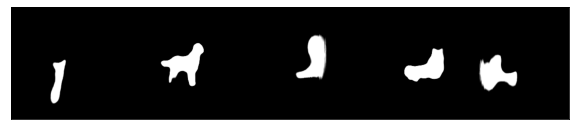



Test - Actual Depth


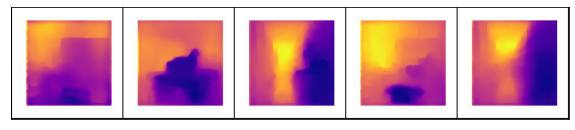



Test - Predicted Depth


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


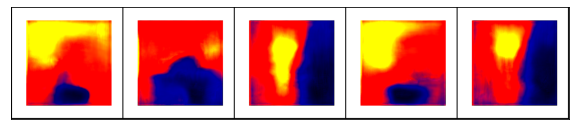

test: bce: 0.327019, dice: 0.356760, loss: 0.327019
test: bce: 0.328863, dice: 0.362381, loss: 0.328863
test: bce: 0.328898, dice: 0.361337, loss: 0.328898
************* 
Epoch: 100 	Training Loss: 0.327942 	Validation Loss: 0.328551

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.329973, dice: 0.352284, loss: 0.329973
train: bce: 0.328481, dice: 0.363730, loss: 0.328481
train: bce: 0.329269, dice: 0.364838, loss: 0.329269
train: bce: 0.327938, dice: 0.361250, loss: 0.327938
train: bce: 0.327841, dice: 0.360072, loss: 0.327841
train: bce: 0.328097, dice: 0.360795, loss: 0.328097
train: bce: 0.328527, dice: 0.361935, loss: 0.328527
train: bce: 0.328834, dice: 0.363235, loss: 0.328834
train: bce: 0.329062, dice: 0.364223, loss: 0.329062
test: bce: 0.360725, dice: 0.464878, loss: 0.360725
test: bce: 0.329696, dice: 0.358779, loss: 0.329696
test: bce: 0.328403, dice: 0.357078, loss: 0.328403
test: bce: 0.328835, dice: 0.361303, loss: 0.328835
************* 
Epoch: 101 	Training Loss: 0.32

In [17]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_17_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


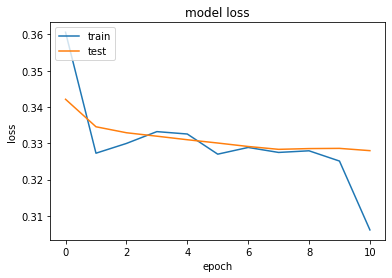

<Figure size 432x288 with 0 Axes>

time: 1.2 s


In [18]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 18

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.758327, dice: 0.893222, loss: 0.758327


Train - Actual mask


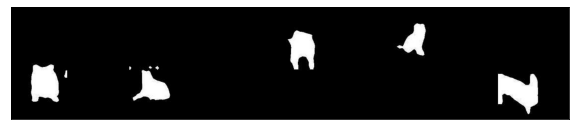

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


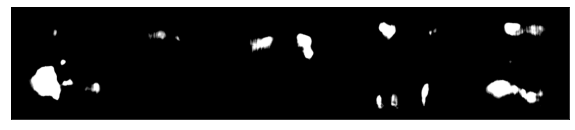



Train - Actual Depth


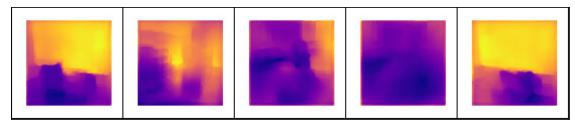

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


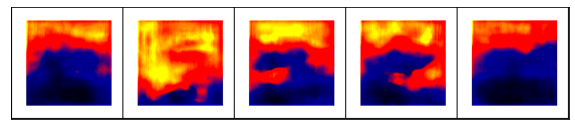

Best val loss: 0.758327
train: bce: 0.440646, dice: 0.731654, loss: 0.440646
train: bce: 0.409788, dice: 0.643879, loss: 0.409788
train: bce: 0.395065, dice: 0.598833, loss: 0.395065
train: bce: 0.386710, dice: 0.567286, loss: 0.386710
train: bce: 0.380662, dice: 0.545838, loss: 0.380662
train: bce: 0.376462, dice: 0.529123, loss: 0.376462
train: bce: 0.373330, dice: 0.517381, loss: 0.373330
train: bce: 0.370440, dice: 0.507136, loss: 0.370440
test: bce: 0.367326, dice: 0.428316, loss: 0.367326


Test - Actual mask: 92


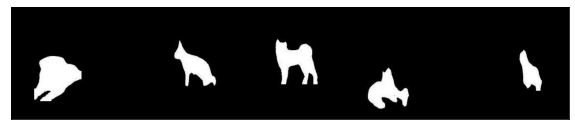

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


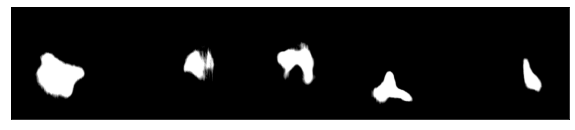



Test - Actual Depth


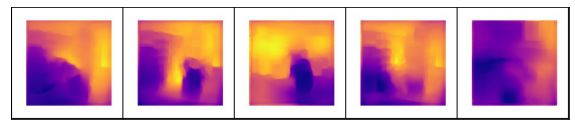

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


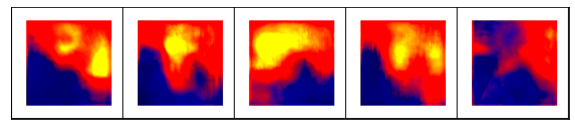

test: bce: 0.346871, dice: 0.419503, loss: 0.346871
test: bce: 0.346305, dice: 0.422667, loss: 0.346305
test: bce: 0.347269, dice: 0.426218, loss: 0.347269
************* 
Epoch: 92 	Training Loss: 0.368636 	Validation Loss: 0.347506

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.340473, dice: 0.411295, loss: 0.340473
train: bce: 0.348705, dice: 0.424779, loss: 0.348705
train: bce: 0.346683, dice: 0.419465, loss: 0.346683
train: bce: 0.346259, dice: 0.419345, loss: 0.346259
train: bce: 0.346127, dice: 0.418126, loss: 0.346127
train: bce: 0.346058, dice: 0.417621, loss: 0.346058
train: bce: 0.346102, dice: 0.416395, loss: 0.346102
train: bce: 0.345772, dice: 0.415365, loss: 0.345772
train: bce: 0.345642, dice: 0.415307, loss: 0.345642
test: bce: 0.341753, dice: 0.402444, loss: 0.341753
test: bce: 0.340973, dice: 0.400289, loss: 0.340973
test: bce: 0.341734, dice: 0.402131, loss: 0.341734
test: bce: 0.341907, dice: 0.402996, loss: 0.341907
************* 
Epoch: 93 	Training Loss: 0.34047

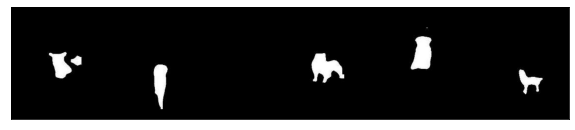

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


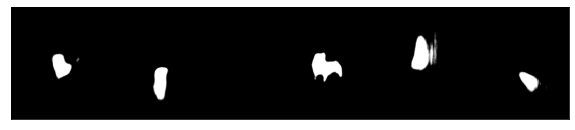



Train - Actual Depth


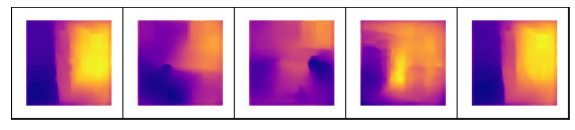

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


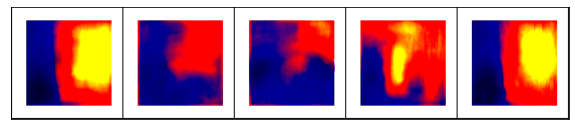

Best val loss: 0.329415
train: bce: 0.339722, dice: 0.391844, loss: 0.339722
train: bce: 0.338722, dice: 0.388887, loss: 0.338722
train: bce: 0.337347, dice: 0.385158, loss: 0.337347
train: bce: 0.336450, dice: 0.381838, loss: 0.336450
train: bce: 0.337003, dice: 0.383664, loss: 0.337003
train: bce: 0.337155, dice: 0.383650, loss: 0.337155
train: bce: 0.337638, dice: 0.383975, loss: 0.337638
train: bce: 0.337776, dice: 0.384117, loss: 0.337776
test: bce: 0.322493, dice: 0.335606, loss: 0.322493


Test - Actual mask: 96


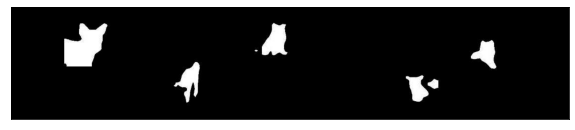

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


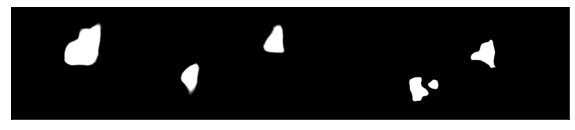



Test - Actual Depth


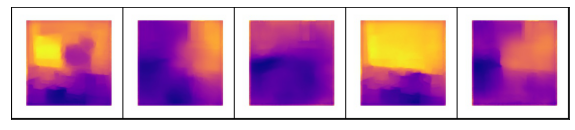

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


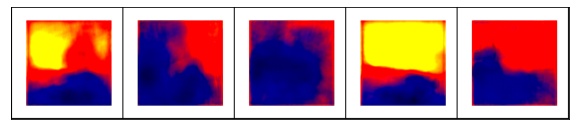

test: bce: 0.335510, dice: 0.373361, loss: 0.335510
test: bce: 0.336725, dice: 0.377194, loss: 0.336725
test: bce: 0.336700, dice: 0.376604, loss: 0.336700
************* 
Epoch: 96 	Training Loss: 0.329415 	Validation Loss: 0.336302

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.325637, dice: 0.373002, loss: 0.325637
train: bce: 0.336412, dice: 0.382952, loss: 0.336412
train: bce: 0.335966, dice: 0.381035, loss: 0.335966
train: bce: 0.336333, dice: 0.380044, loss: 0.336333
train: bce: 0.336446, dice: 0.379579, loss: 0.336446
train: bce: 0.336433, dice: 0.378508, loss: 0.336433
train: bce: 0.336500, dice: 0.378694, loss: 0.336500
train: bce: 0.336572, dice: 0.377829, loss: 0.336572
train: bce: 0.336334, dice: 0.377370, loss: 0.336334
test: bce: 0.322315, dice: 0.380194, loss: 0.322315
test: bce: 0.335167, dice: 0.380635, loss: 0.335167
test: bce: 0.335707, dice: 0.379335, loss: 0.335707
test: bce: 0.336018, dice: 0.378529, loss: 0.336018
************* 
Epoch: 97 	Training Loss: 0.32361

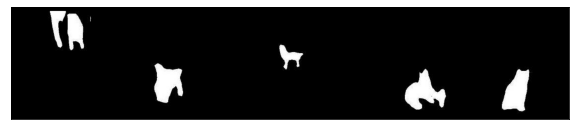

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


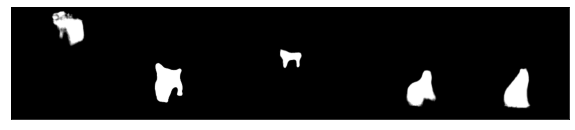



Train - Actual Depth


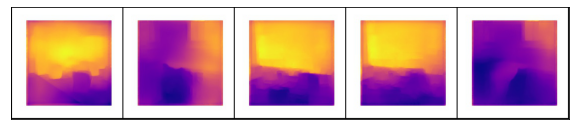

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


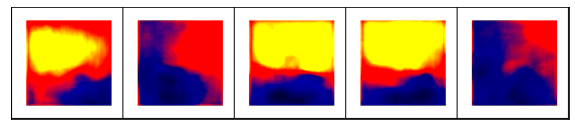

Best val loss: 0.337834
train: bce: 0.333946, dice: 0.370705, loss: 0.333946
train: bce: 0.334506, dice: 0.373983, loss: 0.334506
train: bce: 0.333921, dice: 0.370340, loss: 0.333921
train: bce: 0.334236, dice: 0.370363, loss: 0.334236
train: bce: 0.333933, dice: 0.370442, loss: 0.333933
train: bce: 0.333705, dice: 0.369628, loss: 0.333705
train: bce: 0.333800, dice: 0.369203, loss: 0.333800
train: bce: 0.334147, dice: 0.369953, loss: 0.334147
test: bce: 0.331514, dice: 0.335456, loss: 0.331514


Test - Actual mask: 100


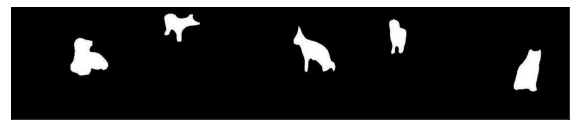

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


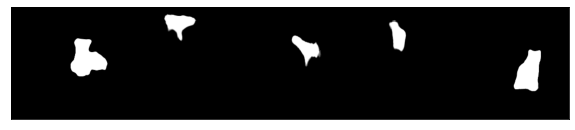



Test - Actual Depth


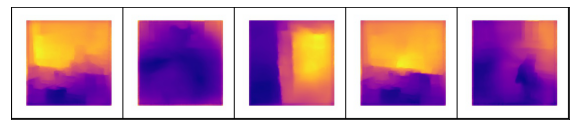

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


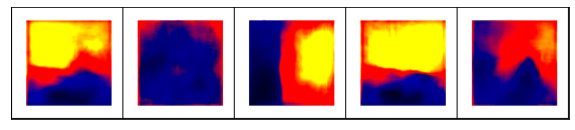

test: bce: 0.331240, dice: 0.360258, loss: 0.331240
test: bce: 0.332186, dice: 0.360849, loss: 0.332186
test: bce: 0.332475, dice: 0.364624, loss: 0.332475
************* 
Epoch: 100 	Training Loss: 0.332522 	Validation Loss: 0.332235

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.316726, dice: 0.359938, loss: 0.316726
train: bce: 0.333427, dice: 0.367100, loss: 0.333427
train: bce: 0.332746, dice: 0.365532, loss: 0.332746
train: bce: 0.332726, dice: 0.363421, loss: 0.332726
train: bce: 0.333472, dice: 0.367415, loss: 0.333472
train: bce: 0.333594, dice: 0.368027, loss: 0.333594
train: bce: 0.333310, dice: 0.367869, loss: 0.333310
train: bce: 0.333592, dice: 0.368717, loss: 0.333592
train: bce: 0.333604, dice: 0.369357, loss: 0.333604
test: bce: 0.325051, dice: 0.324473, loss: 0.325051
test: bce: 0.332791, dice: 0.367323, loss: 0.332791
test: bce: 0.332943, dice: 0.367039, loss: 0.332943
test: bce: 0.332447, dice: 0.367465, loss: 0.332447
************* 
Epoch: 101 	Training Loss: 0.31

In [19]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_18_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


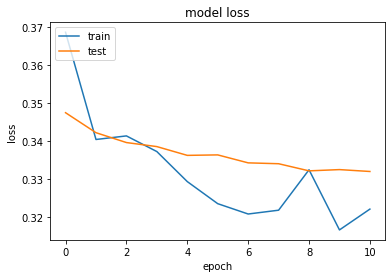

<Figure size 432x288 with 0 Axes>

time: 236 ms


In [20]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 19

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.704066, dice: 0.755258, loss: 0.704066


Train - Actual mask


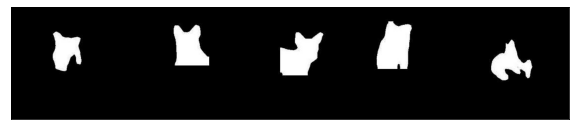

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


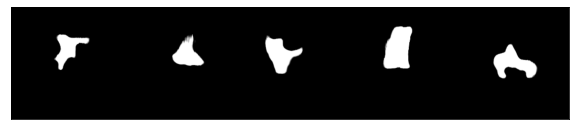



Train - Actual Depth


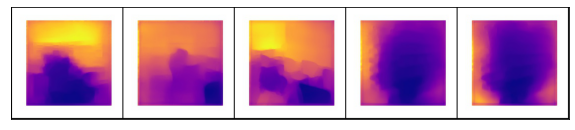

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


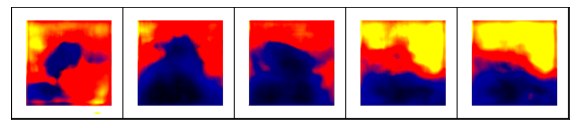

Best val loss: 0.704066
train: bce: 0.456438, dice: 0.727951, loss: 0.456438
train: bce: 0.430048, dice: 0.637657, loss: 0.430048
train: bce: 0.417101, dice: 0.592826, loss: 0.417101
train: bce: 0.409661, dice: 0.565236, loss: 0.409661
train: bce: 0.404579, dice: 0.544691, loss: 0.404579
train: bce: 0.400696, dice: 0.530538, loss: 0.400696
train: bce: 0.397902, dice: 0.519006, loss: 0.397902
train: bce: 0.395769, dice: 0.511238, loss: 0.395769
test: bce: 0.357465, dice: 0.397976, loss: 0.357465


Test - Actual mask: 92


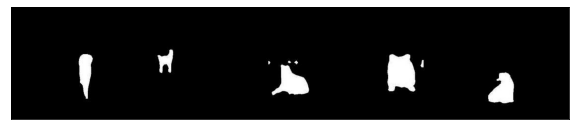

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


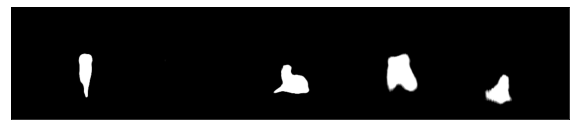



Test - Actual Depth


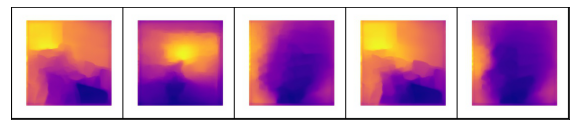

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


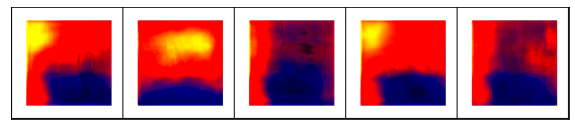

test: bce: 0.379773, dice: 0.446431, loss: 0.379773
test: bce: 0.379743, dice: 0.446055, loss: 0.379743
test: bce: 0.379826, dice: 0.449637, loss: 0.379826
************* 
Epoch: 92 	Training Loss: 0.393899 	Validation Loss: 0.380000

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.359293, dice: 0.393264, loss: 0.359293
train: bce: 0.375963, dice: 0.434651, loss: 0.375963
train: bce: 0.377183, dice: 0.436352, loss: 0.377183
train: bce: 0.377037, dice: 0.435683, loss: 0.377037
train: bce: 0.376263, dice: 0.434109, loss: 0.376263
train: bce: 0.376115, dice: 0.431620, loss: 0.376115
train: bce: 0.375491, dice: 0.429571, loss: 0.375491
train: bce: 0.375681, dice: 0.429445, loss: 0.375681
train: bce: 0.375335, dice: 0.427923, loss: 0.375335
test: bce: 0.392323, dice: 0.465737, loss: 0.392323
test: bce: 0.372301, dice: 0.419486, loss: 0.372301
test: bce: 0.373155, dice: 0.419827, loss: 0.373155
test: bce: 0.373487, dice: 0.421027, loss: 0.373487
************* 
Epoch: 93 	Training Loss: 0.35929

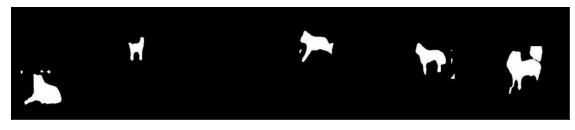

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


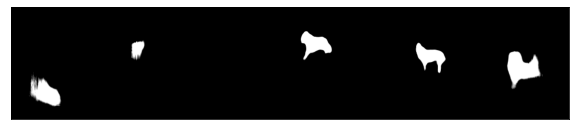



Train - Actual Depth


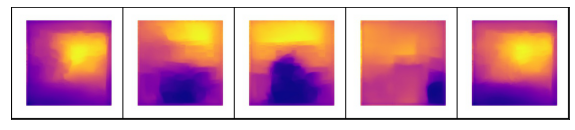

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


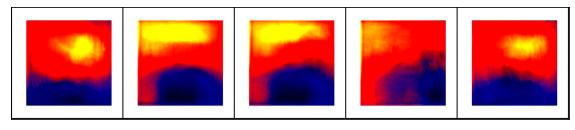

Best val loss: 0.359220
train: bce: 0.368306, dice: 0.399466, loss: 0.368306
train: bce: 0.367061, dice: 0.396155, loss: 0.367061
train: bce: 0.367716, dice: 0.395027, loss: 0.367716
train: bce: 0.368170, dice: 0.395655, loss: 0.368170
train: bce: 0.368647, dice: 0.396911, loss: 0.368647
train: bce: 0.368720, dice: 0.397763, loss: 0.368720
train: bce: 0.368692, dice: 0.398277, loss: 0.368692
train: bce: 0.368493, dice: 0.398087, loss: 0.368493
test: bce: 0.357893, dice: 0.372670, loss: 0.357893


Test - Actual mask: 96


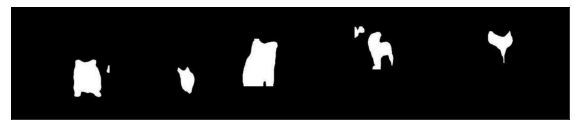

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


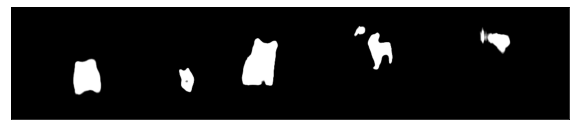



Test - Actual Depth


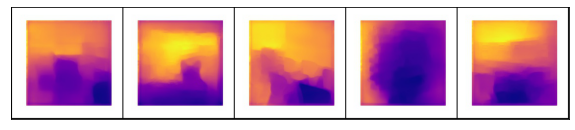

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


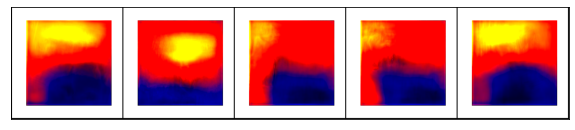

test: bce: 0.368645, dice: 0.401862, loss: 0.368645
test: bce: 0.368265, dice: 0.400858, loss: 0.368265
test: bce: 0.367782, dice: 0.399085, loss: 0.367782
************* 
Epoch: 96 	Training Loss: 0.359220 	Validation Loss: 0.368464

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.396655, dice: 0.447840, loss: 0.396655
train: bce: 0.368494, dice: 0.394141, loss: 0.368494
train: bce: 0.367303, dice: 0.394463, loss: 0.367303
train: bce: 0.367705, dice: 0.396189, loss: 0.367705
train: bce: 0.367469, dice: 0.394754, loss: 0.367469
train: bce: 0.367377, dice: 0.394497, loss: 0.367377
train: bce: 0.367853, dice: 0.395066, loss: 0.367853
train: bce: 0.367641, dice: 0.394639, loss: 0.367641
train: bce: 0.367815, dice: 0.395061, loss: 0.367815
test: bce: 0.371968, dice: 0.415872, loss: 0.371968
test: bce: 0.369858, dice: 0.400773, loss: 0.369858
test: bce: 0.368716, dice: 0.400396, loss: 0.368716
test: bce: 0.368246, dice: 0.398749, loss: 0.368246
************* 
Epoch: 97 	Training Loss: 0.36588

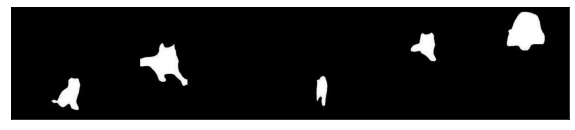

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


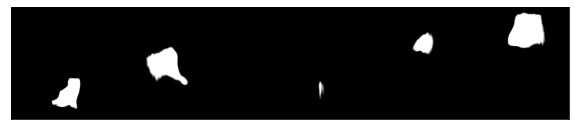



Train - Actual Depth


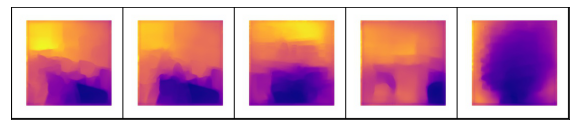



Train - Predicted Depth


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


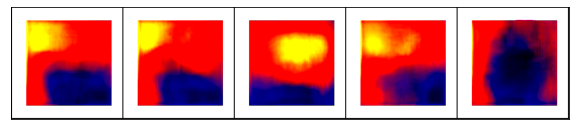

Best val loss: 0.350285
train: bce: 0.364992, dice: 0.382172, loss: 0.364992
train: bce: 0.365081, dice: 0.383696, loss: 0.365081
train: bce: 0.364967, dice: 0.384694, loss: 0.364967
train: bce: 0.365346, dice: 0.385161, loss: 0.365346
train: bce: 0.365457, dice: 0.385283, loss: 0.365457
train: bce: 0.365298, dice: 0.384845, loss: 0.365298
train: bce: 0.364891, dice: 0.384759, loss: 0.364891
train: bce: 0.364810, dice: 0.384940, loss: 0.364810
test: bce: 0.367648, dice: 0.372929, loss: 0.367648


Test - Actual mask: 100


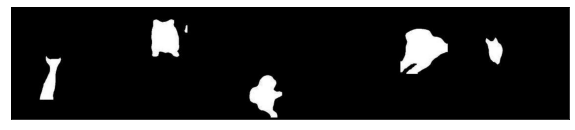

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


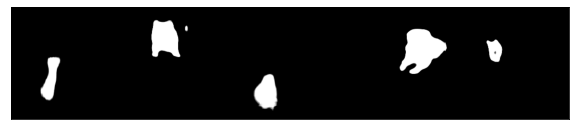



Test - Actual Depth


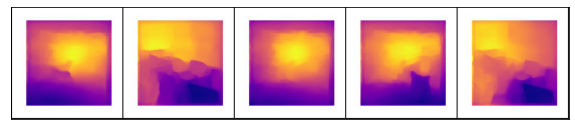

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


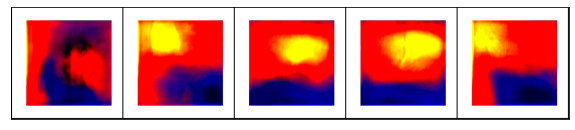

test: bce: 0.365469, dice: 0.383623, loss: 0.365469
test: bce: 0.365408, dice: 0.380662, loss: 0.365408
test: bce: 0.365007, dice: 0.381077, loss: 0.365007
************* 
Epoch: 100 	Training Loss: 0.349380 	Validation Loss: 0.365519

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.352146, dice: 0.339609, loss: 0.352146
train: bce: 0.363244, dice: 0.373243, loss: 0.363244
train: bce: 0.362750, dice: 0.378093, loss: 0.362750
train: bce: 0.362343, dice: 0.378718, loss: 0.362343
train: bce: 0.363412, dice: 0.382878, loss: 0.363412
train: bce: 0.363387, dice: 0.383266, loss: 0.363387
train: bce: 0.363722, dice: 0.382465, loss: 0.363722
train: bce: 0.363682, dice: 0.382476, loss: 0.363682
train: bce: 0.363856, dice: 0.383502, loss: 0.363856
test: bce: 0.367852, dice: 0.401357, loss: 0.367852
test: bce: 0.363010, dice: 0.387657, loss: 0.363010
test: bce: 0.365063, dice: 0.387097, loss: 0.365063
test: bce: 0.365914, dice: 0.388564, loss: 0.365914
************* 
Epoch: 101 	Training Loss: 0.35

In [21]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_19_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


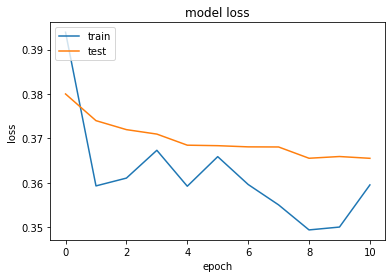

<Figure size 432x288 with 0 Axes>

time: 222 ms


In [22]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

#### Training - 20

30001
Last Epoch : 92, with loss: 0.3098959266046683
>>>>>>>> 
Epoch 92/101, LR: 0.01


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2796: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2973: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


train: bce: 0.648491, dice: 0.800235, loss: 0.648491


Train - Actual mask


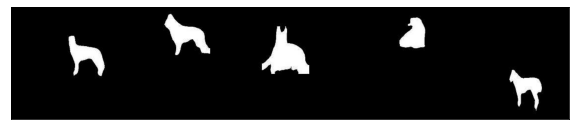

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


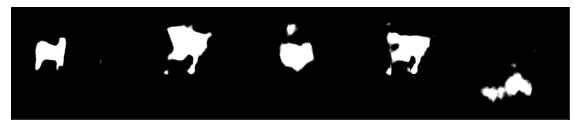



Train - Actual Depth


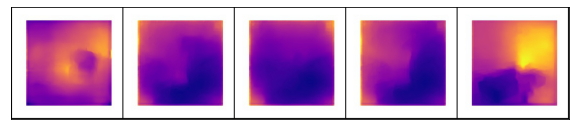

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


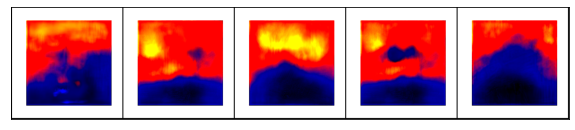

Best val loss: 0.648491
train: bce: 0.445218, dice: 0.765638, loss: 0.445218
train: bce: 0.415053, dice: 0.667546, loss: 0.415053
train: bce: 0.399511, dice: 0.612190, loss: 0.399511
train: bce: 0.391611, dice: 0.584261, loss: 0.391611
train: bce: 0.386025, dice: 0.562292, loss: 0.386025
train: bce: 0.382292, dice: 0.546446, loss: 0.382292
train: bce: 0.378559, dice: 0.532564, loss: 0.378559
train: bce: 0.375504, dice: 0.520647, loss: 0.375504
test: bce: 0.348011, dice: 0.413462, loss: 0.348011


Test - Actual mask: 92


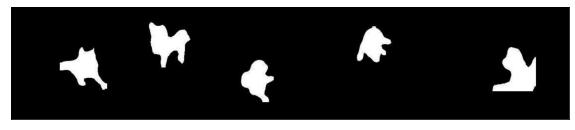

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


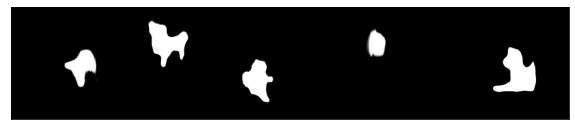



Test - Actual Depth


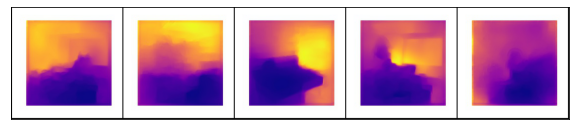

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


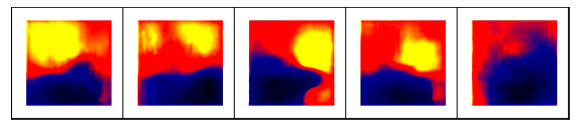

test: bce: 0.350089, dice: 0.419261, loss: 0.350089
test: bce: 0.350861, dice: 0.422093, loss: 0.350861
test: bce: 0.351699, dice: 0.424555, loss: 0.351699
************* 
Epoch: 92 	Training Loss: 0.373494 	Validation Loss: 0.352186

>>>>>>>> 
Epoch 93/101, LR: 0.01
train: bce: 0.344187, dice: 0.396527, loss: 0.344187
train: bce: 0.351533, dice: 0.432761, loss: 0.351533
train: bce: 0.351865, dice: 0.435465, loss: 0.351865
train: bce: 0.351829, dice: 0.432712, loss: 0.351829
train: bce: 0.350833, dice: 0.428226, loss: 0.350833
train: bce: 0.350384, dice: 0.425054, loss: 0.350384
train: bce: 0.350297, dice: 0.423218, loss: 0.350297
train: bce: 0.349943, dice: 0.420797, loss: 0.349943
train: bce: 0.349686, dice: 0.420379, loss: 0.349686
test: bce: 0.352009, dice: 0.410257, loss: 0.352009
test: bce: 0.348815, dice: 0.399797, loss: 0.348815
test: bce: 0.349223, dice: 0.403695, loss: 0.349223
test: bce: 0.348061, dice: 0.401374, loss: 0.348061
************* 
Epoch: 93 	Training Loss: 0.34418

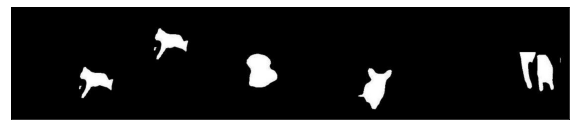

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


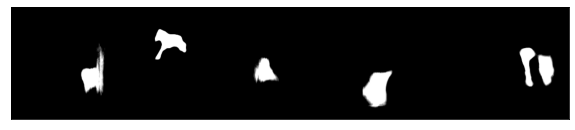



Train - Actual Depth


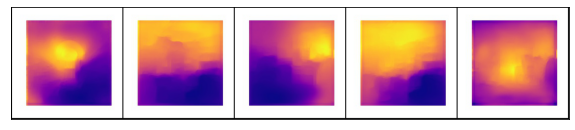

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


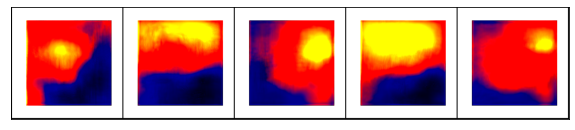

Best val loss: 0.339782
train: bce: 0.341231, dice: 0.391752, loss: 0.341231
train: bce: 0.340780, dice: 0.390780, loss: 0.340780
train: bce: 0.341334, dice: 0.388924, loss: 0.341334
train: bce: 0.342053, dice: 0.389135, loss: 0.342053
train: bce: 0.342212, dice: 0.389844, loss: 0.342212
train: bce: 0.342203, dice: 0.389299, loss: 0.342203
train: bce: 0.341992, dice: 0.388454, loss: 0.341992
train: bce: 0.342093, dice: 0.389255, loss: 0.342093
test: bce: 0.347649, dice: 0.345775, loss: 0.347649


Test - Actual mask: 96


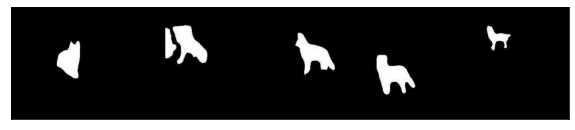

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


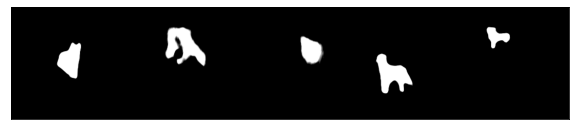



Test - Actual Depth


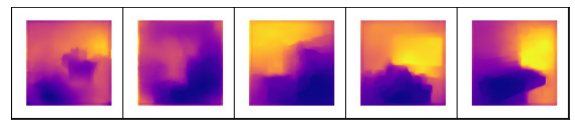



Test - Predicted Depth


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


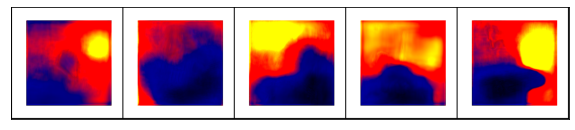

test: bce: 0.339707, dice: 0.379196, loss: 0.339707
test: bce: 0.341018, dice: 0.386825, loss: 0.341018
test: bce: 0.341373, dice: 0.385856, loss: 0.341373
************* 
Epoch: 96 	Training Loss: 0.335006 	Validation Loss: 0.340835

>>>>>>>> 
Epoch 97/101, LR: 0.01
train: bce: 0.326195, dice: 0.391861, loss: 0.326195
train: bce: 0.340293, dice: 0.382580, loss: 0.340293
train: bce: 0.341090, dice: 0.383824, loss: 0.341090
train: bce: 0.341312, dice: 0.385238, loss: 0.341312
train: bce: 0.341396, dice: 0.385152, loss: 0.341396
train: bce: 0.341181, dice: 0.385110, loss: 0.341181
train: bce: 0.341071, dice: 0.384795, loss: 0.341071
train: bce: 0.340974, dice: 0.385328, loss: 0.340974
train: bce: 0.340901, dice: 0.385092, loss: 0.340901
test: bce: 0.333228, dice: 0.361104, loss: 0.333228
test: bce: 0.339850, dice: 0.378834, loss: 0.339850
test: bce: 0.339990, dice: 0.380251, loss: 0.339990
test: bce: 0.340439, dice: 0.380097, loss: 0.340439
************* 
Epoch: 97 	Training Loss: 0.32559

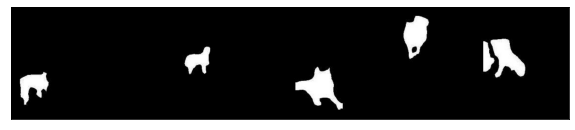

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted mask


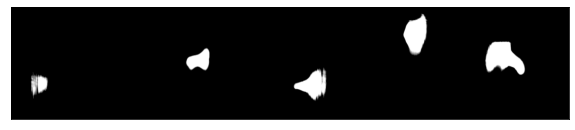



Train - Actual Depth


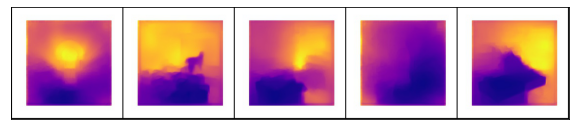

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Train - Predicted Depth


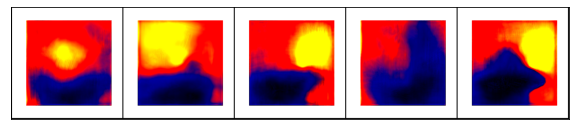

Best val loss: 0.352127
train: bce: 0.339215, dice: 0.380166, loss: 0.339215
train: bce: 0.338116, dice: 0.375944, loss: 0.338116
train: bce: 0.337555, dice: 0.372546, loss: 0.337555
train: bce: 0.337279, dice: 0.371182, loss: 0.337279
train: bce: 0.337717, dice: 0.373527, loss: 0.337717
train: bce: 0.338303, dice: 0.375577, loss: 0.338303
train: bce: 0.338499, dice: 0.376964, loss: 0.338499
train: bce: 0.338705, dice: 0.377055, loss: 0.338705
test: bce: 0.337750, dice: 0.372384, loss: 0.337750


Test - Actual mask: 100


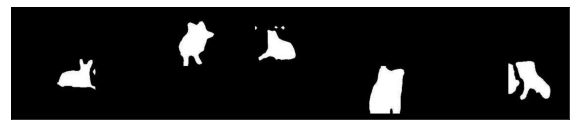

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted mask


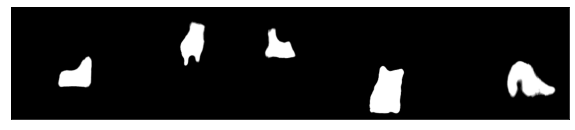



Test - Actual Depth


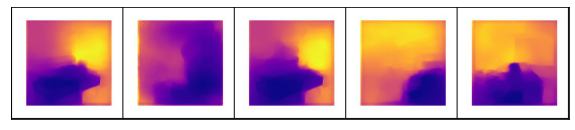

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Test - Predicted Depth


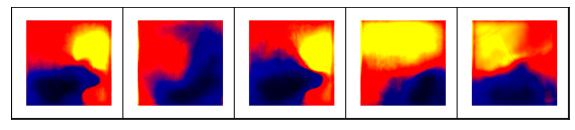

test: bce: 0.338074, dice: 0.371182, loss: 0.338074
test: bce: 0.339222, dice: 0.373933, loss: 0.339222
test: bce: 0.339309, dice: 0.372447, loss: 0.339309
************* 
Epoch: 100 	Training Loss: 0.336908 	Validation Loss: 0.338892

>>>>>>>> 
Epoch 101/101, LR: 0.01
train: bce: 0.347158, dice: 0.381459, loss: 0.347158
train: bce: 0.337996, dice: 0.374860, loss: 0.337996
train: bce: 0.338151, dice: 0.372553, loss: 0.338151
train: bce: 0.337575, dice: 0.370698, loss: 0.337575
train: bce: 0.337601, dice: 0.370867, loss: 0.337601
train: bce: 0.337870, dice: 0.371670, loss: 0.337870
train: bce: 0.337666, dice: 0.371224, loss: 0.337666
train: bce: 0.337561, dice: 0.371416, loss: 0.337561
train: bce: 0.337654, dice: 0.371156, loss: 0.337654
test: bce: 0.340781, dice: 0.376460, loss: 0.340781
test: bce: 0.336380, dice: 0.372258, loss: 0.336380
test: bce: 0.337684, dice: 0.372557, loss: 0.337684
test: bce: 0.337996, dice: 0.374386, loss: 0.337996
************* 
Epoch: 101 	Training Loss: 0.33

In [16]:
# Load and re-train model

batchzipfilepath = ZIP_FILES_PATH + BATCH_20_ZIP
trainloader, testloader = loaddataset(batchzipfilepath, transformtrain, batch_size=BATCH_SIZE)

model, optimizer, last_epoch, test_loss_min = loadcheckpoint(BEST_MODEL_PATH, model, optimizer)
print('Last Epoch : {}, with loss: {}'.format(last_epoch, test_loss_min))

model, train_loss, test_loss = train_test_model(last_epoch, 10, test_loss_min, model, criterion, device, trainloader, testloader, optimizer, save_path=MODEL_SAVE_PATH)

11
11


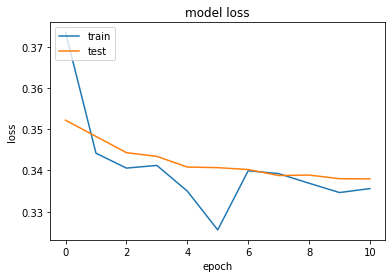

<Figure size 432x288 with 0 Axes>

time: 1.31 s


In [17]:
plotmetrics(train_loss, test_loss, METRICS_PATH)

## Analysis

#### Summary

| S.No | #images/GT | #Channels               | Model                                                        | #Params | Loss Fn           | Optimizer | #Epochs | Observed loss | Output       | Remarks                                |
| ---- | ---------- | ----------------------- | ------------------------------------------------------------ | ------- | ----------------- | --------- | ------- | ------------- | ------------ | -------------------------------------- |
| 1    | 500        | in - 3, mask-1, depth-3 | [UNet based- korea](https://raw.githubusercontent.com/ugent-korea/pytorch-unet-segmentation/master/src/simple_model.py) | 14,348,004      | BCEWithLogitsLoss | SGD       | 100     | 0.72          | mask + depth | Both predicted. Mask predicted at E-70 |
|      |            |                         |                                                              |         |                   |           |         |               |              |                                        |
|      |            |                         |                                                              |         |                   |           |         |               |              |                                        |
|      |            |                         |                                                              |         |                   |           |         |               |              |                                        |
|      |            |                         |                                                              |         |                   |           |         |               |              |                                        |
|      |            |                         |                                                              |         |                   |           |         |               |              |                                        |
|      |            |                         |                                                              |         |                   |           |         |               |              |                                        |
|      |            |                         |                                                              |         |                   |           |         |               |              |                                        |
|      |            |                         |                                                              |         |                   |           |         |               |              |                                        |


#### Optimizations
- Dataset loading
  - Initially trained model on 500 images of bg_fg, masks and depths each. It gave results for mask at 70 epoch and depth from beginning.
  - Increased to 10k images each and dataset loading part failed
    - Iterating though all images in a directory
    - SOLUTION: created label.txt to contain name of files and generated dataset through these names.
    - Training is very slow.
    